# Define Input Folder and Files

In [1]:
import os

# Define the folder path
input_folder = "Input_Folder_without_Nan"

# Get the list of CSV file names in the folder
input_files = [file for file in os.listdir(input_folder) if file.endswith('.csv')]

# Print the results
print("Input Folder:", input_folder)
print(f"Input Files: {len(input_files)}")
print(input_files)


Input Folder: Input_Folder_without_Nan
Input Files: 41
['UP002.csv', 'UP003.csv', 'UP004.csv', 'UP008.csv', 'UP009.csv', 'UP012.csv', 'UP014.csv', 'UP016.csv', 'UP017.csv', 'UP018.csv', 'UP019.csv', 'UP020.csv', 'UP021.csv', 'UP022.csv', 'UP023.csv', 'UP024.csv', 'UP025.csv', 'UP026.csv', 'UP028.csv', 'UP029.csv', 'UP030.csv', 'UP031.csv', 'UP032.csv', 'UP033.csv', 'UP034.csv', 'UP035.csv', 'UP036.csv', 'UP037.csv', 'UP038.csv', 'UP039.csv', 'UP040.csv', 'UP041.csv', 'UP042.csv', 'UP043.csv', 'UP044.csv', 'UP046.csv', 'UP048.csv', 'UP049.csv', 'UP050.csv', 'UP051.csv', 'UP052.csv']


In [2]:
import pandas as pd

dataframes_dictionary = {}  # Dictionary to store DataFrames
print(input_folder)
for file in input_files:
    file_path = os.path.join(input_folder, file)
    if os.path.exists(file_path):
        # Load the CSV file
        df = pd.read_csv(file_path)
        dataframes_dictionary[file] = df


Input_Folder_without_Nan


# Add Additional columns to the dataframes

In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn.functional as F
from torch_geometric.nn import GATConv
from torch_geometric.data import Data

from sklearn.preprocessing import LabelEncoder

# Initialize a label encoder
label_encoder = LabelEncoder()

# Load and process the data
dataframes = []
for file_name in input_files:
    df = dataframes_dictionary[file_name]
    
    # Convert 'From Date' to pandas datetime
    df['From Date'] = pd.to_datetime(df['From Date'])
    
    # Split 'From Date' into Year, Month, Day, Hour
    df['Year'] = df['From Date'].dt.year
    df['Month'] = df['From Date'].dt.month
    df['Day'] = df['From Date'].dt.day
    df['Hour'] = df['From Date'].dt.hour
    
    # Drop the original 'From Date' column
    df.drop('From Date', axis=1, inplace=True)
    
    dataframes.append(df)


# Split the data into training and test sets

In [4]:
train_dataframes = []
test_dataframes = []

split_ratio = 0.85  # 85% train, 15% test
train_size = int(len(dataframes[0]) * split_ratio)

for node_idx, df in enumerate(dataframes):
    # Split the dataframe into train and test sets

    train_df = df.iloc[:train_size]
    test_df = df.iloc[train_size:]
    
    # Append the train and test dataframes to the respective lists
    train_dataframes.append(train_df)
    test_dataframes.append(test_df)

print(f"Train dataframes shape: {train_dataframes[0].shape}")
print(f"Test dataframes shape: {test_dataframes[0].shape}")    

Train dataframes shape: (8343, 15)
Test dataframes shape: (1473, 15)


# Scale the Data

In [7]:
from sklearn.preprocessing import StandardScaler

scalers = {}

feature_scalers = {}

print(train_dataframes[0].dtypes)

# Apply StandardScaler to all numeric columns except 'Year', 'Month', 'Day', 'Hour'
for node_idx, df in enumerate(train_dataframes):

    print(f"Training Processing {input_files[node_idx]}, node index: {node_idx}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = StandardScaler()
    df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
    feature_scalers[input_files[node_idx]] = scaler

    scaler1 = StandardScaler()
    df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
    
    # Save the scaler for the target column
    scalers[input_files[node_idx]] = scaler1


print(test_dataframes[0].dtypes)    

# Apply the same scaling to the test dataframes
for node_idx, df in enumerate(test_dataframes):

    print(f"Testing Processing {input_files[node_idx]}, node index: {node_idx}, shape: {df.shape}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = feature_scalers[input_files[node_idx]]
    df[columns_to_scale] = scaler.transform(df[columns_to_scale])
    
    scaler1 = scalers[input_files[node_idx]]
    df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
 

PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Training Processing UP002.csv, node index: 0
Training Processing UP003.csv, node index: 1
Training Processing UP004.csv, node index: 2
Training Processing UP008.csv, node index: 3
Training Processing UP009.csv, node index: 4
Training Processing UP012.csv, node index: 5
Training Processing UP014.csv, node index: 6
Training Processing UP016.csv, node index: 7
Training Processing UP017.csv, node index: 8


C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

Training Processing UP018.csv, node index: 9
Training Processing UP019.csv, node index: 10
Training Processing UP020.csv, node index: 11
Training Processing UP021.csv, node index: 12
Training Processing UP022.csv, node index: 13
Training Processing UP023.csv, node index: 14


C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

Training Processing UP024.csv, node index: 15
Training Processing UP025.csv, node index: 16
Training Processing UP026.csv, node index: 17
Training Processing UP028.csv, node index: 18
Training Processing UP029.csv, node index: 19
Training Processing UP030.csv, node index: 20
Training Processing UP031.csv, node index: 21
Training Processing UP032.csv, node index: 22
Training Processing UP033.csv, node index: 23
Training Processing UP034.csv, node index: 24
Training Processing UP035.csv, node index: 25
Training Processing UP036.csv, node index: 26
Training Processing UP037.csv, node index: 27


C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

Training Processing UP038.csv, node index: 28
Training Processing UP039.csv, node index: 29
Training Processing UP040.csv, node index: 30
Training Processing UP041.csv, node index: 31
Training Processing UP042.csv, node index: 32
Training Processing UP043.csv, node index: 33
Training Processing UP044.csv, node index: 34
Training Processing UP046.csv, node index: 35
Training Processing UP048.csv, node index: 36
Training Processing UP049.csv, node index: 37


C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

Training Processing UP050.csv, node index: 38
Training Processing UP051.csv, node index: 39
Training Processing UP052.csv, node index: 40
PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Testing Processing UP002.csv, node index: 0, shape: (1473, 15)
Testing Processing UP003.csv, node index: 1, shape: (1473, 15)
Testing Processing UP004.csv, node index: 2, shape: (1473, 15)
Testing Processing UP008.csv, node index: 3, shape: (1473, 15)
Testing Processing UP009.csv, node index: 4, shape: (1473, 15)
Testing Processing UP012.csv, node index: 5, shape: (1473, 15)
Testing Processing UP014.csv, node index: 6, shape: (1473, 15)
Testing Processing UP016.csv, no

C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

Testing Processing UP020.csv, node index: 11, shape: (1473, 15)
Testing Processing UP021.csv, node index: 12, shape: (1473, 15)
Testing Processing UP022.csv, node index: 13, shape: (1473, 15)
Testing Processing UP023.csv, node index: 14, shape: (1473, 15)
Testing Processing UP024.csv, node index: 15, shape: (1473, 15)
Testing Processing UP025.csv, node index: 16, shape: (1473, 15)
Testing Processing UP026.csv, node index: 17, shape: (1473, 15)
Testing Processing UP028.csv, node index: 18, shape: (1473, 15)
Testing Processing UP029.csv, node index: 19, shape: (1473, 15)
Testing Processing UP030.csv, node index: 20, shape: (1473, 15)
Testing Processing UP031.csv, node index: 21, shape: (1473, 15)
Testing Processing UP032.csv, node index: 22, shape: (1473, 15)
Testing Processing UP033.csv, node index: 23, shape: (1473, 15)
Testing Processing UP034.csv, node index: 24, shape: (1473, 15)
Testing Processing UP035.csv, node index: 25, shape: (1473, 15)
Testing Processing UP036.csv, node index

C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .l

# Modifying the csv to add latitude and longitude

In [8]:
import pandas as pd

# Load the CSV file
file_path = 'final.csv'  # Replace with your file path
df = pd.read_csv(file_path, header=None)

# Define the new column names
new_columns = ['file_name', 'state', 'city', 'agency', 'station_location', 
               'start_month', 'start_month_num', 'start_year', 'latitude', 'longitude']

# Assign the new column names to the dataframe
df.columns = new_columns

# Save the modified dataframe back to CSV
modified_file_path = 'final_modified.csv'  # Specify the output file path
df.to_csv(modified_file_path, index=False)

print(f"Modified file saved as {modified_file_path}")

Modified file saved as final_modified.csv


# Checking if all files have latitudes and longitudes

In [9]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('final_modified.csv')

# Remove ".csv" extension from the files_with_at_column
files_without_extension = [file.replace('.csv', '') for file in input_files]

# Filter rows from the dataframe where the file_name is in the files_without_extension array
filtered_df = df[df['file_name'].isin(files_without_extension)]

# Extract latitude and longitude of the filtered rows
filtered_lat_long_positions = filtered_df[['latitude', 'longitude']].values.tolist()

# Find file names that do not have latitude and longitude information
missing_files = [file for file in files_without_extension if file not in filtered_df['file_name'].values]

# Print the results
print("Filtered latitude and longitude positions:", filtered_lat_long_positions)
print("Files without latitude and longitude information:", missing_files)


Filtered latitude and longitude positions: [[26.828687, 80.968257], [25.347671, 82.98085], [27.198724, 78.006069], [28.543866, 77.331016], [28.662102, 77.373283], [28.478246, 77.481831], [29.467858, 77.711593], [28.722131, 77.753682], [28.694105, 77.4549], [28.645805, 77.369211], [28.73341, 77.298604], [28.553622, 77.47128], [28.58997, 77.311681], [28.569039, 77.397499], [28.957922, 77.759078], [26.849806, 81.007399], [29.002044, 77.760152], [29.06265, 77.71476], [27.204282, 77.925518], [25.301191, 82.996499], [27.194169, 77.965192], [25.262166, 82.995247], [26.731409, 83.433118], [25.493404, 81.862706], [27.233706, 78.026988], [26.763279, 80.927821], [25.428788, 81.91389], [27.166823, 78.376626], [25.449042, 81.827394], [26.90648, 80.983889], [26.506816, 80.251968], [25.325445, 82.995173], [27.104555, 78.003352], [27.57421, 77.654082], [26.426674, 80.325968], [28.885193, 78.738921], [28.854246, 78.772174], [28.841239, 78.696695], [28.964466, 77.27869], [27.16446, 78.391286], [25.45357

# Calculating distances between the points

In [10]:
import math

# Function to calculate the Haversine distance between two points on the Earth
def haversine(lat1, lon1, lat2, lon2):
    # Radius of the Earth in kilometers
    R = 6371.0
    
    # Convert latitude and longitude from degrees to radians
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)
    
    # Differences in coordinates
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad
    
    # Haversine formula
    a = math.sin(dlat / 2)**2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    
    # Distance in kilometers
    distance = R * c
    return distance

# Initialize a 2D array to store the distances
num_stations = len(filtered_lat_long_positions)
distance_matrix = [[0] * num_stations for _ in range(num_stations)]

# Iterate over the array to calculate distances between each pair of stations
for i in range(num_stations):
    for j in range(num_stations):
        lat1, lon1 = filtered_lat_long_positions[i]
        lat2, lon2 = filtered_lat_long_positions[j]
        
        # Check if any latitude or longitude is None
        if None in (lat1, lon1, lat2, lon2):
            distance_matrix[i][j] = -1
        else:
            # Calculate the distance using the Haversine formula
            distance_matrix[i][j] = haversine(lat1, lon1, lat2, lon2)

# Output the 2D distance array
for row in distance_matrix:
    print(row)

# Get the number of rows (length of the outer list)
rows = len(distance_matrix)

# Get the number of columns (length of the first inner list, assuming all rows have the same number of columns)
columns = len(distance_matrix[0]) if rows > 0 else 0

# Print the shape
print(f"Shape: ({rows}, {columns})")


[0.0, 259.831294268261, 296.3073062470489, 405.71967084165664, 408.2831201387903, 389.2780421976758, 433.6248093898384, 379.9022461663081, 403.1202784144766, 407.75269006951396, 418.5168023768209, 394.0985785077845, 409.75765217382735, 401.26086412872326, 394.3312597566813, 4.538336824596205, 397.16042095417515, 404.7358890189317, 304.28787362360157, 264.3631791522258, 300.25474049648807, 267.10222540161783, 244.91806957183363, 173.24469530741052, 294.77943248602156, 8.30691912317224, 182.0490886691721, 259.5051000084394, 175.75234561274783, 8.788059469298602, 79.66689357184394, 262.5205143903347, 295.4259311719268, 338.07059597527996, 77.93792481191839, 316.7232944225239, 311.9990131479505, 316.1633594061282, 433.3949665835895, 258.0326294852914, 281.95404023105255]
[259.831294268261, 0.0, 536.971001381933, 663.1333206367073, 666.5260268959933, 646.748508222628, 692.9632693541472, 639.2595346251944, 661.7347052324445, 665.8970511529196, 676.9228193417765, 652.0154437921375, 667.406227

# Plotting the points on the map

In [11]:
import folium

avg_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
avg_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
my_map = folium.Map(location=[avg_lat, avg_long], zoom_start=5)
    
# Add markers for each position
for lat, long in filtered_lat_long_positions:
    folium.Marker(location=[lat, long]).add_to(my_map)
    
# Save the map to an HTML file
my_map.save("map.html")

# Display the map in the notebook
my_map


# Plotting the points in a plot

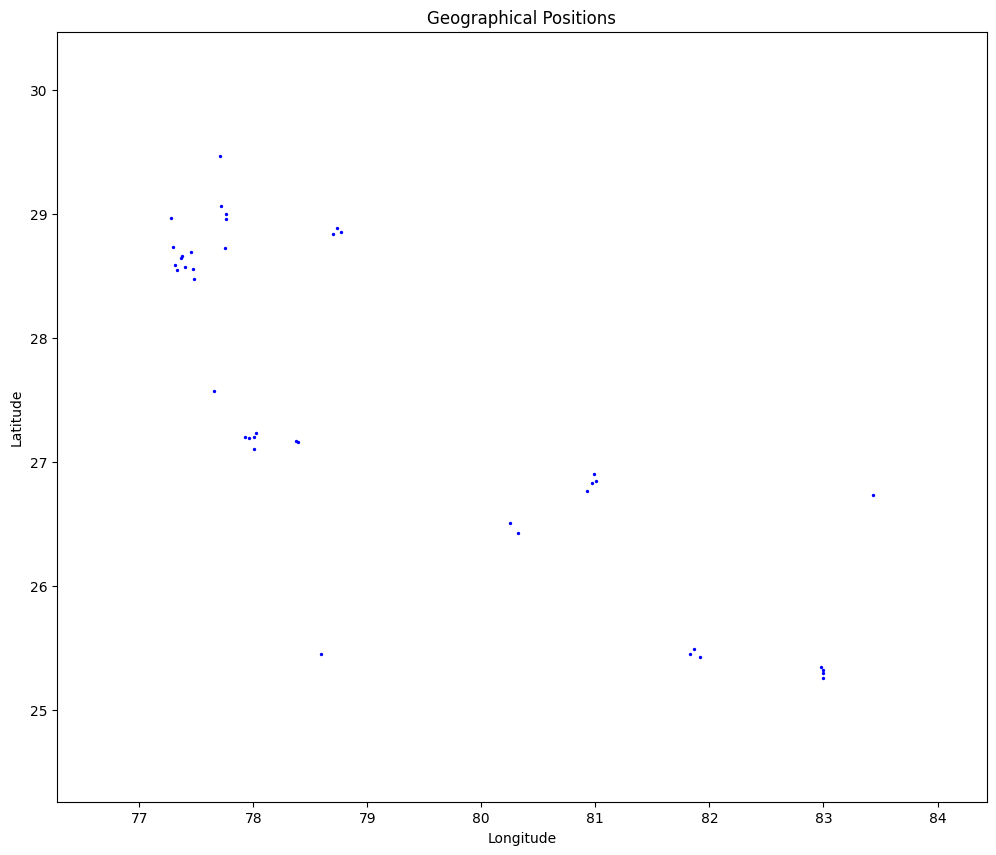

In [12]:
import matplotlib.pyplot as plt

# Split the latitude and longitude into separate lists
latitudes = [pos[0] for pos in filtered_lat_long_positions]
longitudes = [pos[1] for pos in filtered_lat_long_positions]

# Create a scatter plot with a larger figure size
plt.figure(figsize=(12, 10))  # Increase the figure size

# Plot the points with a larger marker size
plt.scatter(longitudes, latitudes, color='blue', marker='o', s=2)

# Label the axes
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Title of the plot
plt.title('Geographical Positions')

# Set the axis limits to zoom in and create more space between points
plt.xlim(min(longitudes) - 1, max(longitudes) + 1)
plt.ylim(min(latitudes) - 1, max(latitudes) + 1)

# Save the plot as an image file
output_image = 'positions_plot_large.png'
plt.savefig(output_image, dpi=300)  # Increase dpi for better resolution

# Show the plot
plt.show()


# Determine the k nearest neighbours

In [13]:
import numpy as np

k = 8  # Number of nearest neighbors

# Initialize adjacency matrix (with all zeros)
adjacency_matrix = np.zeros((len(input_files), len(input_files)), dtype=int)

# Loop through each entry to find k nearest neighbors
for i in range(len(input_files)):
    # Get distances for the i-th entry
    distances = distance_matrix[i]
    
    # Find the indices of the k smallest distances, excluding the distance to itself (i.e., index i)
    nearest_neighbors = np.argsort(distances)[1:k+1]  # 1:k+1 because argsort includes self-distance at position 0
    
    # Print the k nearest neighbors for the current file
    print(f"\nFile: {input_files[i]}")
    print(f"K-nearest neighbors: {[input_files[j] for j in nearest_neighbors]}")
    
    # Update the adjacency matrix to represent edges
    for neighbor in nearest_neighbors:
        adjacency_matrix[i][neighbor] = 1
        adjacency_matrix[neighbor][i] = 1  # Ensure undirected edge

# Print the adjacency matrix
print("\nAdjacency Matrix:")
print(adjacency_matrix)

# Print neighbors for each file based on the adjacency matrix
for i in range(len(input_files)):
    neighbors = [input_files[j] for j in range(len(input_files)) if adjacency_matrix[i][j] == 1]
    print(f"\nNeighbors of {input_files[i]} based on adjacency matrix: {neighbors}")


File: UP002.csv
K-nearest neighbors: ['UP024.csv', 'UP035.csv', 'UP039.csv', 'UP044.csv', 'UP040.csv', 'UP033.csv', 'UP038.csv', 'UP036.csv']

File: UP003.csv
K-nearest neighbors: ['UP041.csv', 'UP029.csv', 'UP031.csv', 'UP036.csv', 'UP033.csv', 'UP038.csv', 'UP032.csv', 'UP024.csv']

File: UP004.csv
K-nearest neighbors: ['UP030.csv', 'UP034.csv', 'UP028.csv', 'UP042.csv', 'UP037.csv', 'UP051.csv', 'UP043.csv', 'UP012.csv']

File: UP008.csv
K-nearest neighbors: ['UP021.csv', 'UP022.csv', 'UP018.csv', 'UP020.csv', 'UP009.csv', 'UP012.csv', 'UP017.csv', 'UP019.csv']

File: UP009.csv
K-nearest neighbors: ['UP018.csv', 'UP017.csv', 'UP021.csv', 'UP022.csv', 'UP019.csv', 'UP008.csv', 'UP020.csv', 'UP012.csv']

File: UP012.csv
K-nearest neighbors: ['UP020.csv', 'UP022.csv', 'UP008.csv', 'UP021.csv', 'UP018.csv', 'UP009.csv', 'UP017.csv', 'UP019.csv']

File: UP014.csv
K-nearest neighbors: ['UP026.csv', 'UP025.csv', 'UP023.csv', 'UP050.csv', 'UP016.csv', 'UP017.csv', 'UP019.csv', 'UP009.csv']

# Plotting the edges on the map

In [14]:
import folium

# Create a Folium map centered at the average of the coordinates
center_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
center_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)

# Initialize the map
m = folium.Map(location=[center_lat, center_long], zoom_start=5)

# Add markers for each position
for idx, (lat, long) in enumerate(filtered_lat_long_positions):
    folium.Marker([lat, long], tooltip=f'Point {idx + 1}').add_to(m)

# Add edges based on adjacency matrix
for i in range(len(adjacency_matrix)):
    for j in range(i + 1, len(adjacency_matrix)):  # Only check upper triangle to avoid duplicate edges
        if adjacency_matrix[i][j] == 1:
            # Draw a line between point i and point j
            folium.PolyLine([filtered_lat_long_positions[i], filtered_lat_long_positions[j]], color="blue").add_to(m)

# Save the map to an HTML file or display in Jupyter notebook
m.save("map_with_edges.html")

# To display directly in Jupyter notebook
m


# Change the diagonal elements to 1

In [15]:
# Change the diagonal elements to 1
np.fill_diagonal(adjacency_matrix, 1)
adjacency_matrix

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       [0, 0, 1, ..., 0, 1, 1]])

# Prepare Graph Data for GNN

In [16]:
# Prepare graph data for each timestamp
def prepare_graph_data_for_timestamp(dataframes, adjacency_matrix, timestamp_index):
    # Extract the row corresponding to the timestamp index from all CSV files
    features = np.stack([df.iloc[timestamp_index].values for df in dataframes], axis=0)  # shape (num_nodes, num_features)
    
    # Create node features (tensor)
    node_features = torch.tensor(features, dtype=torch.float)
    
    # Create edge index (adjacency matrix)
    edge_index = torch.tensor(np.array(np.nonzero(adjacency_matrix)), dtype=torch.long)
    
    # Create target tensor (for 'AT (degree C)')
    target_values = torch.tensor([df.iloc[timestamp_index]['AT (degree C)'] for df in dataframes], dtype=torch.float)
    
    graph_data = Data(x=node_features, edge_index=edge_index, y=target_values)
    print(f"Graph data for timestamp {timestamp_index} created.")
    print(graph_data)
    return graph_data

# Get the number of timestamps
train_num_timestamps = len(train_dataframes[0])
test_num_timestamps = len(test_dataframes[0])

# Prepare graph data for each timestamp
train_graph_data_list = [prepare_graph_data_for_timestamp(train_dataframes, adjacency_matrix, i) for i in range(train_num_timestamps)]
test_graph_data_list = [prepare_graph_data_for_timestamp(test_dataframes, adjacency_matrix, i) for i in range(test_num_timestamps)]

print(f"Number of graph data objects created for training: {len(train_graph_data_list)}")
print(f"Number of graph data objects created for testing: {len(test_graph_data_list)}")
print("Sample training graph data object:")
print(train_graph_data_list[0])
print("Sample testing graph data object:")
print(test_graph_data_list[0])

Graph data for timestamp 0 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 1 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 2 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 3 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 4 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 5 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 6 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 7 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 8 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 9 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 10 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 11 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for

# GAT Implementation

Epoch 0, Loss: 0.31830702087549795
Epoch 1, Loss: 0.12789143105815007
Epoch 2, Loss: 0.11690521460445336
Epoch 3, Loss: 0.11336742362962375
Epoch 4, Loss: 0.1118290116157627
Epoch 5, Loss: 0.10945856168171378
Epoch 6, Loss: 0.10949898103791669
Epoch 7, Loss: 0.10881611734408098
Epoch 8, Loss: 0.10936513115862549
Epoch 9, Loss: 0.10950589590938901
Epoch 10, Loss: 0.1081337667898953
Epoch 11, Loss: 0.1081791732135531
Epoch 12, Loss: 0.10791805059715247
Epoch 13, Loss: 0.10864693043238001
Epoch 14, Loss: 0.10827101728495246
Epoch 15, Loss: 0.10796879763870915
Epoch 16, Loss: 0.10816348565481831
Epoch 17, Loss: 0.10804052581629078
Epoch 18, Loss: 0.10818907631259538
Epoch 19, Loss: 0.10791645460719329
Epoch 20, Loss: 0.10764764329508067
Epoch 21, Loss: 0.1074638656674534
Epoch 22, Loss: 0.1076094520741648
Epoch 23, Loss: 0.10758965115117479
Epoch 24, Loss: 0.10773677918664824
Epoch 25, Loss: 0.1079643766460381
Epoch 26, Loss: 0.10774780901041305
Epoch 27, Loss: 0.10741800936565195
Epoch 28

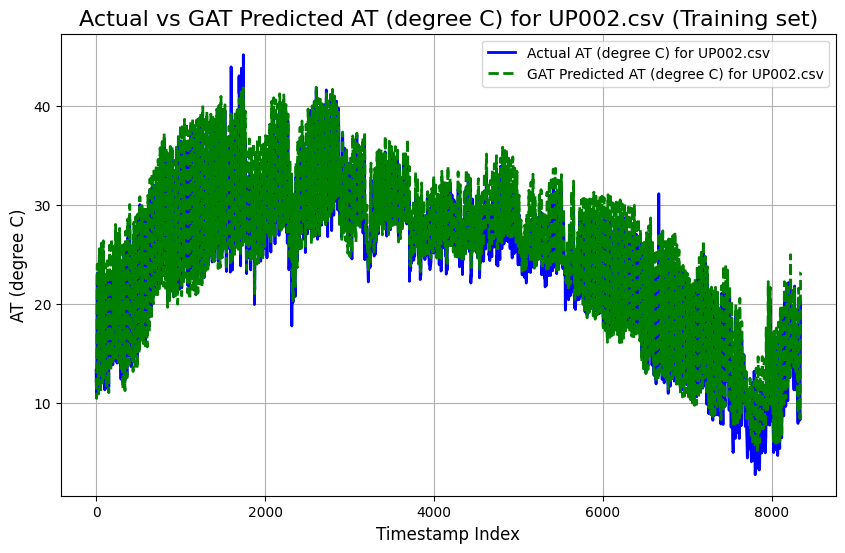

UP003.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2388
Mean Squared Error (MSE): 2.5365
Root Mean Squared Error (RMSE): 1.5926
Pearson Correlation Coefficient: 0.9867
R-squared (R²): 0.9666

----------------------------------------



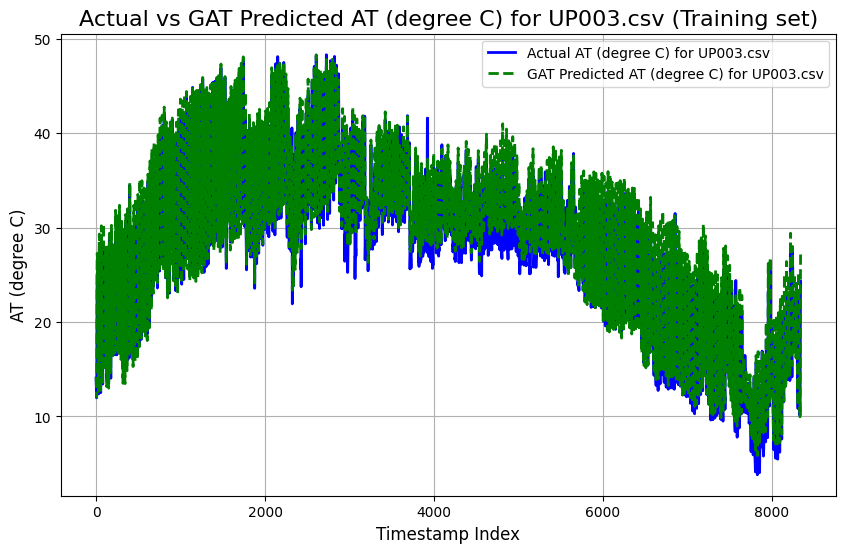

UP004.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2672
Mean Squared Error (MSE): 2.3898
Root Mean Squared Error (RMSE): 1.5459
Pearson Correlation Coefficient: 0.9888
R-squared (R²): 0.9715

----------------------------------------



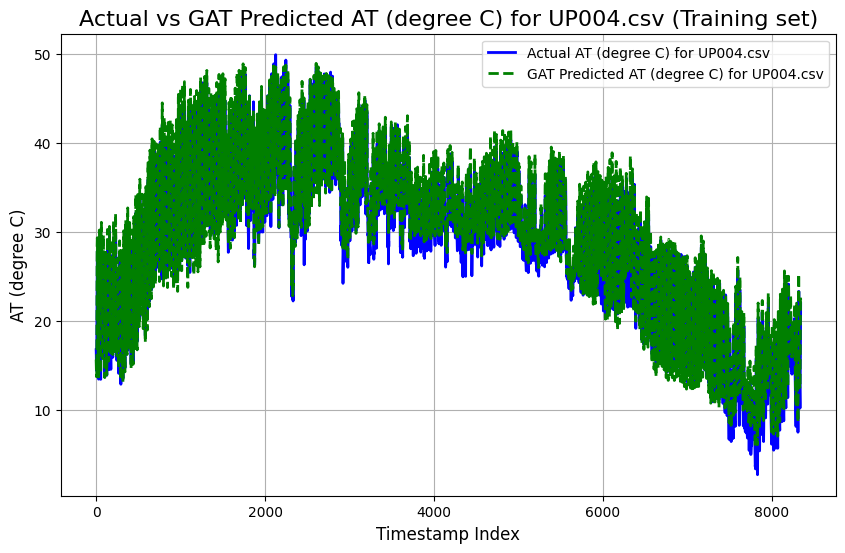

UP008.csv (Training set) Metrics:
Mean Absolute Error (MAE): 5.1801
Mean Squared Error (MSE): 55.8453
Root Mean Squared Error (RMSE): 7.4730
Pearson Correlation Coefficient: 0.8117
R-squared (R²): 0.6282

----------------------------------------



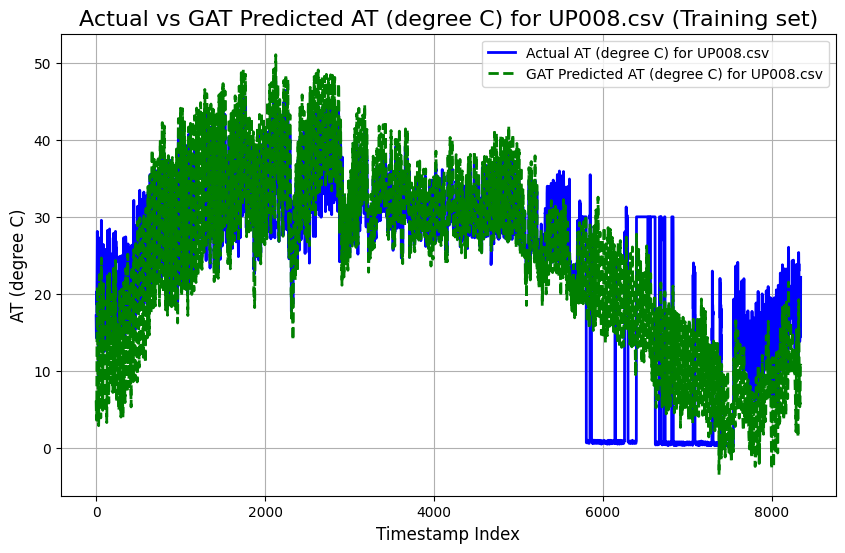

UP009.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1428
Mean Squared Error (MSE): 2.0353
Root Mean Squared Error (RMSE): 1.4266
Pearson Correlation Coefficient: 0.9855
R-squared (R²): 0.9666

----------------------------------------



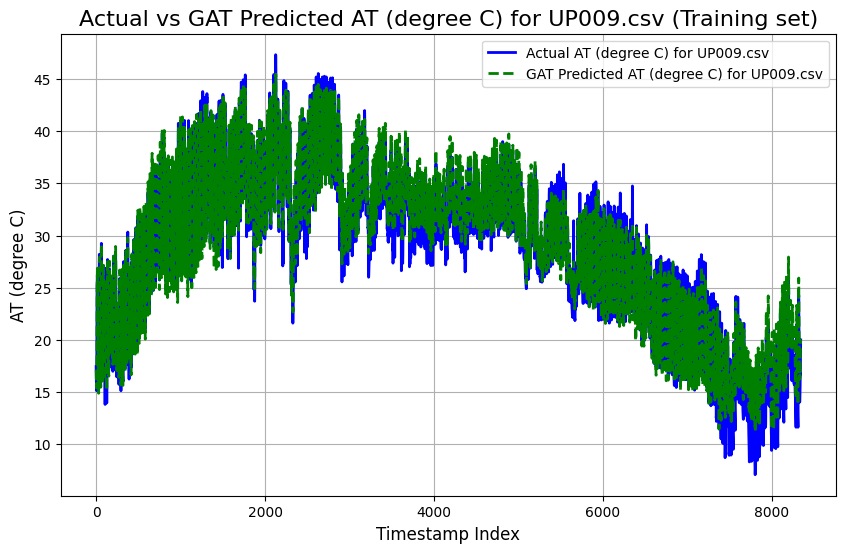

UP012.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4618
Mean Squared Error (MSE): 4.2194
Root Mean Squared Error (RMSE): 2.0541
Pearson Correlation Coefficient: 0.9828
R-squared (R²): 0.9611

----------------------------------------



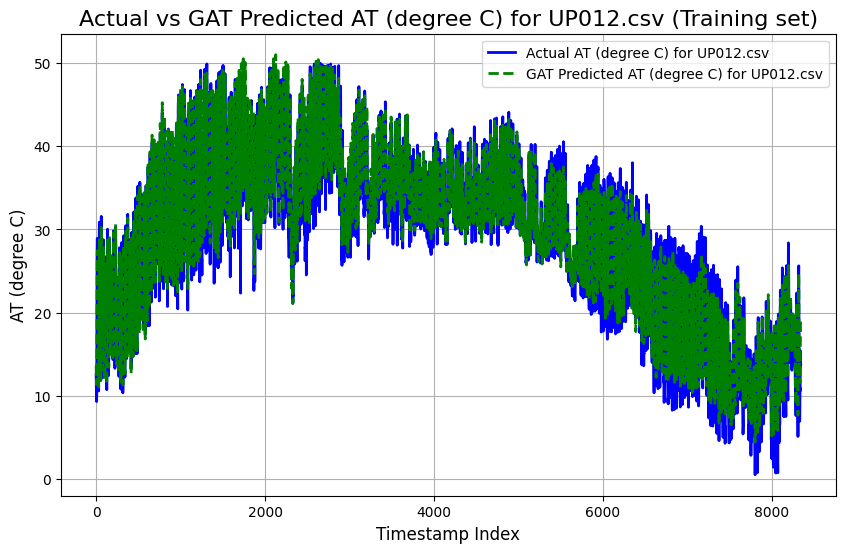

UP014.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.9503
Mean Squared Error (MSE): 13.1743
Root Mean Squared Error (RMSE): 3.6296
Pearson Correlation Coefficient: 0.9535
R-squared (R²): 0.9009

----------------------------------------



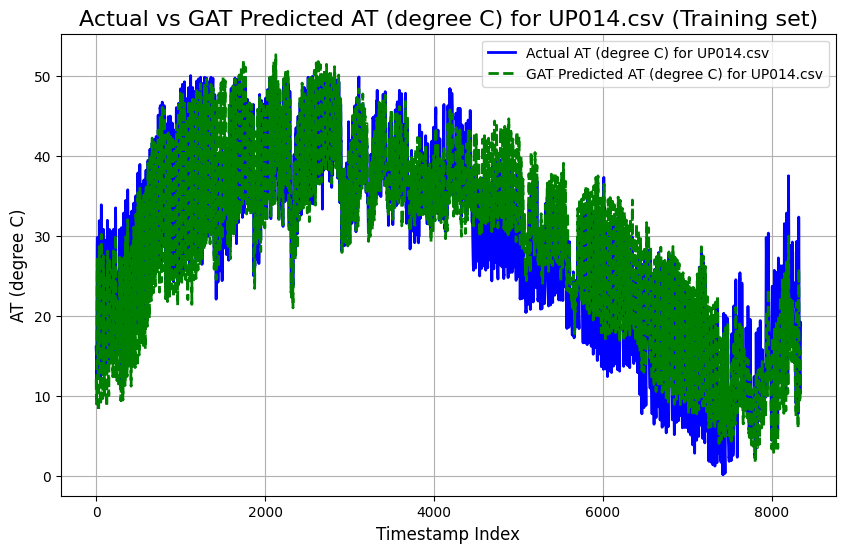

UP016.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.7791
Mean Squared Error (MSE): 12.2140
Root Mean Squared Error (RMSE): 3.4948
Pearson Correlation Coefficient: 0.9580
R-squared (R²): 0.9105

----------------------------------------



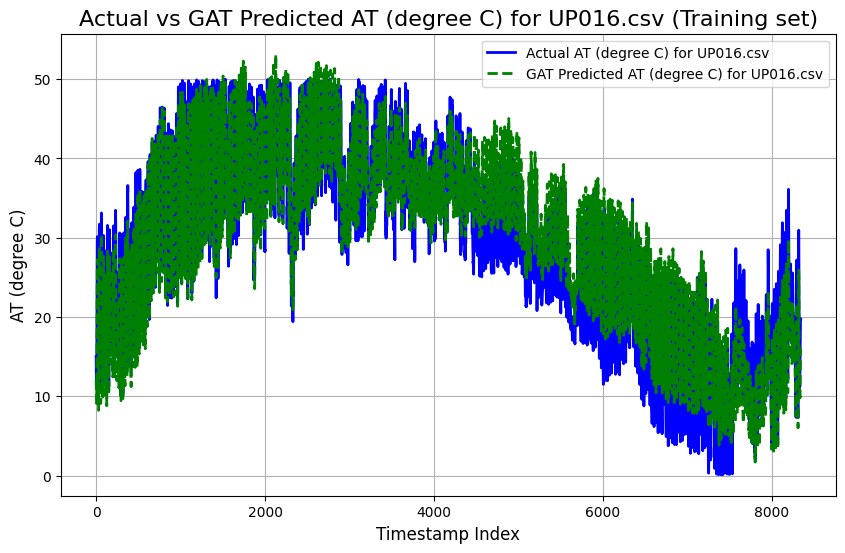

UP017.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.8987
Mean Squared Error (MSE): 1.1745
Root Mean Squared Error (RMSE): 1.0838
Pearson Correlation Coefficient: 0.9844
R-squared (R²): 0.9641

----------------------------------------



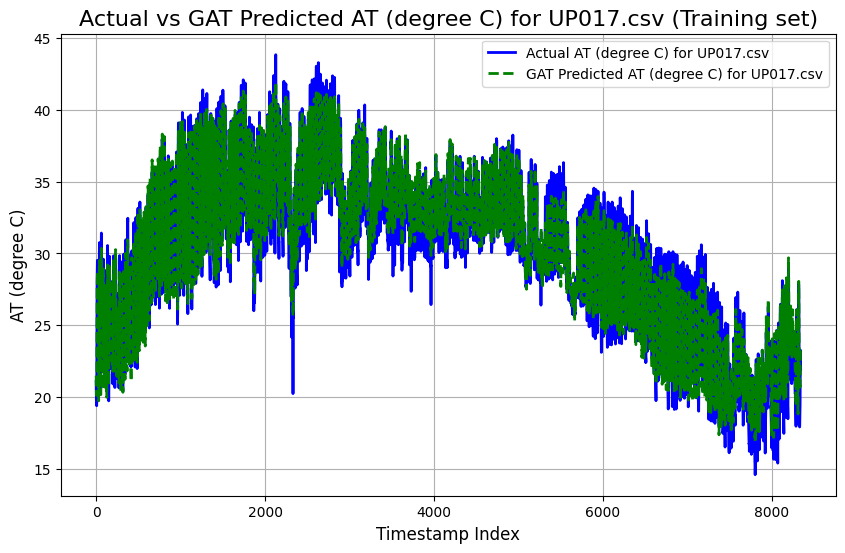

UP018.csv (Training set) Metrics:
Mean Absolute Error (MAE): 4.6827
Mean Squared Error (MSE): 42.8139
Root Mean Squared Error (RMSE): 6.5432
Pearson Correlation Coefficient: 0.5494
R-squared (R²): 0.1141

----------------------------------------



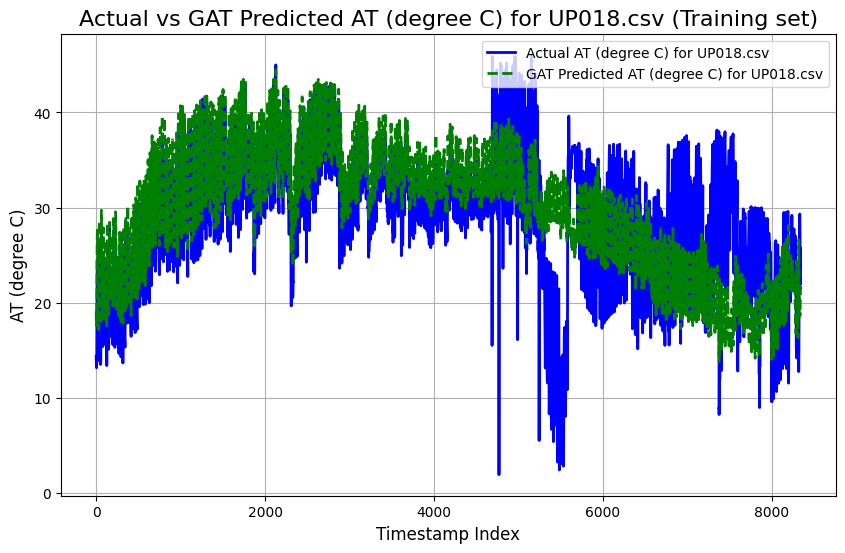

UP019.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5215
Mean Squared Error (MSE): 5.1278
Root Mean Squared Error (RMSE): 2.2645
Pearson Correlation Coefficient: 0.9347
R-squared (R²): 0.8663

----------------------------------------



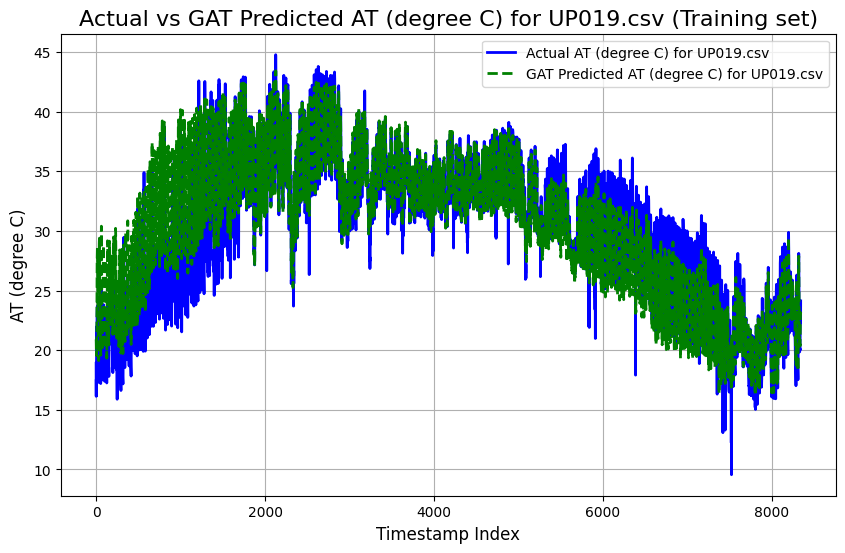

UP020.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2355
Mean Squared Error (MSE): 2.2749
Root Mean Squared Error (RMSE): 1.5083
Pearson Correlation Coefficient: 0.9821
R-squared (R²): 0.9599

----------------------------------------



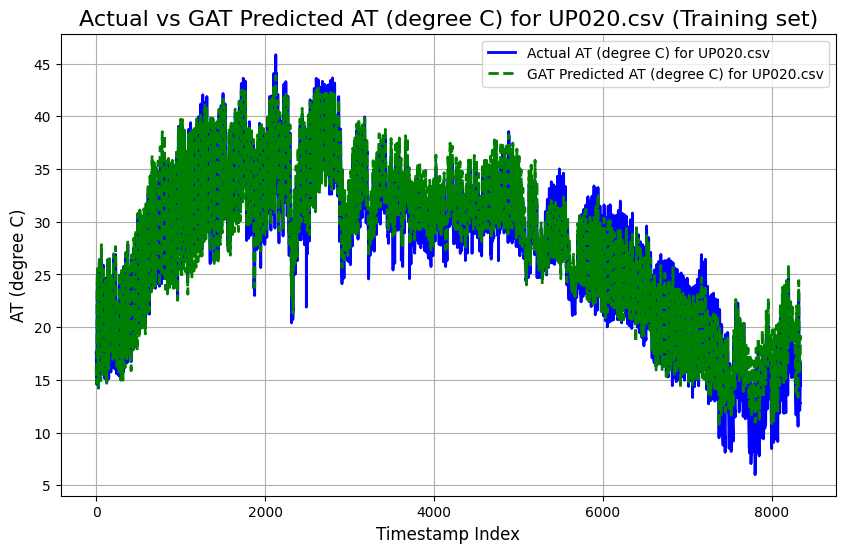

UP021.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.6076
Mean Squared Error (MSE): 21.7094
Root Mean Squared Error (RMSE): 4.6593
Pearson Correlation Coefficient: 0.8623
R-squared (R²): 0.7264

----------------------------------------



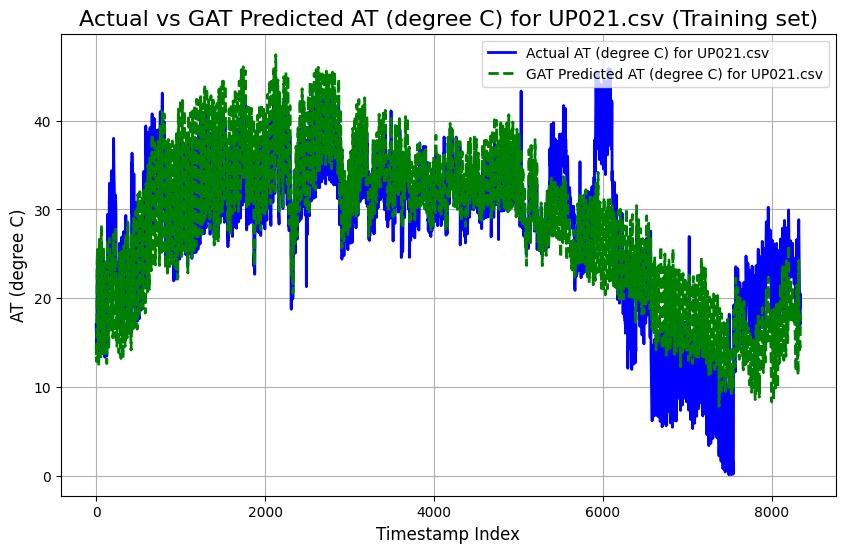

UP022.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2981
Mean Squared Error (MSE): 3.1114
Root Mean Squared Error (RMSE): 1.7639
Pearson Correlation Coefficient: 0.9748
R-squared (R²): 0.9457

----------------------------------------



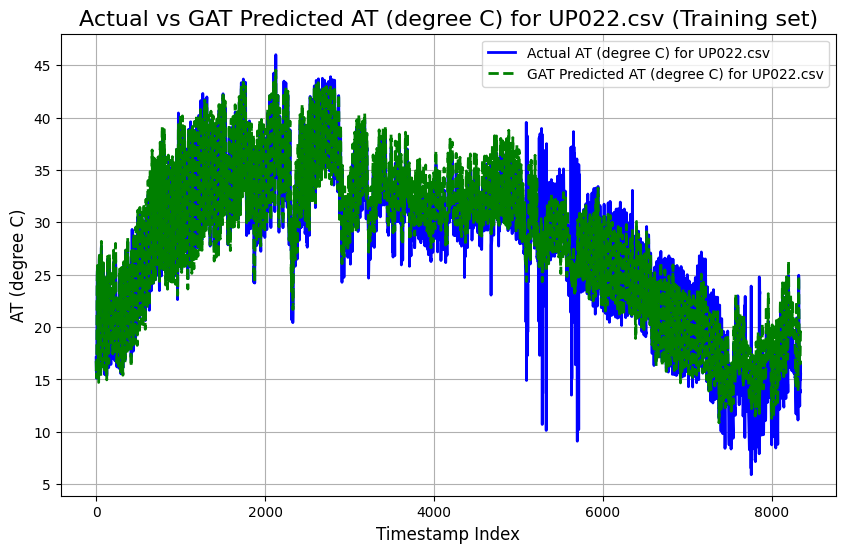

UP023.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3094
Mean Squared Error (MSE): 3.6124
Root Mean Squared Error (RMSE): 1.9006
Pearson Correlation Coefficient: 0.9726
R-squared (R²): 0.9397

----------------------------------------



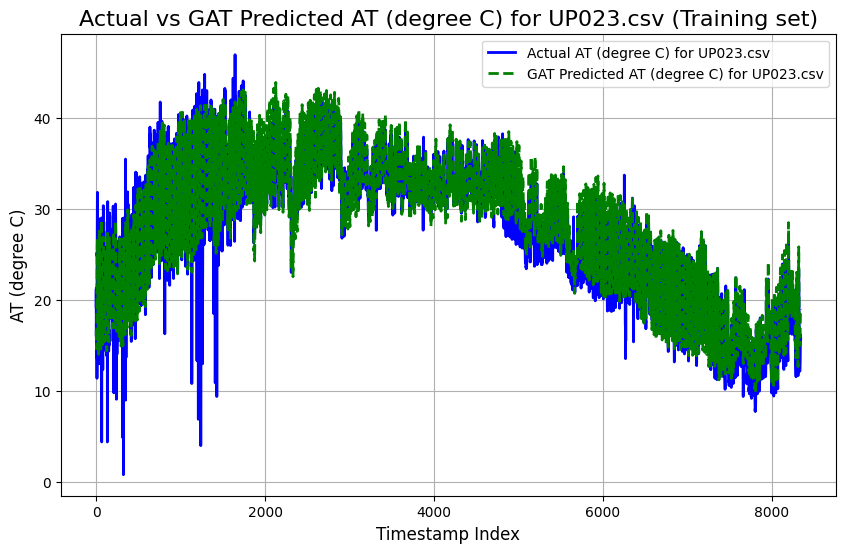

UP024.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6781
Mean Squared Error (MSE): 13.5309
Root Mean Squared Error (RMSE): 3.6784
Pearson Correlation Coefficient: 0.8363
R-squared (R²): 0.6589

----------------------------------------



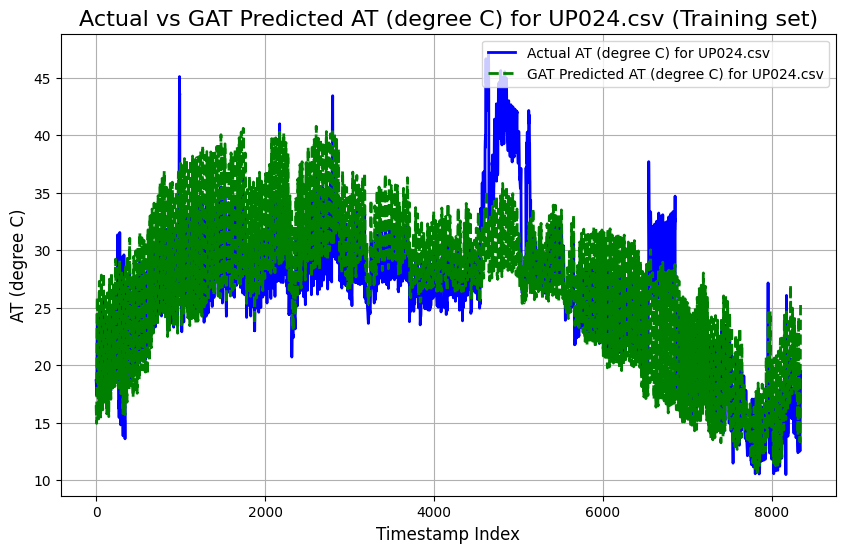

UP025.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0656
Mean Squared Error (MSE): 1.8959
Root Mean Squared Error (RMSE): 1.3769
Pearson Correlation Coefficient: 0.9868
R-squared (R²): 0.9681

----------------------------------------



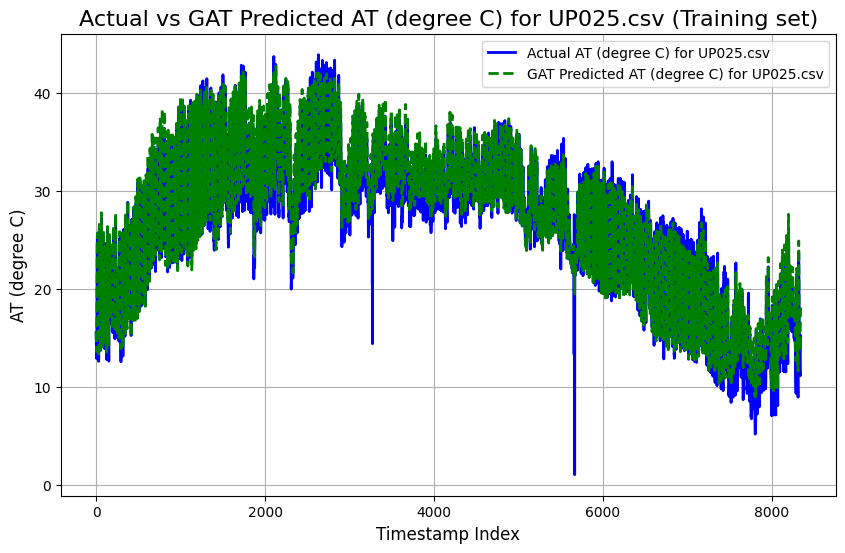

UP026.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0670
Mean Squared Error (MSE): 1.8426
Root Mean Squared Error (RMSE): 1.3574
Pearson Correlation Coefficient: 0.9892
R-squared (R²): 0.9731

----------------------------------------



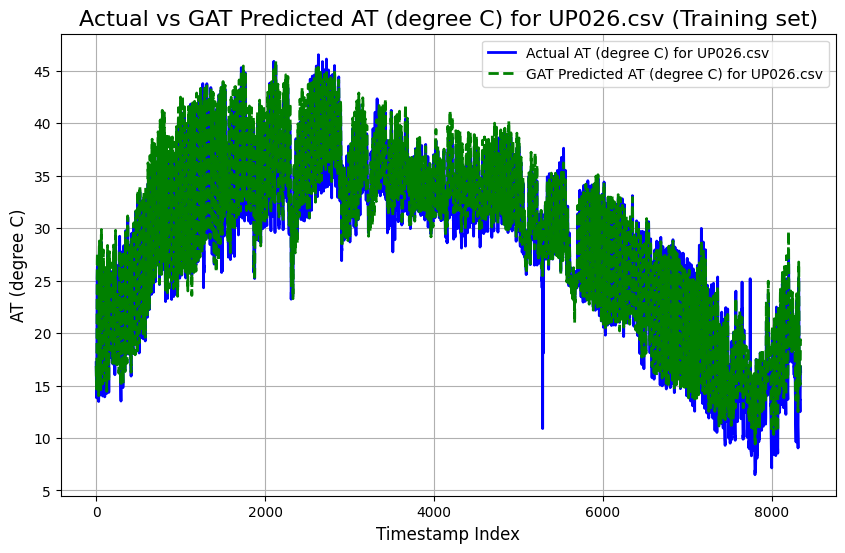

UP028.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7908
Mean Squared Error (MSE): 4.9682
Root Mean Squared Error (RMSE): 2.2290
Pearson Correlation Coefficient: 0.9766
R-squared (R²): 0.9465

----------------------------------------



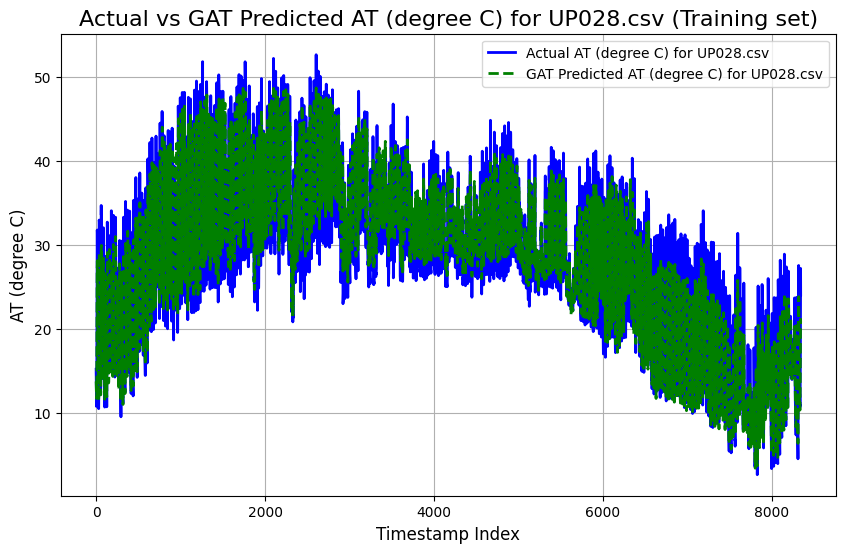

UP029.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9768
Mean Squared Error (MSE): 1.7335
Root Mean Squared Error (RMSE): 1.3166
Pearson Correlation Coefficient: 0.9891
R-squared (R²): 0.9715

----------------------------------------



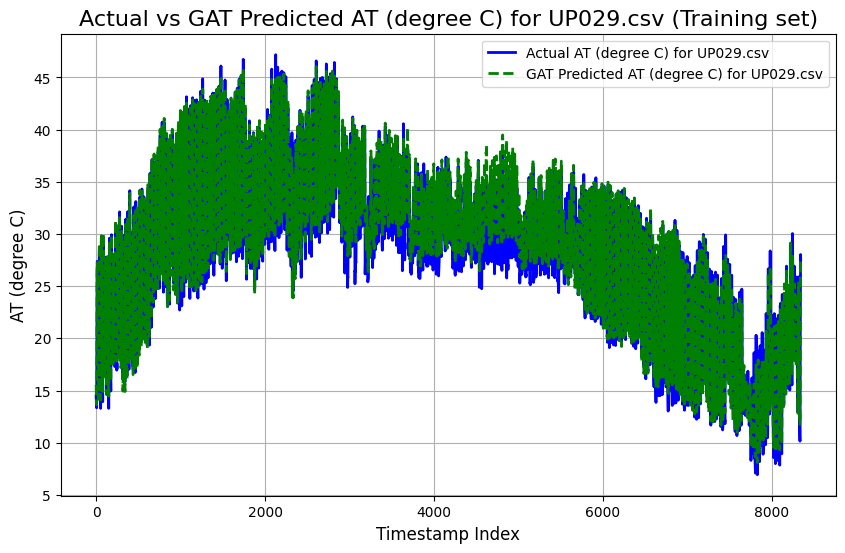

UP030.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2493
Mean Squared Error (MSE): 2.5412
Root Mean Squared Error (RMSE): 1.5941
Pearson Correlation Coefficient: 0.9875
R-squared (R²): 0.9689

----------------------------------------



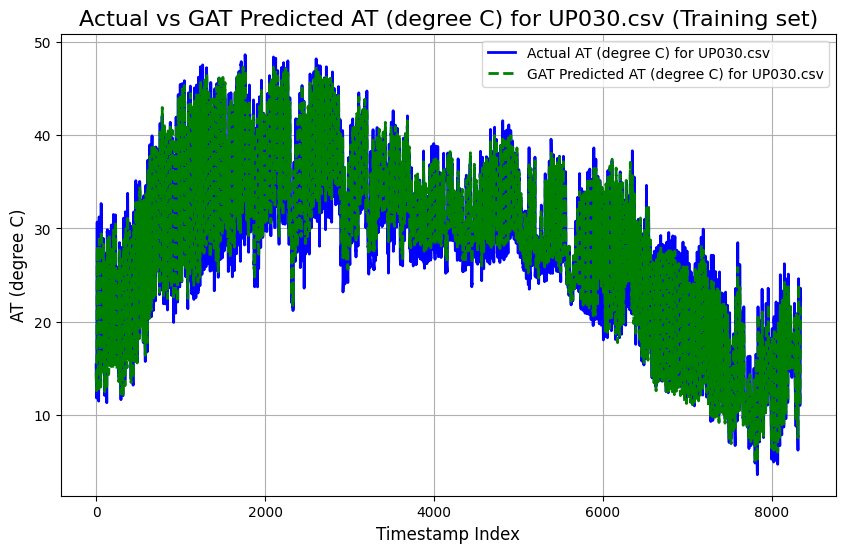

UP031.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5214
Mean Squared Error (MSE): 3.7428
Root Mean Squared Error (RMSE): 1.9346
Pearson Correlation Coefficient: 0.9764
R-squared (R²): 0.9454

----------------------------------------



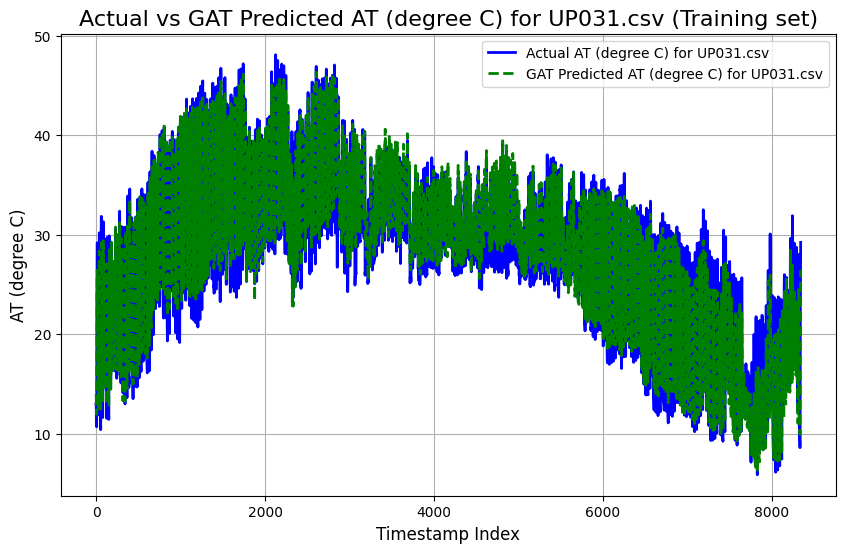

UP032.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4713
Mean Squared Error (MSE): 3.7845
Root Mean Squared Error (RMSE): 1.9454
Pearson Correlation Coefficient: 0.9686
R-squared (R²): 0.9293

----------------------------------------



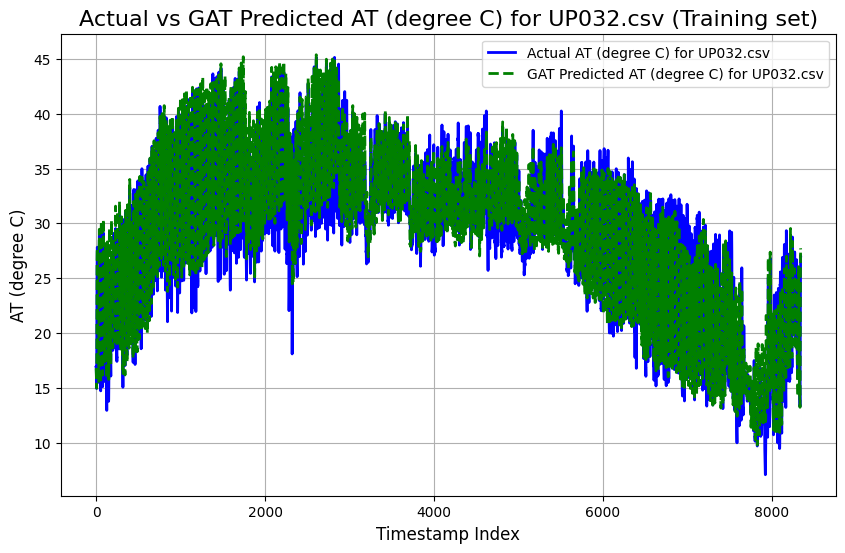

UP033.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9515
Mean Squared Error (MSE): 1.6176
Root Mean Squared Error (RMSE): 1.2719
Pearson Correlation Coefficient: 0.9904
R-squared (R²): 0.9744

----------------------------------------



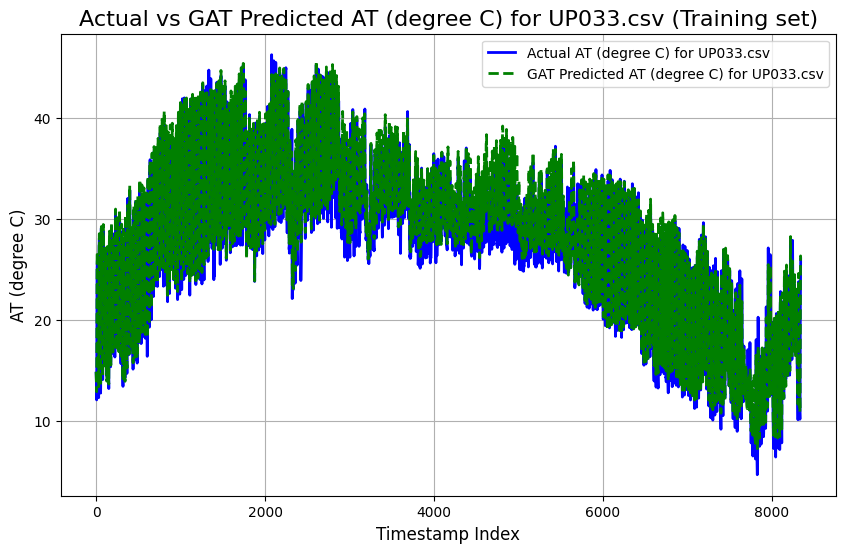

UP034.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4441
Mean Squared Error (MSE): 4.4561
Root Mean Squared Error (RMSE): 2.1110
Pearson Correlation Coefficient: 0.9790
R-squared (R²): 0.9514

----------------------------------------



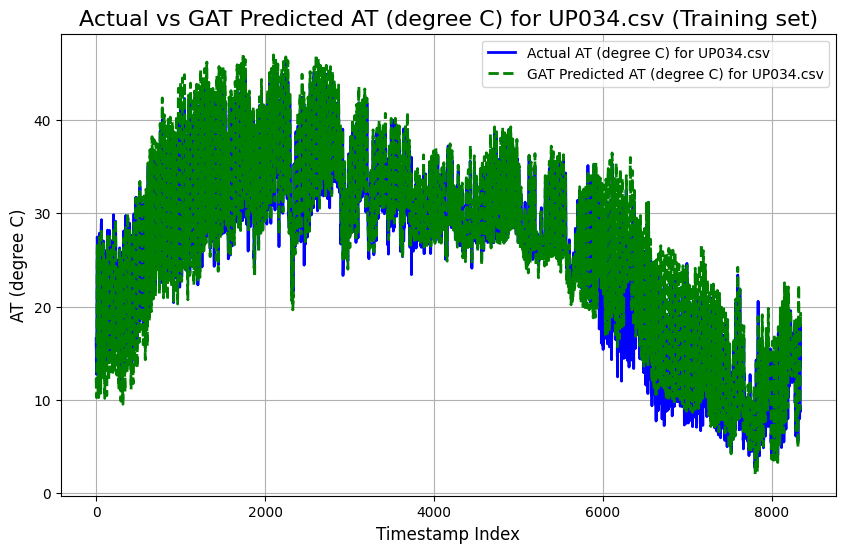

UP035.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0741
Mean Squared Error (MSE): 1.9114
Root Mean Squared Error (RMSE): 1.3825
Pearson Correlation Coefficient: 0.9896
R-squared (R²): 0.9727

----------------------------------------



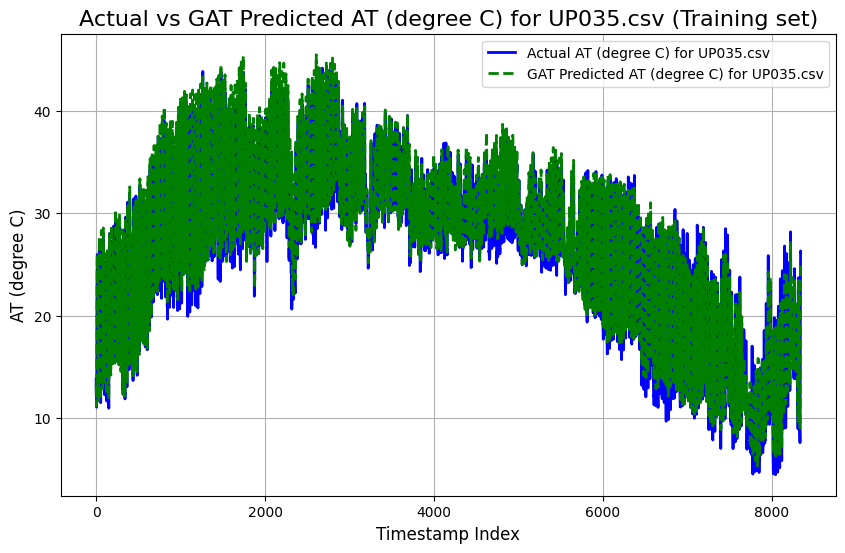

UP036.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0714
Mean Squared Error (MSE): 2.1655
Root Mean Squared Error (RMSE): 1.4716
Pearson Correlation Coefficient: 0.9858
R-squared (R²): 0.9649

----------------------------------------



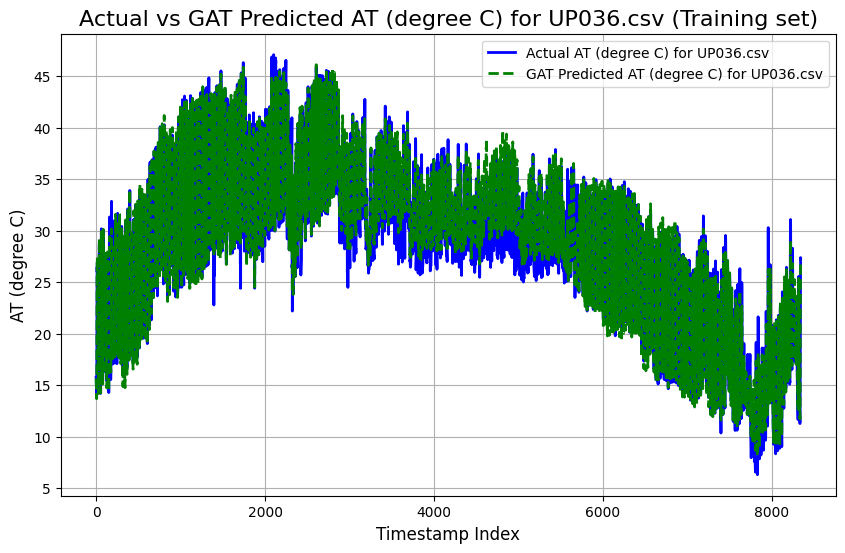

UP037.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1416
Mean Squared Error (MSE): 2.1719
Root Mean Squared Error (RMSE): 1.4737
Pearson Correlation Coefficient: 0.9890
R-squared (R²): 0.9720

----------------------------------------



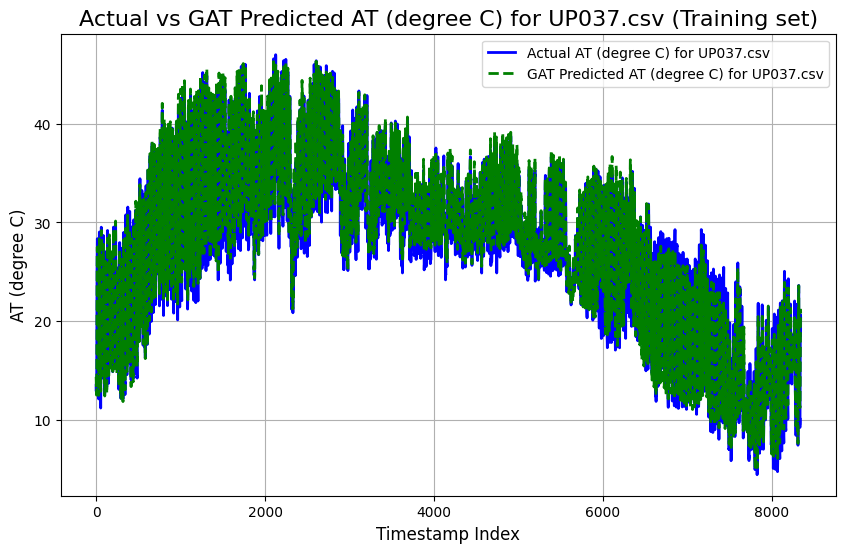

UP038.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0254
Mean Squared Error (MSE): 1.9957
Root Mean Squared Error (RMSE): 1.4127
Pearson Correlation Coefficient: 0.9867
R-squared (R²): 0.9668

----------------------------------------



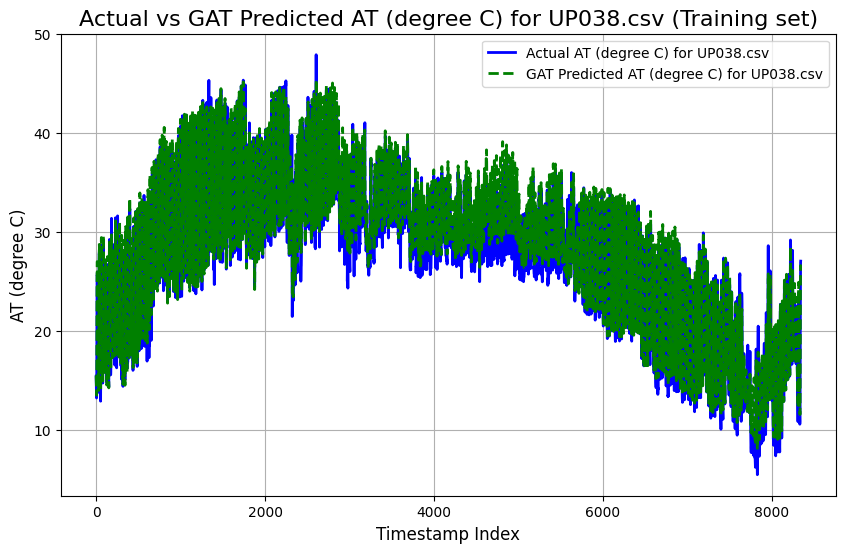

UP039.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5877
Mean Squared Error (MSE): 4.3010
Root Mean Squared Error (RMSE): 2.0739
Pearson Correlation Coefficient: 0.9765
R-squared (R²): 0.9459

----------------------------------------



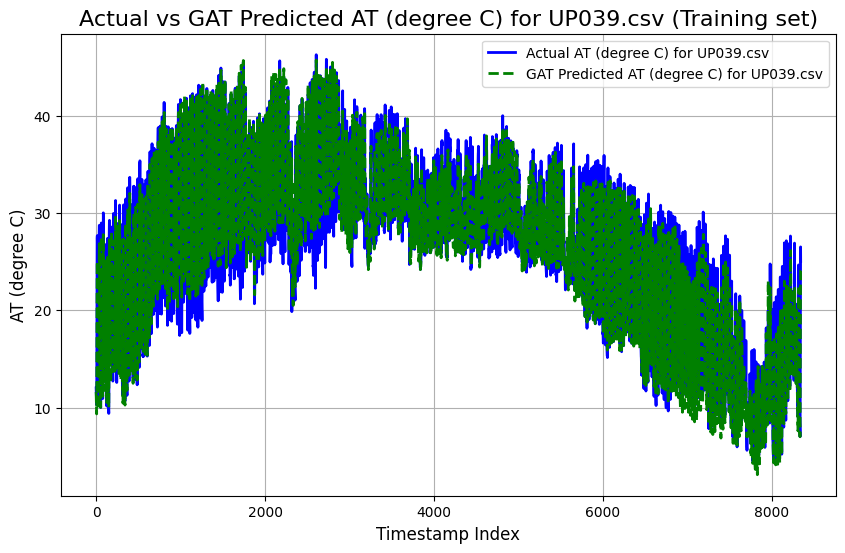

UP040.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3495
Mean Squared Error (MSE): 3.0734
Root Mean Squared Error (RMSE): 1.7531
Pearson Correlation Coefficient: 0.9840
R-squared (R²): 0.9618

----------------------------------------



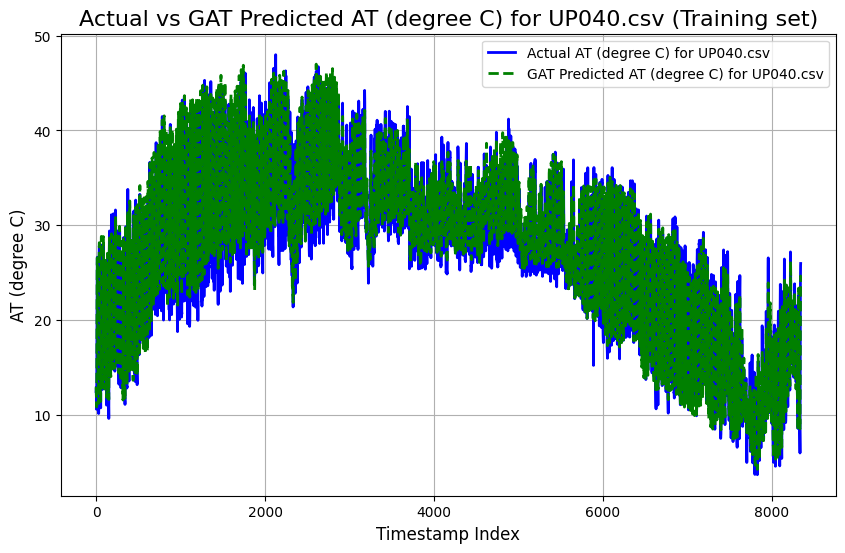

UP041.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0277
Mean Squared Error (MSE): 1.8644
Root Mean Squared Error (RMSE): 1.3654
Pearson Correlation Coefficient: 0.9873
R-squared (R²): 0.9677

----------------------------------------



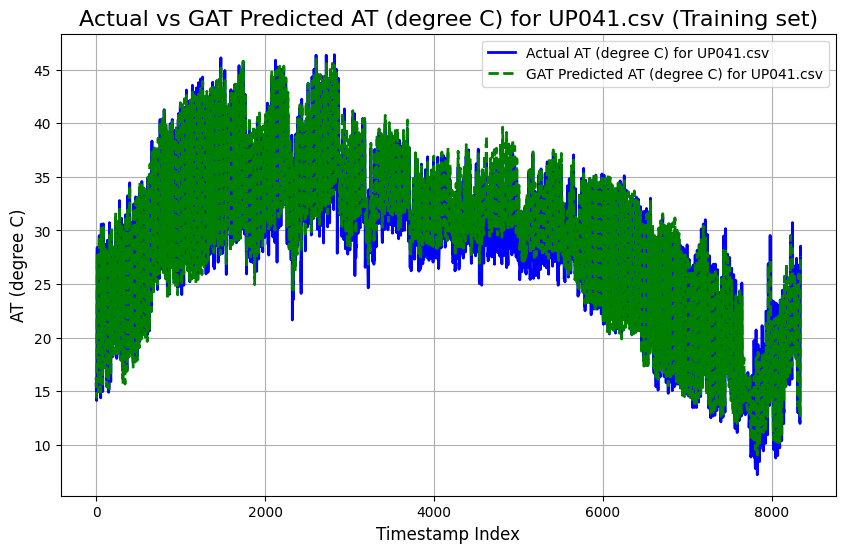

UP042.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1286
Mean Squared Error (MSE): 2.5627
Root Mean Squared Error (RMSE): 1.6008
Pearson Correlation Coefficient: 0.9845
R-squared (R²): 0.9626

----------------------------------------



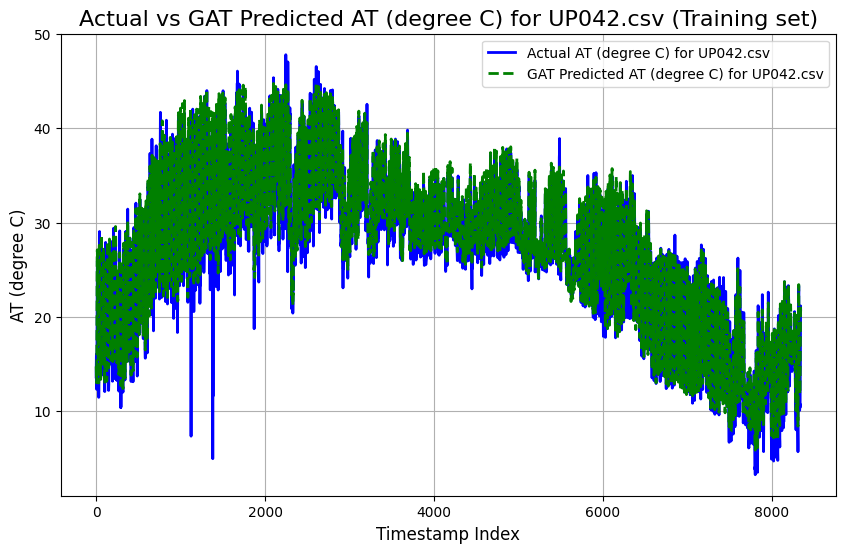

UP043.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1341
Mean Squared Error (MSE): 2.2677
Root Mean Squared Error (RMSE): 1.5059
Pearson Correlation Coefficient: 0.9880
R-squared (R²): 0.9698

----------------------------------------



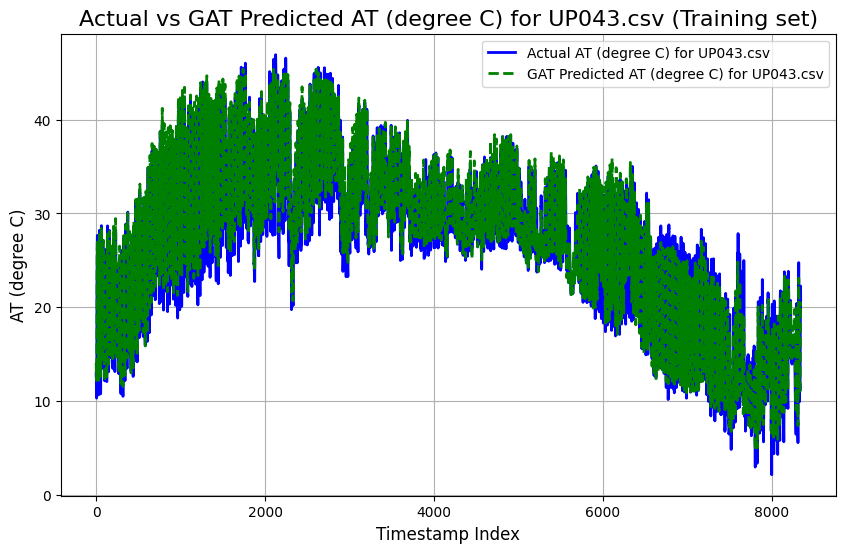

UP044.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1652
Mean Squared Error (MSE): 2.3120
Root Mean Squared Error (RMSE): 1.5205
Pearson Correlation Coefficient: 0.9882
R-squared (R²): 0.9702

----------------------------------------



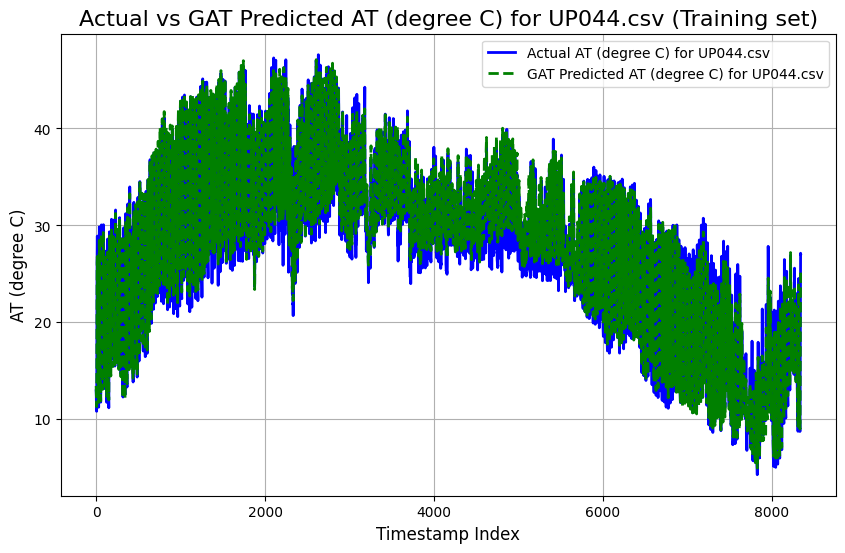

UP046.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4533
Mean Squared Error (MSE): 3.3427
Root Mean Squared Error (RMSE): 1.8283
Pearson Correlation Coefficient: 0.9793
R-squared (R²): 0.9521

----------------------------------------



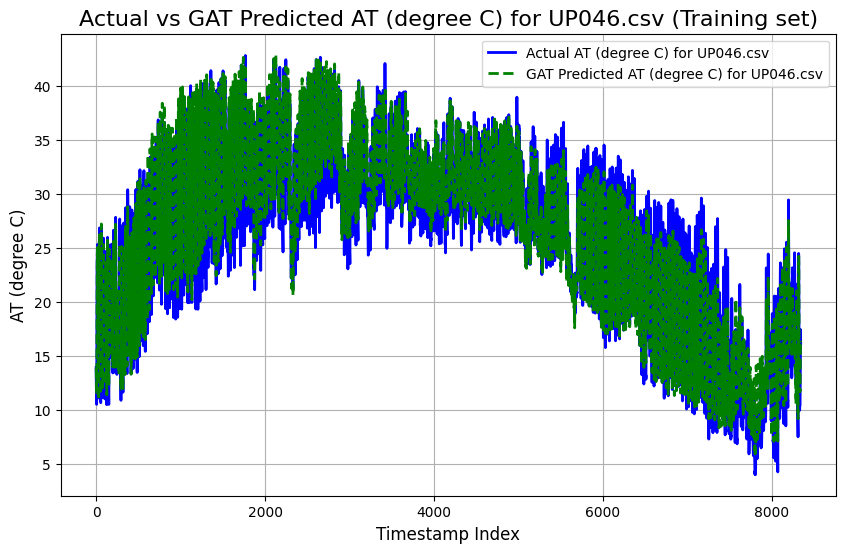

UP048.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5551
Mean Squared Error (MSE): 4.0677
Root Mean Squared Error (RMSE): 2.0168
Pearson Correlation Coefficient: 0.9731
R-squared (R²): 0.9394

----------------------------------------



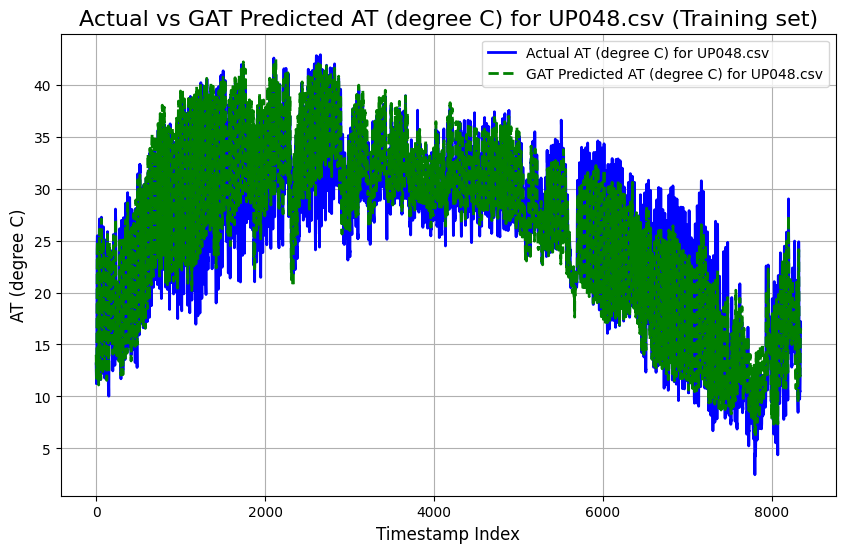

UP049.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3782
Mean Squared Error (MSE): 3.2628
Root Mean Squared Error (RMSE): 1.8063
Pearson Correlation Coefficient: 0.9804
R-squared (R²): 0.9543

----------------------------------------



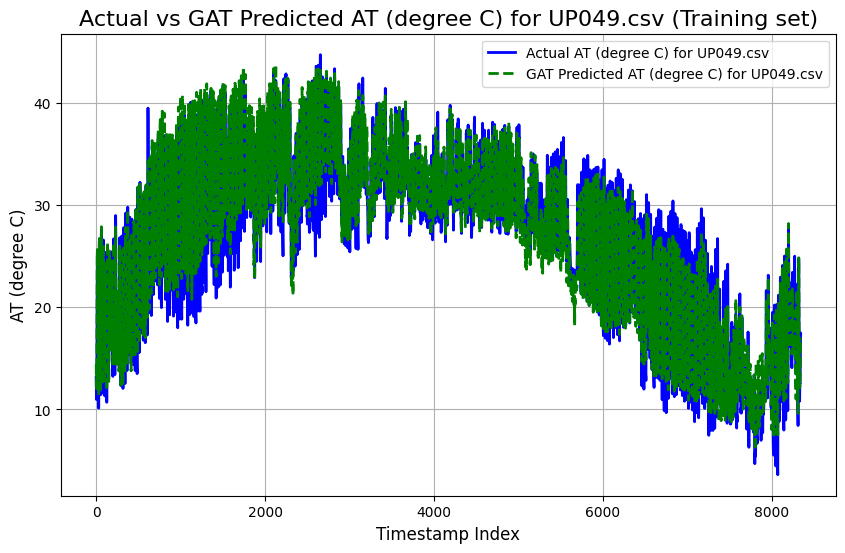

UP050.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5374
Mean Squared Error (MSE): 4.3448
Root Mean Squared Error (RMSE): 2.0844
Pearson Correlation Coefficient: 0.9663
R-squared (R²): 0.9282

----------------------------------------



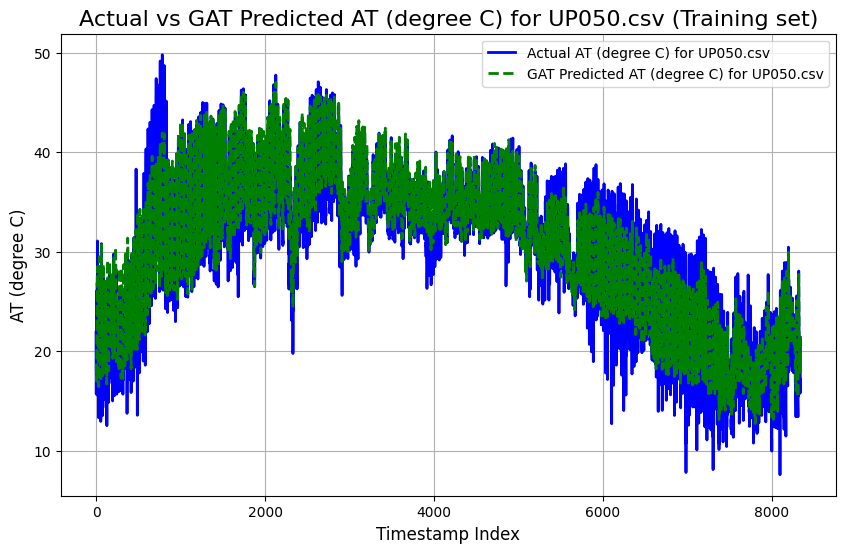

UP051.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6305
Mean Squared Error (MSE): 21.5761
Root Mean Squared Error (RMSE): 4.6450
Pearson Correlation Coefficient: 0.8554
R-squared (R²): 0.6989

----------------------------------------



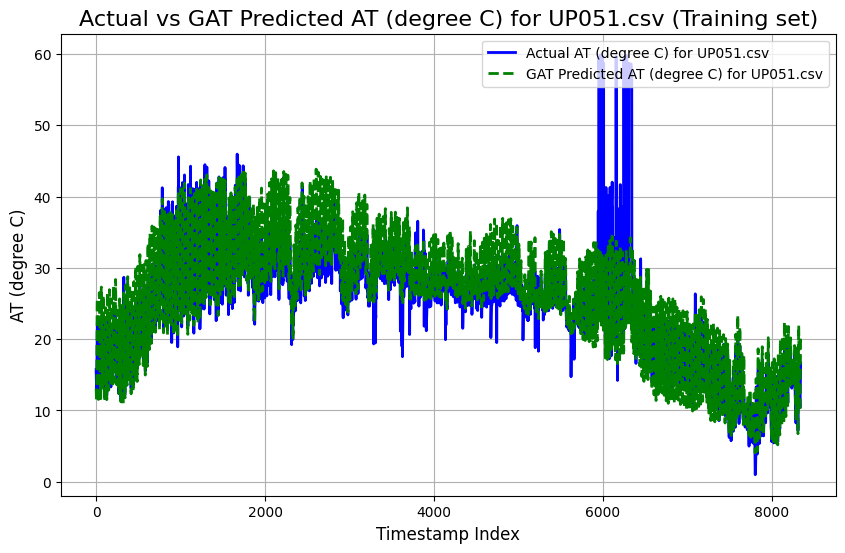

UP052.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5931
Mean Squared Error (MSE): 4.3497
Root Mean Squared Error (RMSE): 2.0856
Pearson Correlation Coefficient: 0.9719
R-squared (R²): 0.9369

----------------------------------------



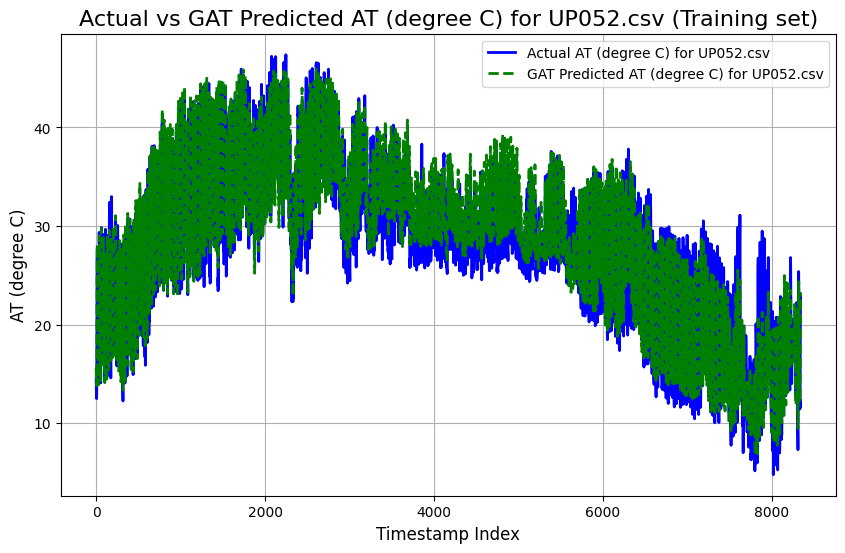

UP002.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1620
Mean Squared Error (MSE): 2.1355
Root Mean Squared Error (RMSE): 1.4614
Pearson Correlation Coefficient: 0.9711
R-squared (R²): 0.9246

----------------------------------------



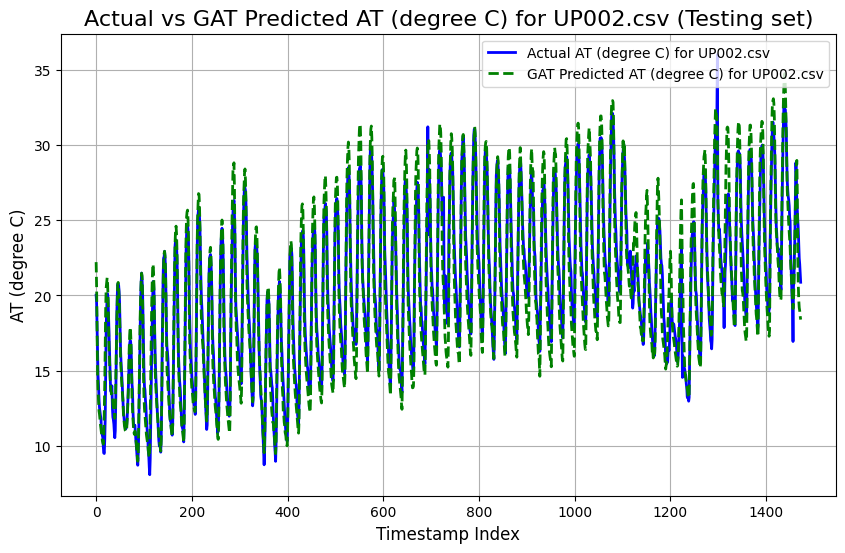

UP003.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2932
Mean Squared Error (MSE): 2.2907
Root Mean Squared Error (RMSE): 1.5135
Pearson Correlation Coefficient: 0.9786
R-squared (R²): 0.9393

----------------------------------------



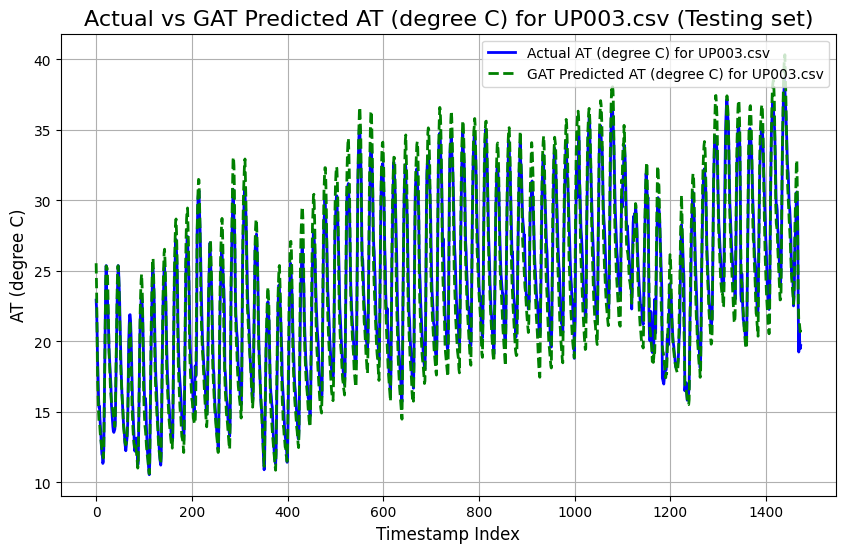

UP004.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3184
Mean Squared Error (MSE): 2.5801
Root Mean Squared Error (RMSE): 1.6063
Pearson Correlation Coefficient: 0.9705
R-squared (R²): 0.9248

----------------------------------------



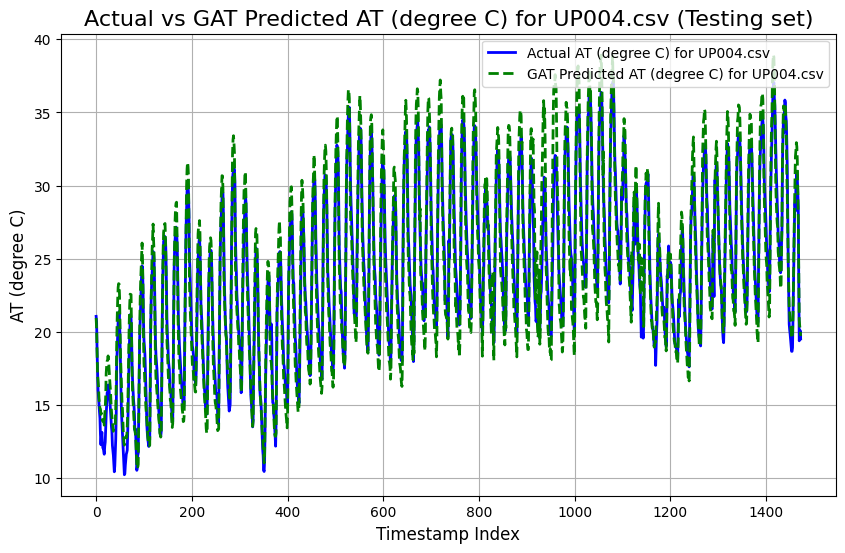

UP008.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.1700
Mean Squared Error (MSE): 35.1176
Root Mean Squared Error (RMSE): 5.9260
Pearson Correlation Coefficient: 0.8682
R-squared (R²): -0.6239

----------------------------------------



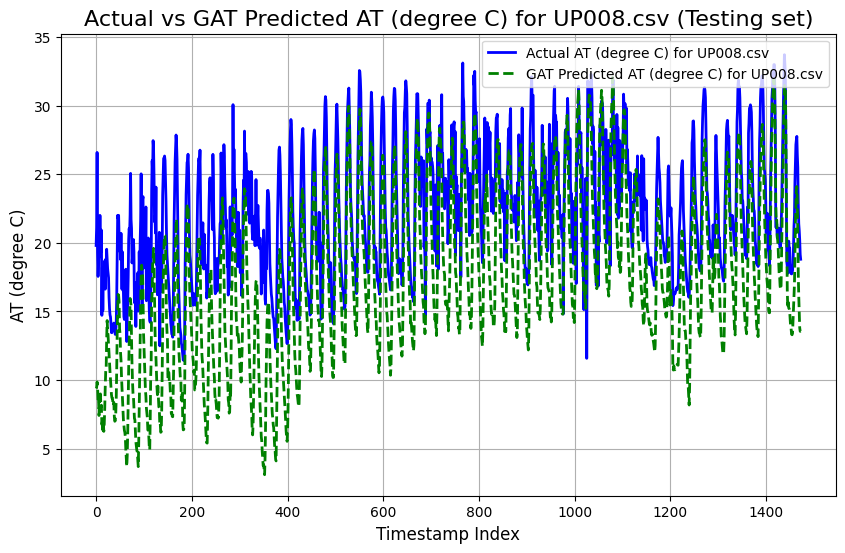

UP009.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8003
Mean Squared Error (MSE): 1.3153
Root Mean Squared Error (RMSE): 1.1469
Pearson Correlation Coefficient: 0.9762
R-squared (R²): 0.9376

----------------------------------------



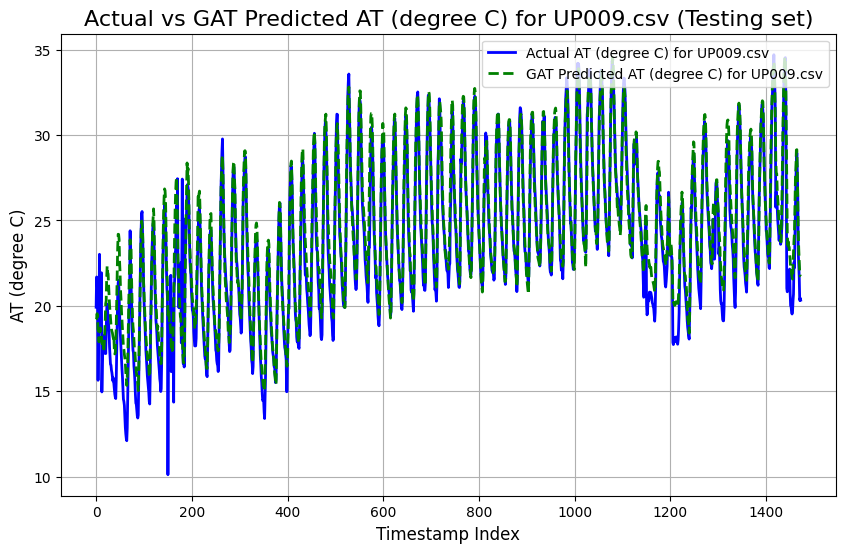

UP012.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3528
Mean Squared Error (MSE): 3.1472
Root Mean Squared Error (RMSE): 1.7740
Pearson Correlation Coefficient: 0.9647
R-squared (R²): 0.9287

----------------------------------------



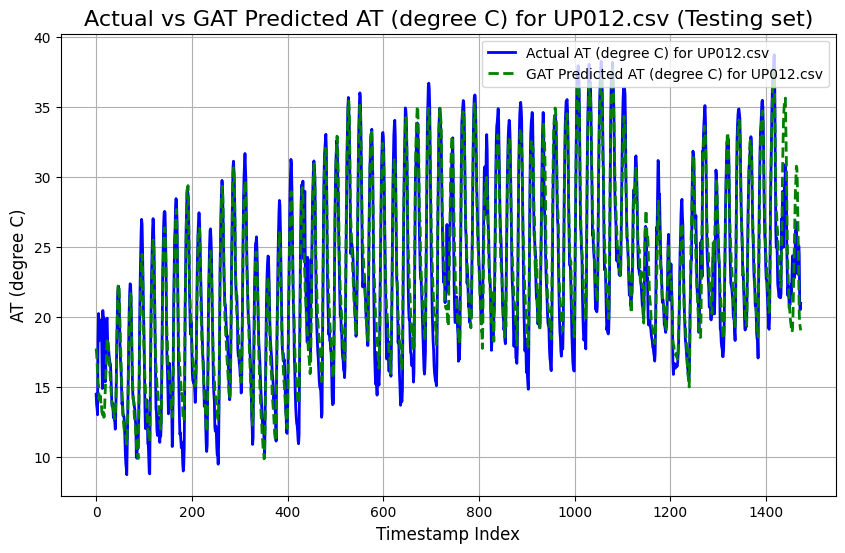

UP014.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.3180
Mean Squared Error (MSE): 31.4409
Root Mean Squared Error (RMSE): 5.6072
Pearson Correlation Coefficient: 0.9704
R-squared (R²): 0.5060

----------------------------------------



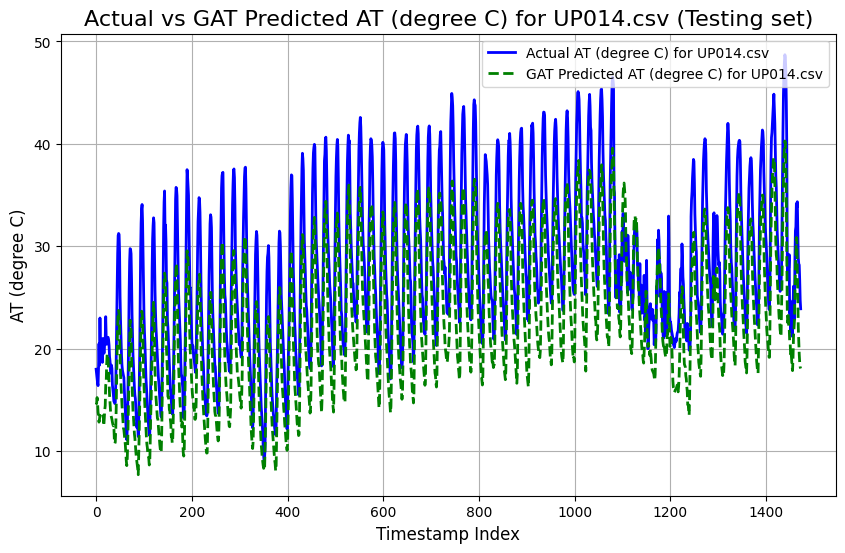

UP016.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.4511
Mean Squared Error (MSE): 21.9824
Root Mean Squared Error (RMSE): 4.6885
Pearson Correlation Coefficient: 0.9798
R-squared (R²): 0.6442

----------------------------------------



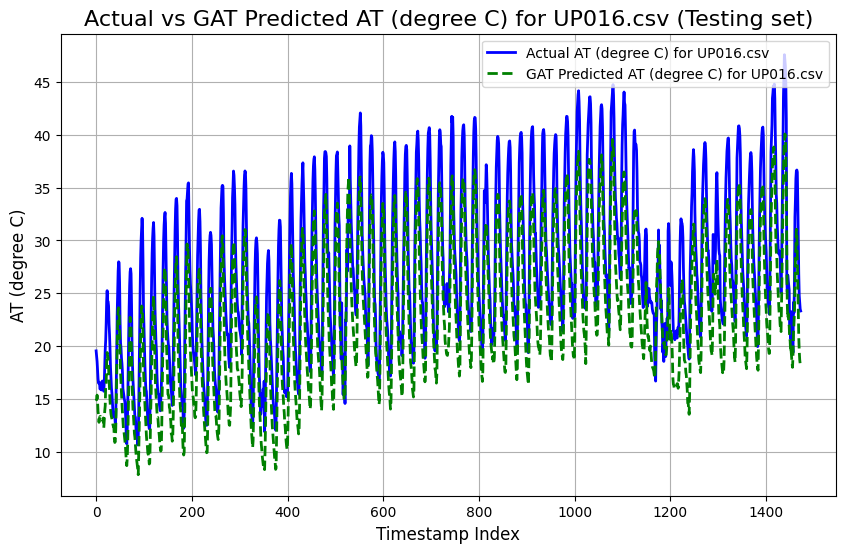

UP017.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7682
Mean Squared Error (MSE): 1.0876
Root Mean Squared Error (RMSE): 1.0429
Pearson Correlation Coefficient: 0.9685
R-squared (R²): 0.9196

----------------------------------------



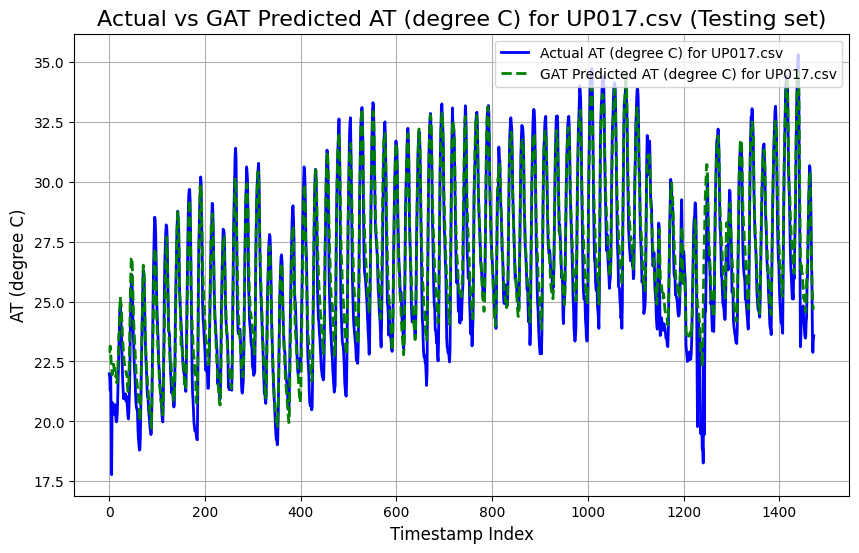

UP018.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 8.1839
Mean Squared Error (MSE): 104.8549
Root Mean Squared Error (RMSE): 10.2399
Pearson Correlation Coefficient: -0.6687
R-squared (R²): -2.8667

----------------------------------------



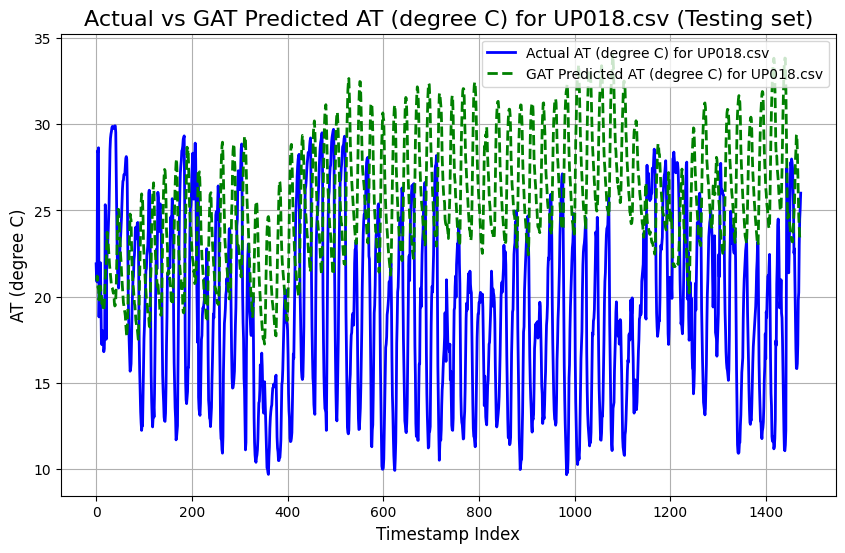

UP019.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.7432
Mean Squared Error (MSE): 3.7067
Root Mean Squared Error (RMSE): 1.9253
Pearson Correlation Coefficient: 0.9590
R-squared (R²): 0.7797

----------------------------------------



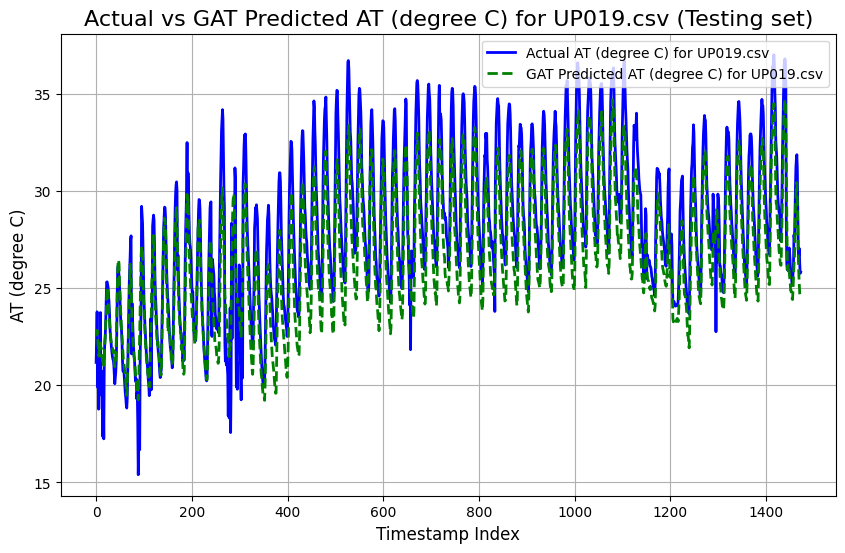

UP020.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8584
Mean Squared Error (MSE): 1.2823
Root Mean Squared Error (RMSE): 1.1324
Pearson Correlation Coefficient: 0.9785
R-squared (R²): 0.9362

----------------------------------------



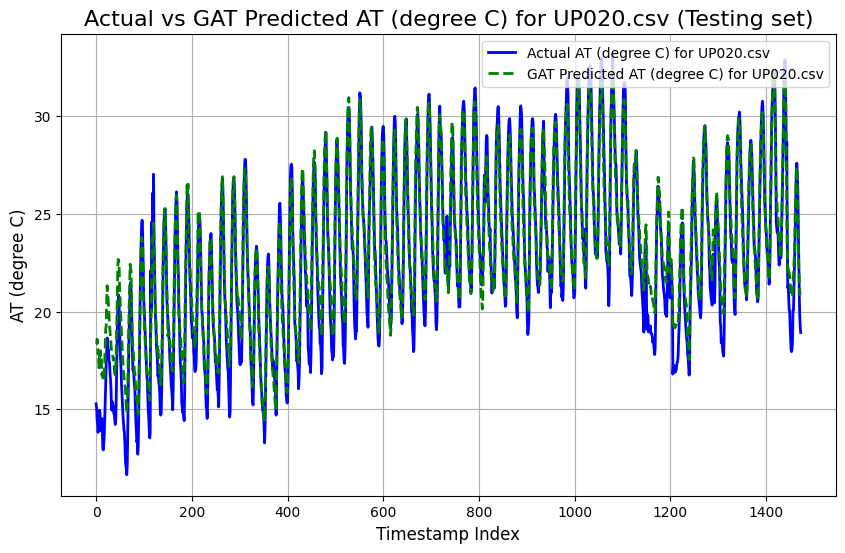

UP021.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.8112
Mean Squared Error (MSE): 12.2507
Root Mean Squared Error (RMSE): 3.5001
Pearson Correlation Coefficient: 0.8836
R-squared (R²): 0.3478

----------------------------------------



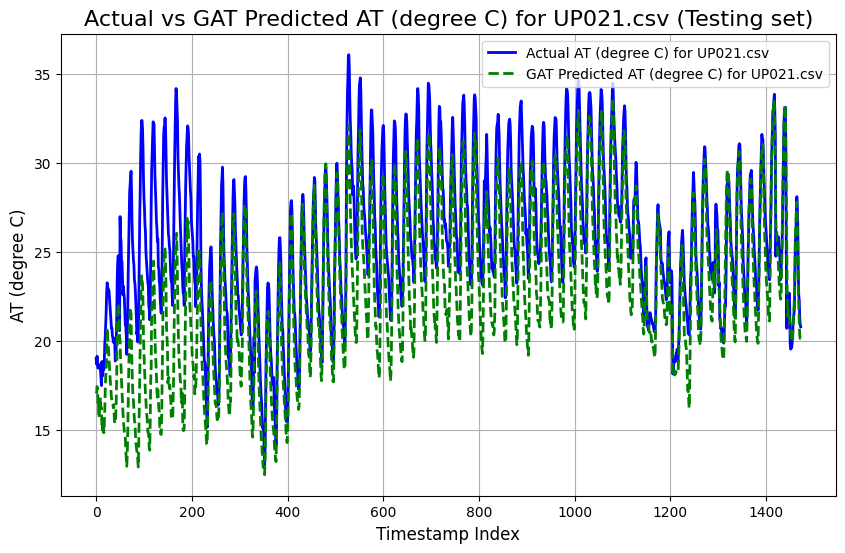

UP022.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8363
Mean Squared Error (MSE): 1.2605
Root Mean Squared Error (RMSE): 1.1227
Pearson Correlation Coefficient: 0.9800
R-squared (R²): 0.9354

----------------------------------------



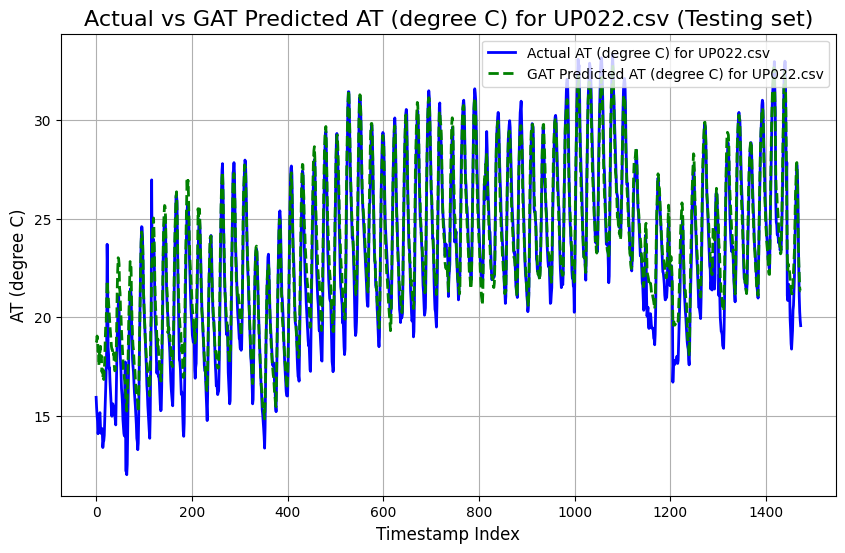

UP023.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.7040
Mean Squared Error (MSE): 3.7170
Root Mean Squared Error (RMSE): 1.9279
Pearson Correlation Coefficient: 0.9785
R-squared (R²): 0.7892

----------------------------------------



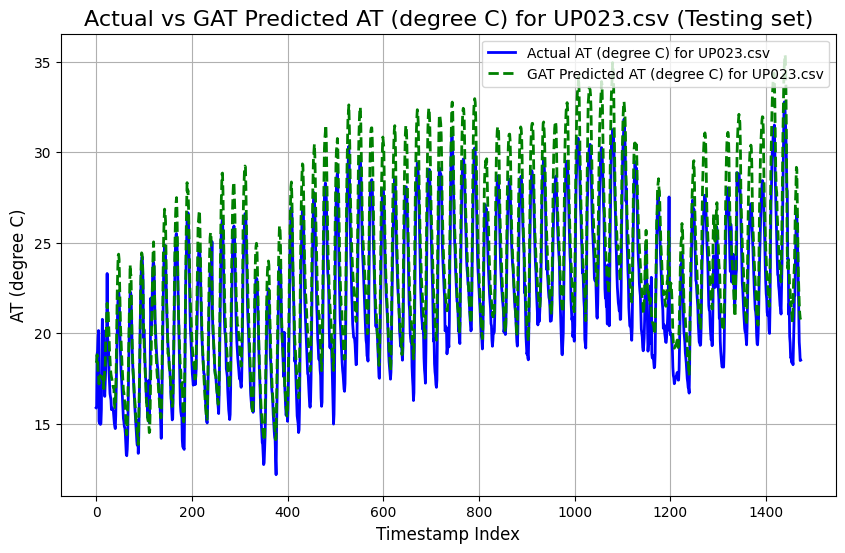

UP024.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.3953
Mean Squared Error (MSE): 16.0055
Root Mean Squared Error (RMSE): 4.0007
Pearson Correlation Coefficient: 0.9604
R-squared (R²): -0.7855

----------------------------------------



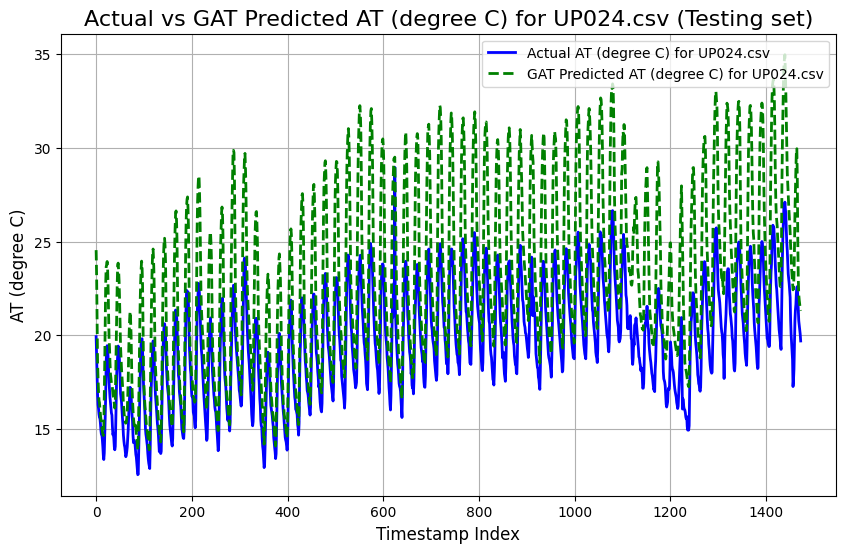

UP025.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8236
Mean Squared Error (MSE): 1.2090
Root Mean Squared Error (RMSE): 1.0995
Pearson Correlation Coefficient: 0.9806
R-squared (R²): 0.9508

----------------------------------------



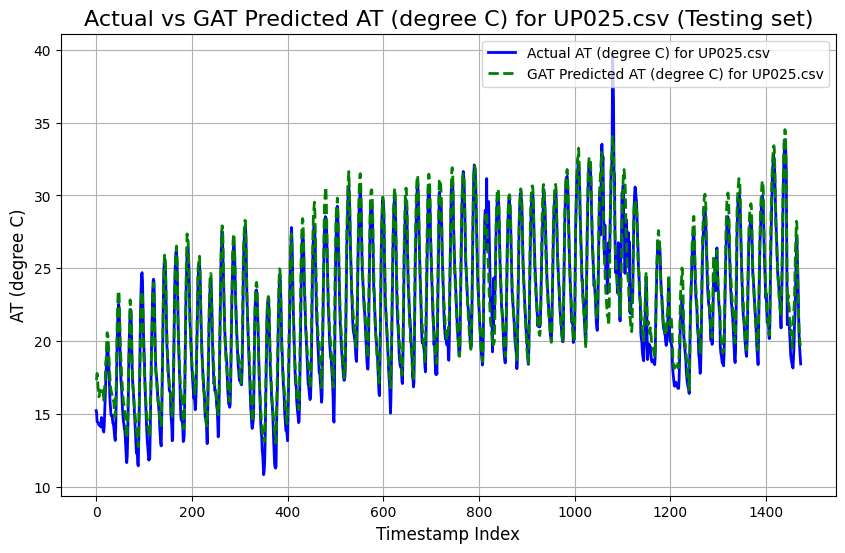

UP026.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4135
Mean Squared Error (MSE): 2.7870
Root Mean Squared Error (RMSE): 1.6694
Pearson Correlation Coefficient: 0.9694
R-squared (R²): 0.8993

----------------------------------------



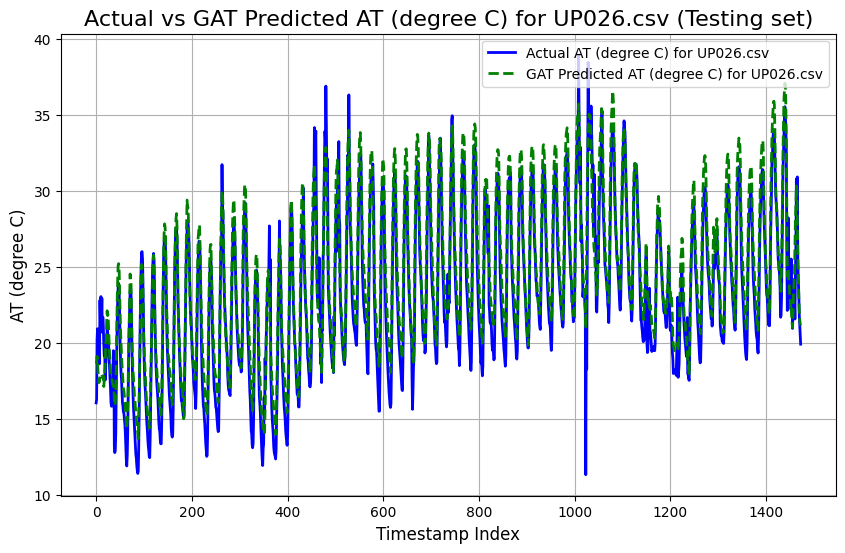

UP028.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2958
Mean Squared Error (MSE): 3.4203
Root Mean Squared Error (RMSE): 1.8494
Pearson Correlation Coefficient: 0.9750
R-squared (R²): 0.9413

----------------------------------------



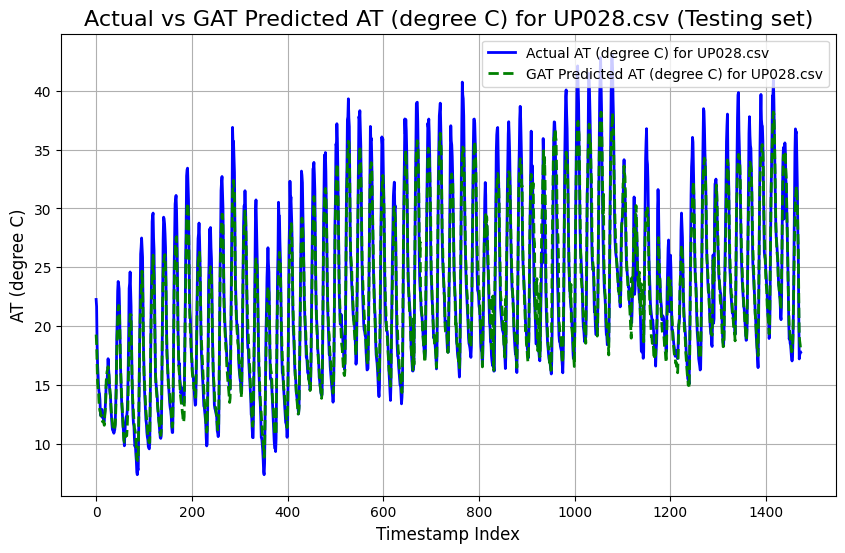

UP029.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6660
Mean Squared Error (MSE): 0.7248
Root Mean Squared Error (RMSE): 0.8514
Pearson Correlation Coefficient: 0.9915
R-squared (R²): 0.9804

----------------------------------------



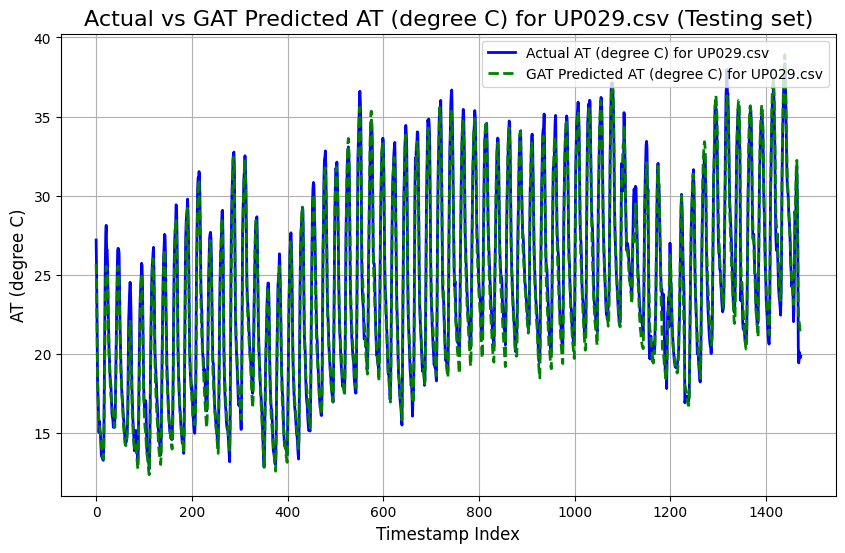

UP030.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0286
Mean Squared Error (MSE): 2.0184
Root Mean Squared Error (RMSE): 1.4207
Pearson Correlation Coefficient: 0.9791
R-squared (R²): 0.9541

----------------------------------------



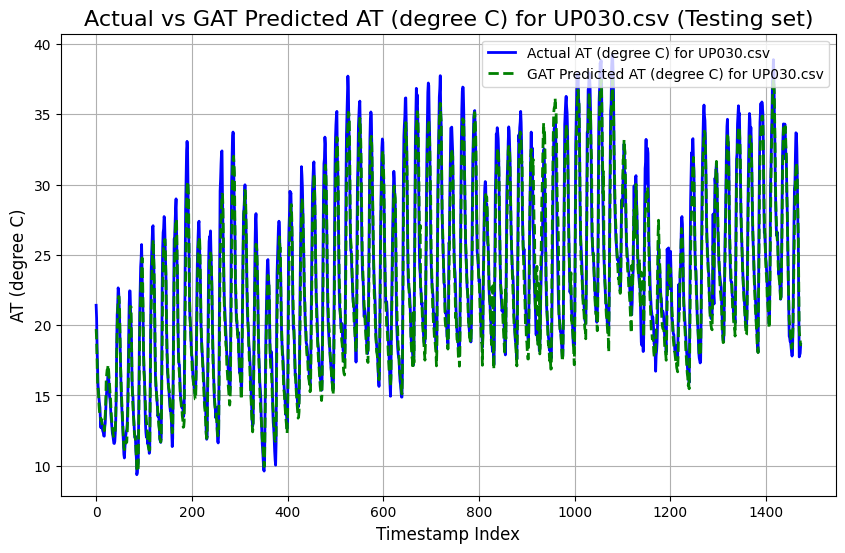

UP031.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4925
Mean Squared Error (MSE): 3.6264
Root Mean Squared Error (RMSE): 1.9043
Pearson Correlation Coefficient: 0.9638
R-squared (R²): 0.9256

----------------------------------------



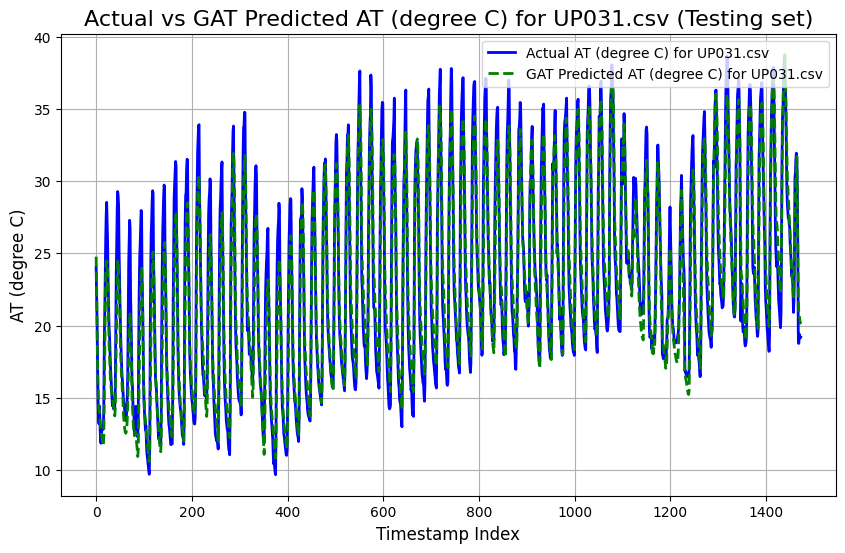

UP032.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1415
Mean Squared Error (MSE): 2.1179
Root Mean Squared Error (RMSE): 1.4553
Pearson Correlation Coefficient: 0.9688
R-squared (R²): 0.9383

----------------------------------------



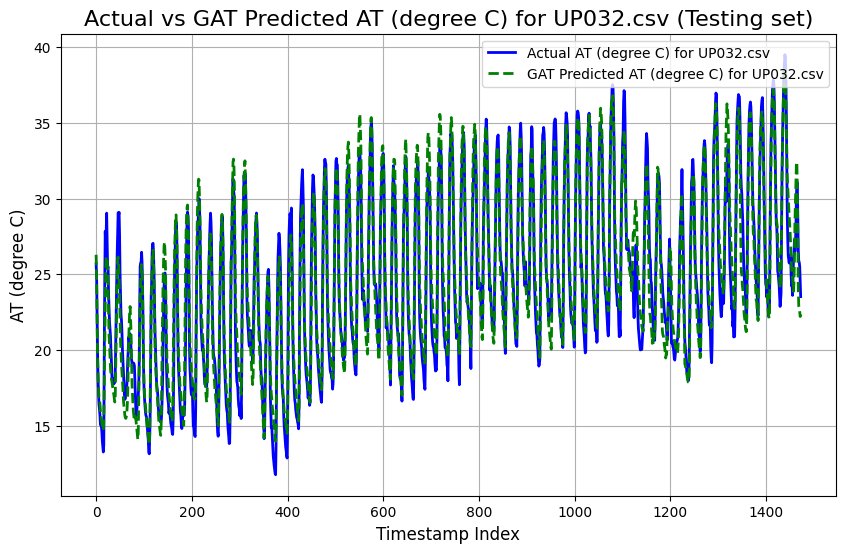

UP033.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6477
Mean Squared Error (MSE): 0.7245
Root Mean Squared Error (RMSE): 0.8512
Pearson Correlation Coefficient: 0.9907
R-squared (R²): 0.9801

----------------------------------------



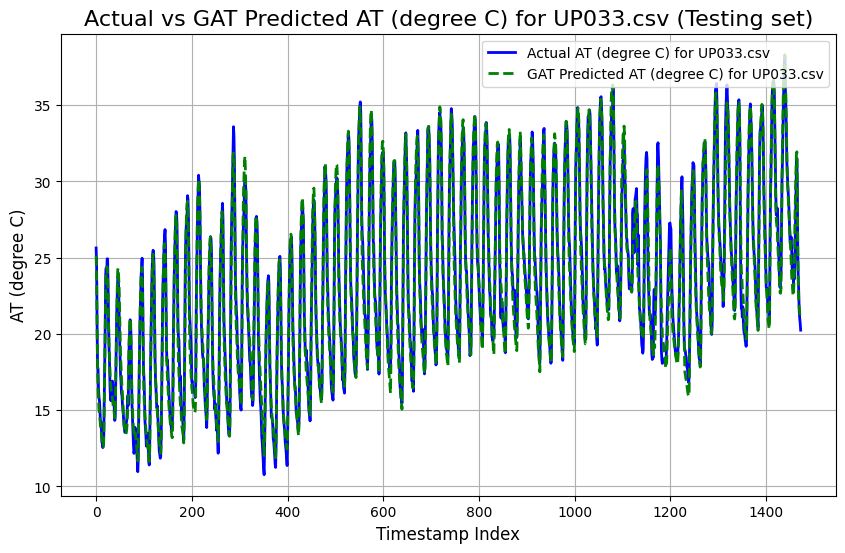

UP034.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.0009
Mean Squared Error (MSE): 25.0008
Root Mean Squared Error (RMSE): 5.0001
Pearson Correlation Coefficient: 0.8877
R-squared (R²): -0.1089

----------------------------------------



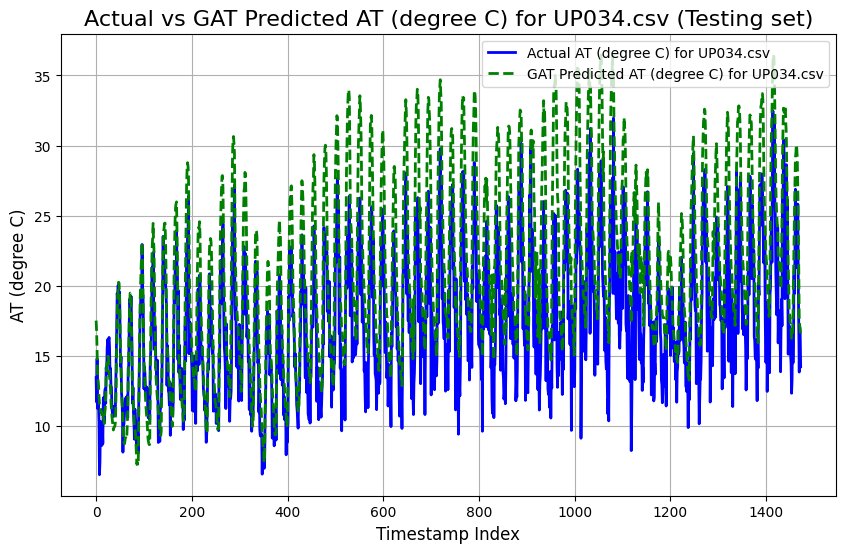

UP035.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0209
Mean Squared Error (MSE): 1.7755
Root Mean Squared Error (RMSE): 1.3325
Pearson Correlation Coefficient: 0.9782
R-squared (R²): 0.9543

----------------------------------------



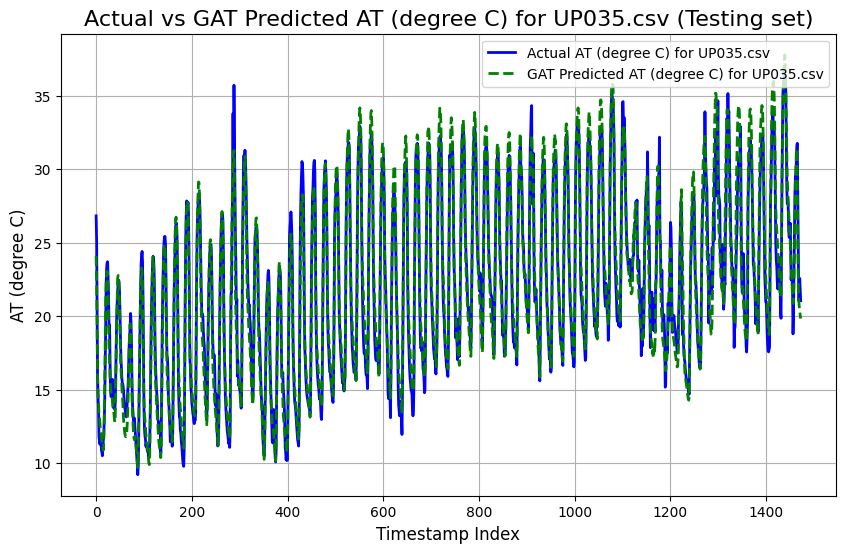

UP036.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9684
Mean Squared Error (MSE): 1.4733
Root Mean Squared Error (RMSE): 1.2138
Pearson Correlation Coefficient: 0.9805
R-squared (R²): 0.9569

----------------------------------------



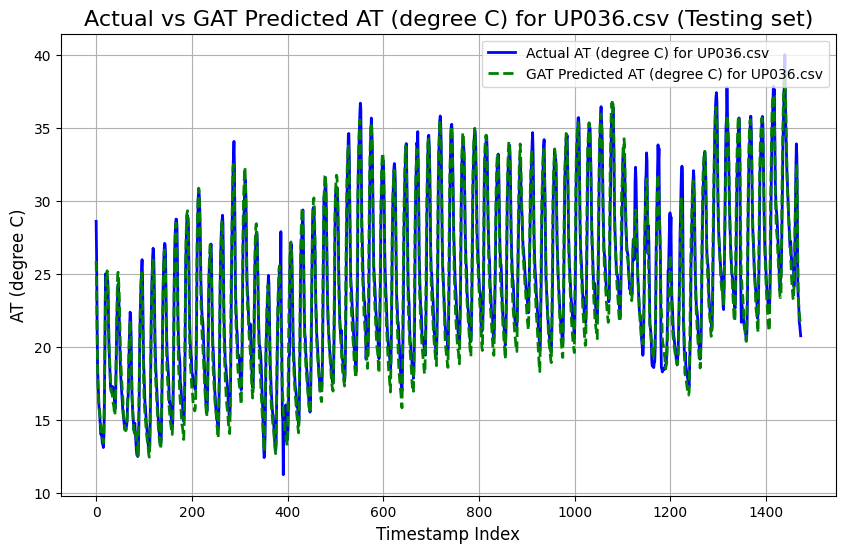

UP037.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0328
Mean Squared Error (MSE): 1.9499
Root Mean Squared Error (RMSE): 1.3964
Pearson Correlation Coefficient: 0.9752
R-squared (R²): 0.9507

----------------------------------------



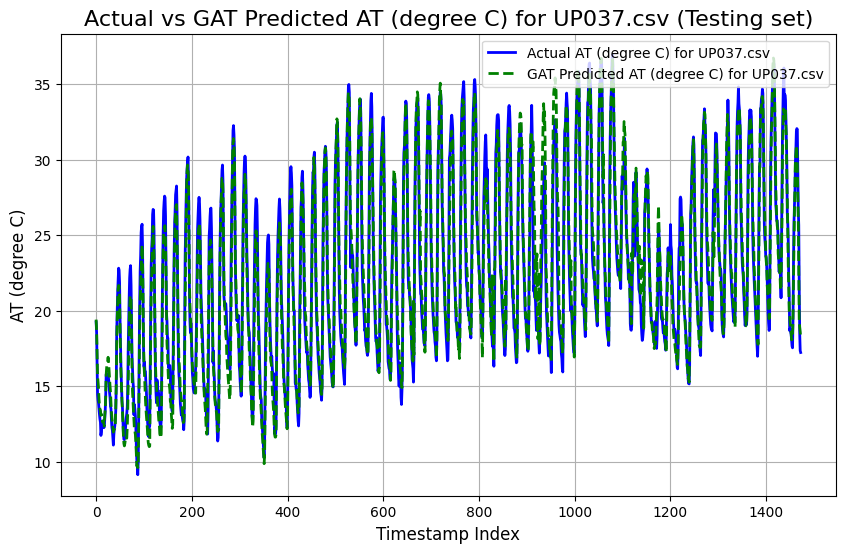

UP038.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7869
Mean Squared Error (MSE): 0.9537
Root Mean Squared Error (RMSE): 0.9766
Pearson Correlation Coefficient: 0.9893
R-squared (R²): 0.9709

----------------------------------------



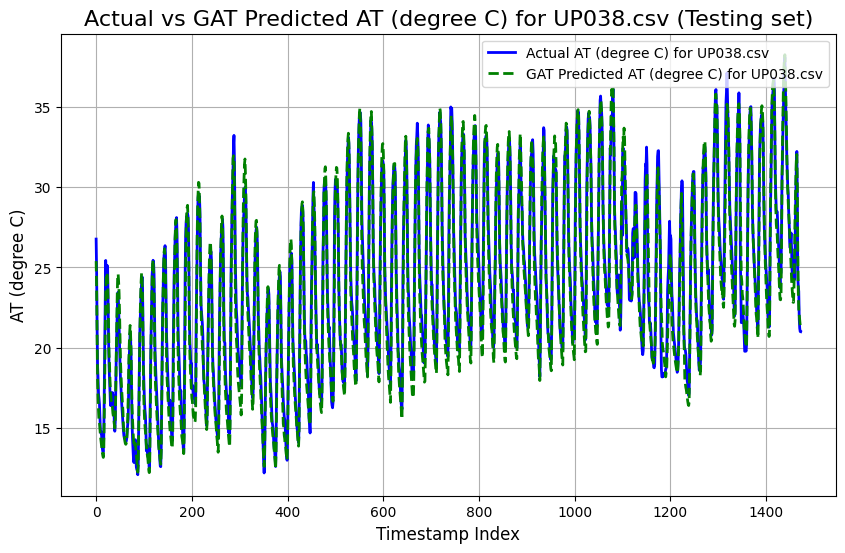

UP039.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4281
Mean Squared Error (MSE): 3.2042
Root Mean Squared Error (RMSE): 1.7900
Pearson Correlation Coefficient: 0.9703
R-squared (R²): 0.9381

----------------------------------------



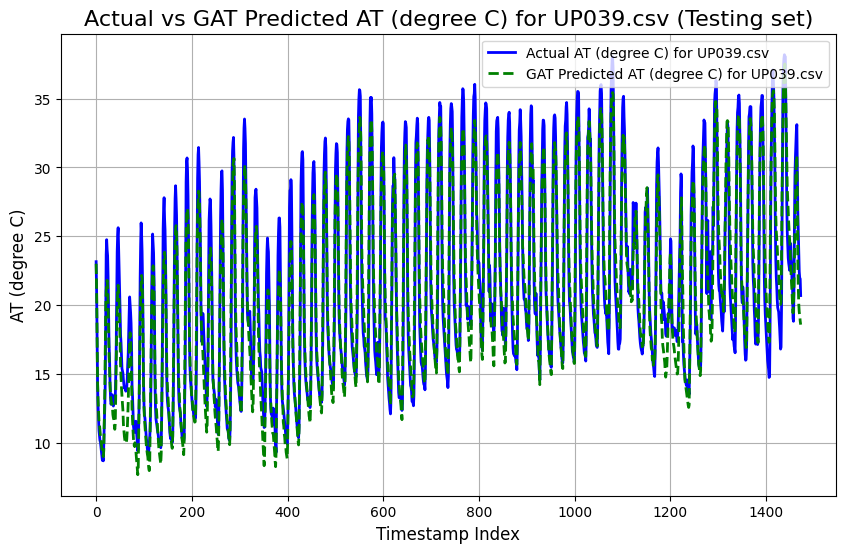

UP040.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1291
Mean Squared Error (MSE): 1.9957
Root Mean Squared Error (RMSE): 1.4127
Pearson Correlation Coefficient: 0.9779
R-squared (R²): 0.9529

----------------------------------------



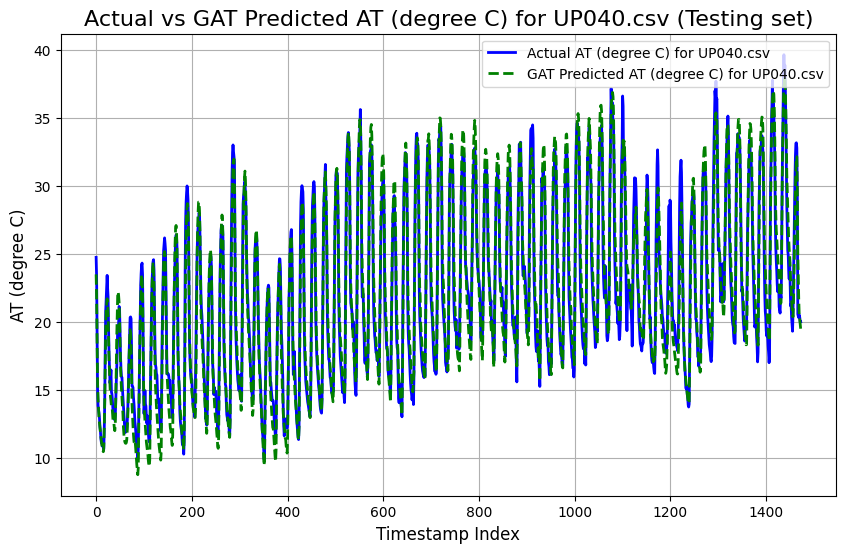

UP041.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0026
Mean Squared Error (MSE): 1.6596
Root Mean Squared Error (RMSE): 1.2882
Pearson Correlation Coefficient: 0.9777
R-squared (R²): 0.9510

----------------------------------------



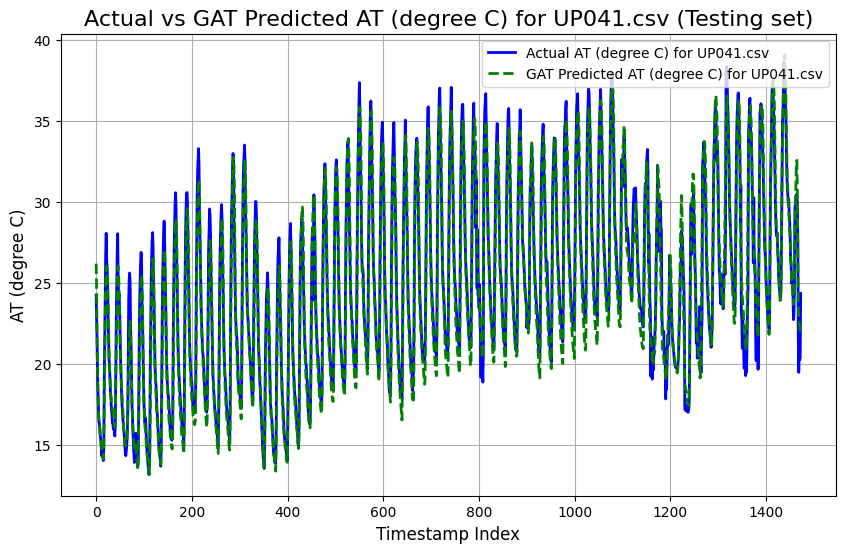

UP042.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9554
Mean Squared Error (MSE): 1.6283
Root Mean Squared Error (RMSE): 1.2761
Pearson Correlation Coefficient: 0.9760
R-squared (R²): 0.9518

----------------------------------------



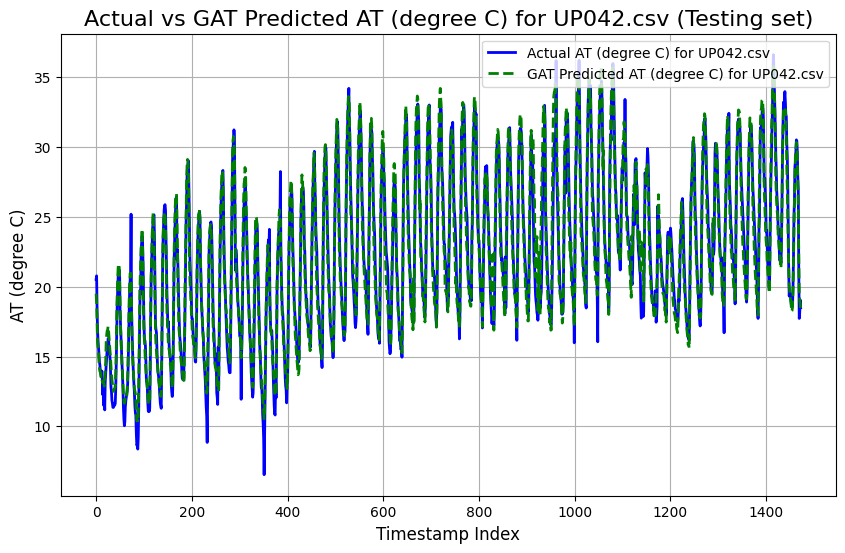

UP043.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9450
Mean Squared Error (MSE): 1.6692
Root Mean Squared Error (RMSE): 1.2920
Pearson Correlation Coefficient: 0.9800
R-squared (R²): 0.9544

----------------------------------------



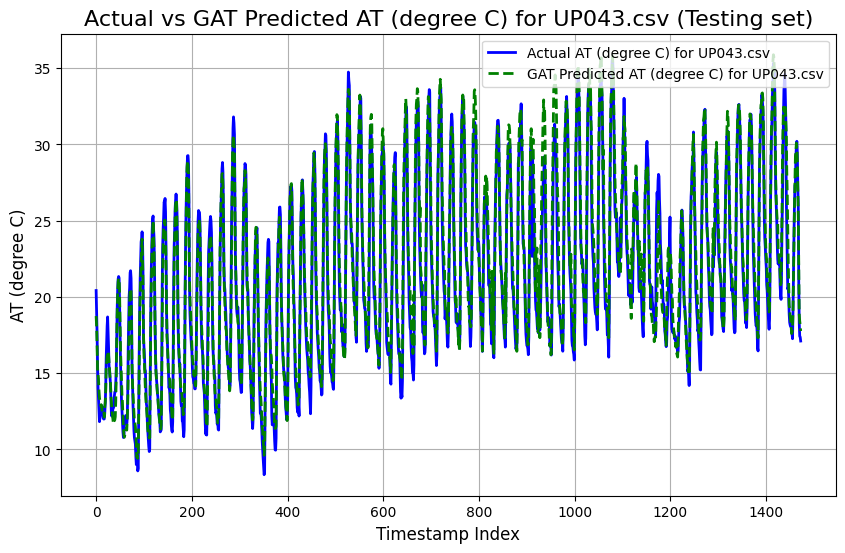

UP044.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8884
Mean Squared Error (MSE): 1.4456
Root Mean Squared Error (RMSE): 1.2023
Pearson Correlation Coefficient: 0.9868
R-squared (R²): 0.9672

----------------------------------------



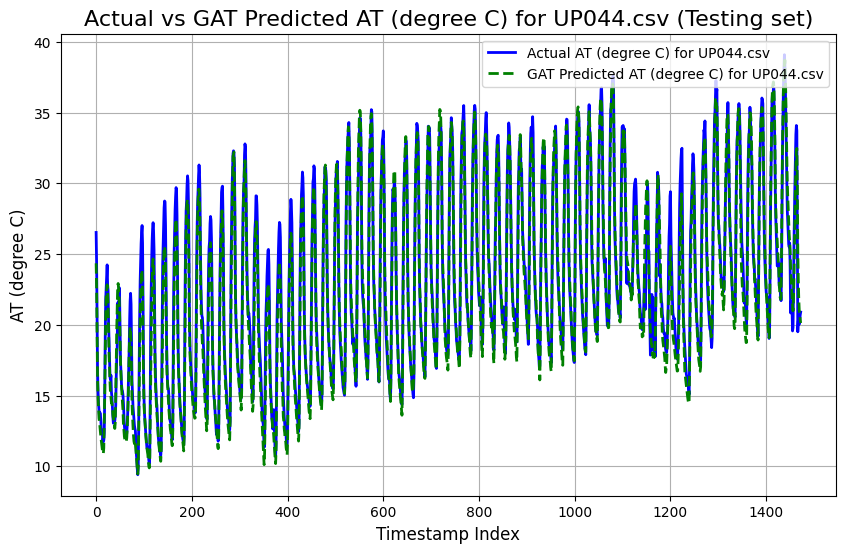

UP046.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2525
Mean Squared Error (MSE): 2.3232
Root Mean Squared Error (RMSE): 1.5242
Pearson Correlation Coefficient: 0.9749
R-squared (R²): 0.9344

----------------------------------------



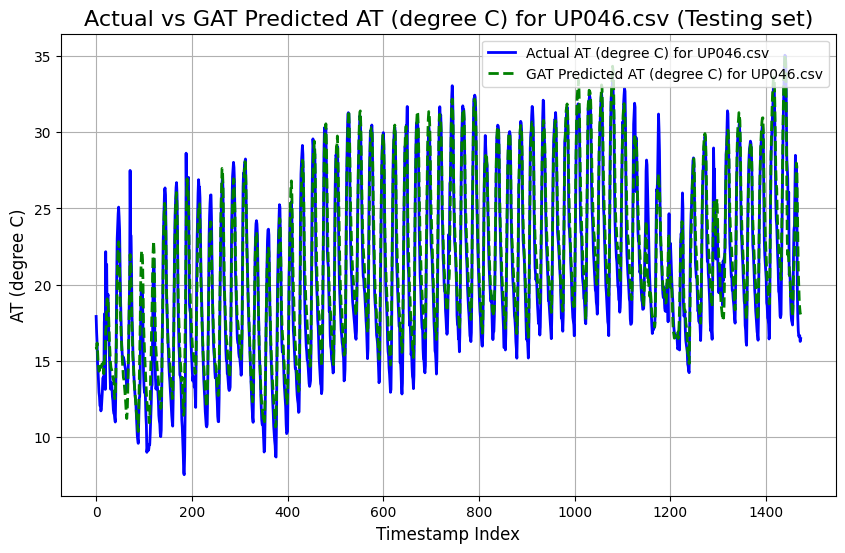

UP048.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4310
Mean Squared Error (MSE): 3.3960
Root Mean Squared Error (RMSE): 1.8428
Pearson Correlation Coefficient: 0.9618
R-squared (R²): 0.9080

----------------------------------------



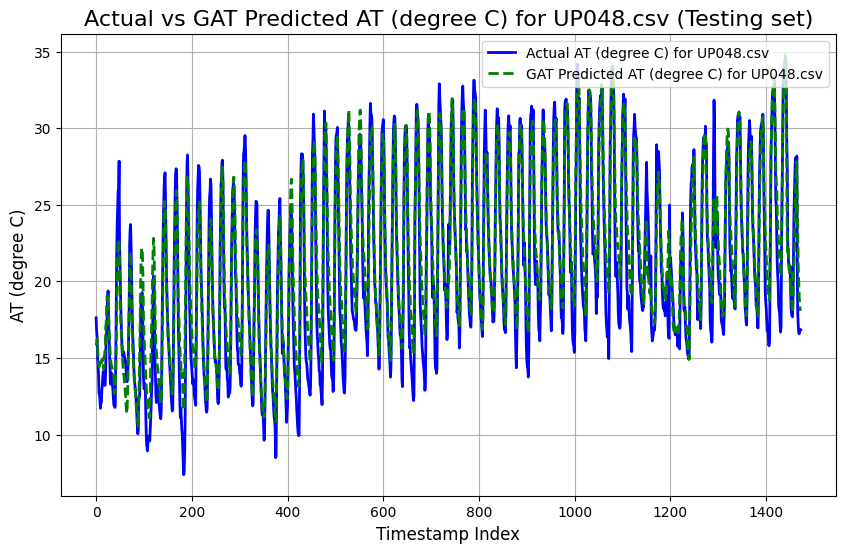

UP049.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3441
Mean Squared Error (MSE): 2.8128
Root Mean Squared Error (RMSE): 1.6771
Pearson Correlation Coefficient: 0.9655
R-squared (R²): 0.9144

----------------------------------------



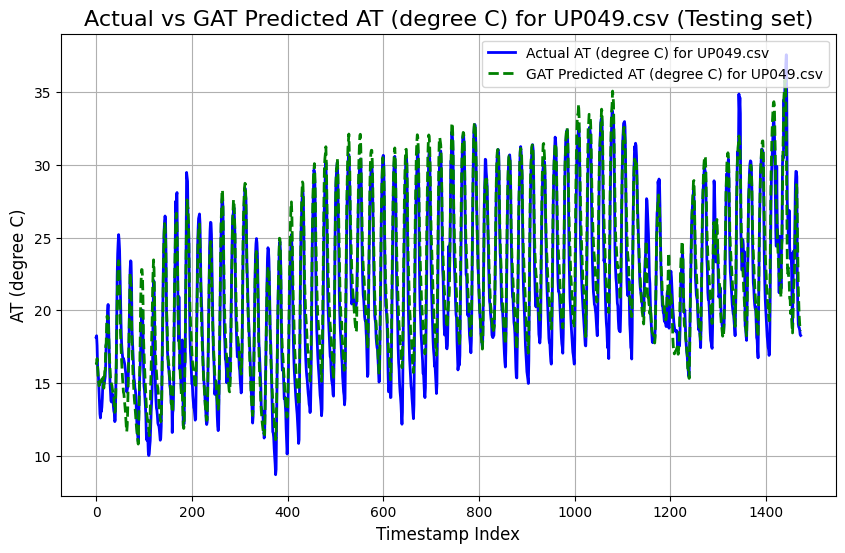

UP050.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2099
Mean Squared Error (MSE): 2.7630
Root Mean Squared Error (RMSE): 1.6622
Pearson Correlation Coefficient: 0.9514
R-squared (R²): 0.8907

----------------------------------------



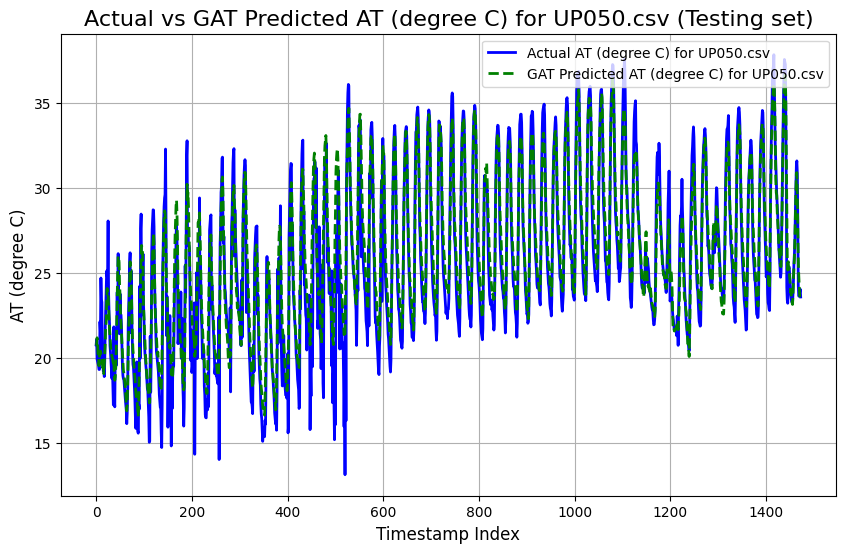

UP051.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.1686
Mean Squared Error (MSE): 41.8697
Root Mean Squared Error (RMSE): 6.4707
Pearson Correlation Coefficient: 0.6396
R-squared (R²): 0.3849

----------------------------------------



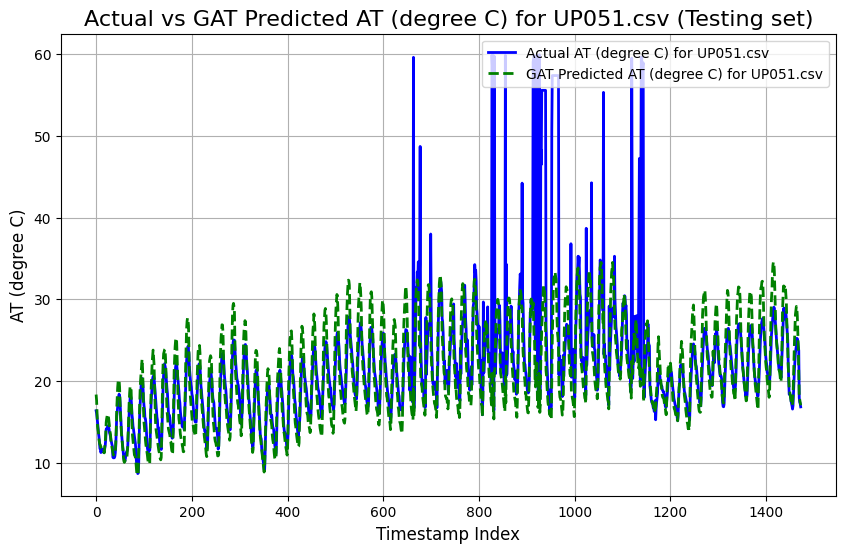

UP052.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3826
Mean Squared Error (MSE): 3.1897
Root Mean Squared Error (RMSE): 1.7860
Pearson Correlation Coefficient: 0.9626
R-squared (R²): 0.9122

----------------------------------------



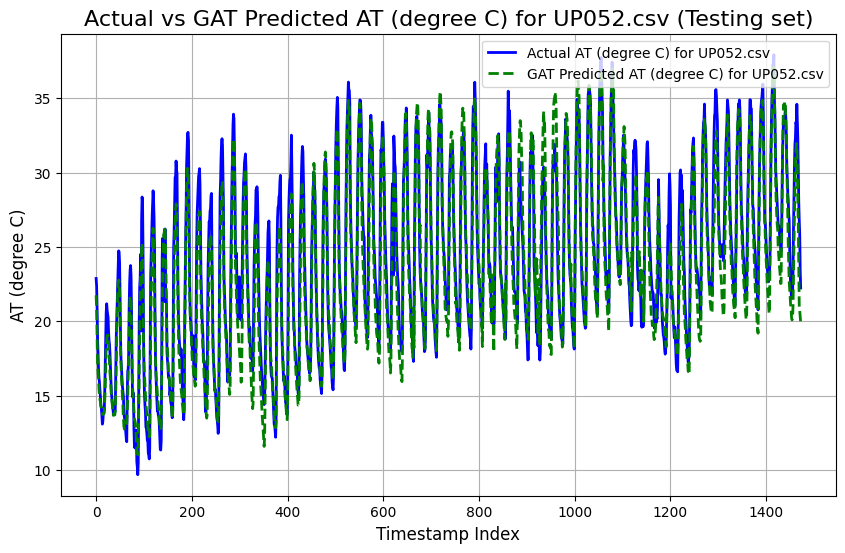

Train GNN Imputed.csv
CSV file 'Train GNN Imputed.csv' created successfully.
Test GNN Imputed.csv
CSV file 'Test GNN Imputed.csv' created successfully.
UP002.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1739
Mean Squared Error (MSE): 2.3798
Root Mean Squared Error (RMSE): 1.5427
Pearson Correlation Coefficient: 0.9820
R-squared (R²): 0.9578

----------------------------------------



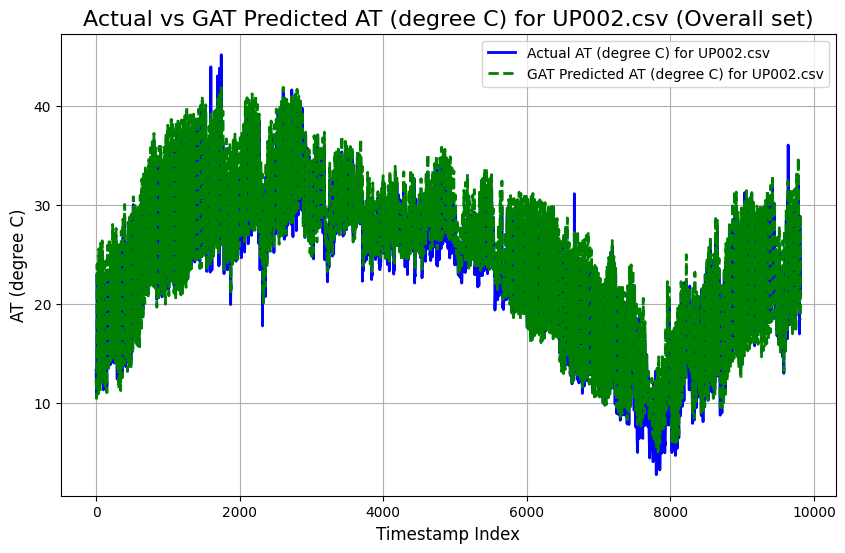

UP003.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2470
Mean Squared Error (MSE): 2.4996
Root Mean Squared Error (RMSE): 1.5810
Pearson Correlation Coefficient: 0.9858
R-squared (R²): 0.9655

----------------------------------------



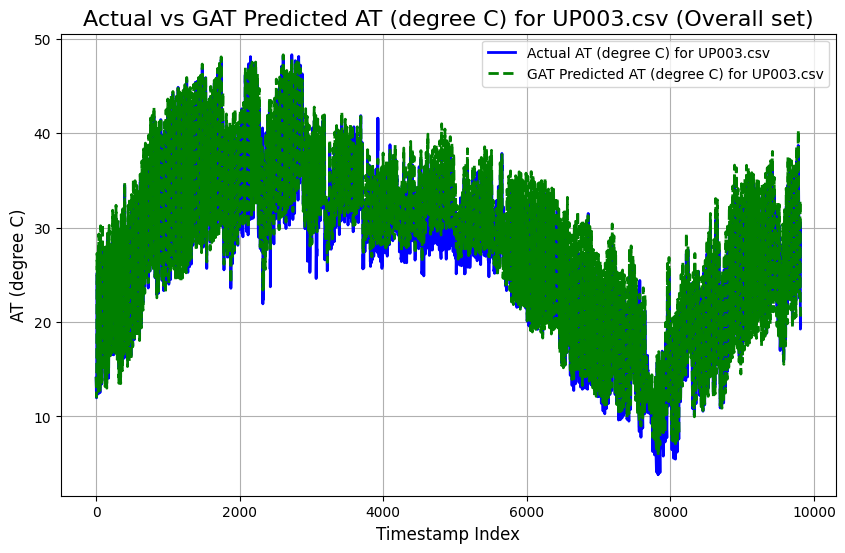

UP004.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2749
Mean Squared Error (MSE): 2.4183
Root Mean Squared Error (RMSE): 1.5551
Pearson Correlation Coefficient: 0.9876
R-squared (R²): 0.9694

----------------------------------------



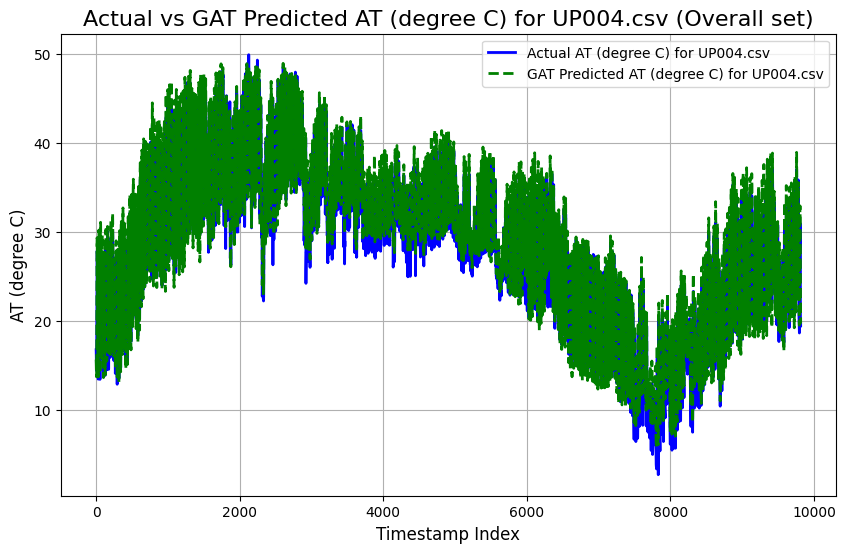

UP008.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.1785
Mean Squared Error (MSE): 52.7349
Root Mean Squared Error (RMSE): 7.2619
Pearson Correlation Coefficient: 0.8006
R-squared (R²): 0.5978

----------------------------------------



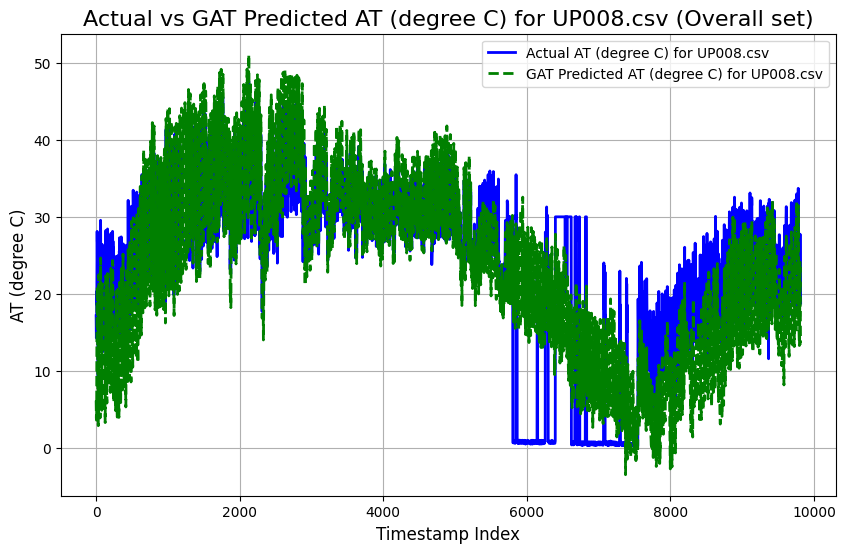

UP009.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0914
Mean Squared Error (MSE): 1.9273
Root Mean Squared Error (RMSE): 1.3883
Pearson Correlation Coefficient: 0.9857
R-squared (R²): 0.9665

----------------------------------------



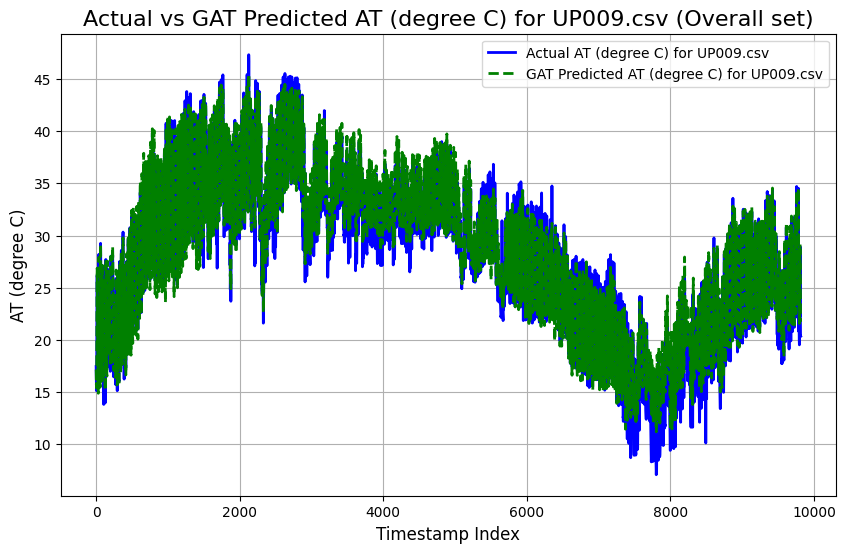

UP012.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4455
Mean Squared Error (MSE): 4.0585
Root Mean Squared Error (RMSE): 2.0146
Pearson Correlation Coefficient: 0.9821
R-squared (R²): 0.9605

----------------------------------------



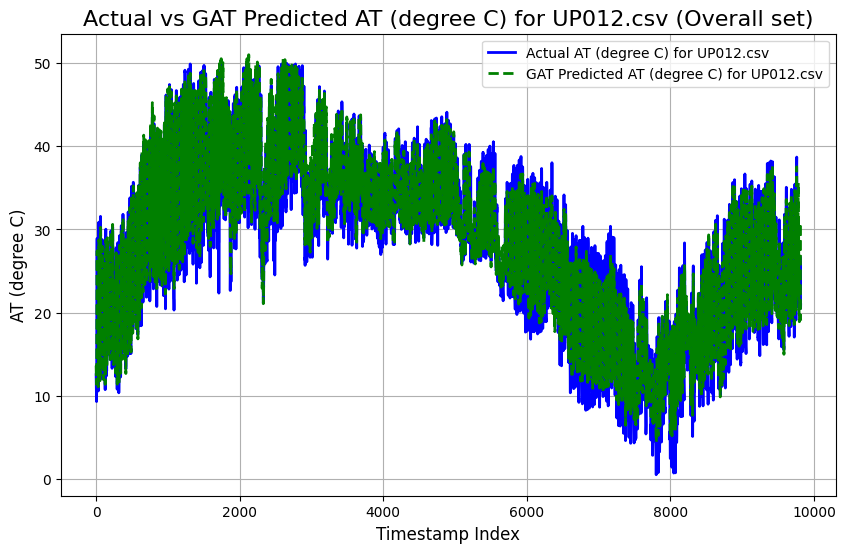

UP014.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.3056
Mean Squared Error (MSE): 15.9154
Root Mean Squared Error (RMSE): 3.9894
Pearson Correlation Coefficient: 0.9370
R-squared (R²): 0.8701

----------------------------------------



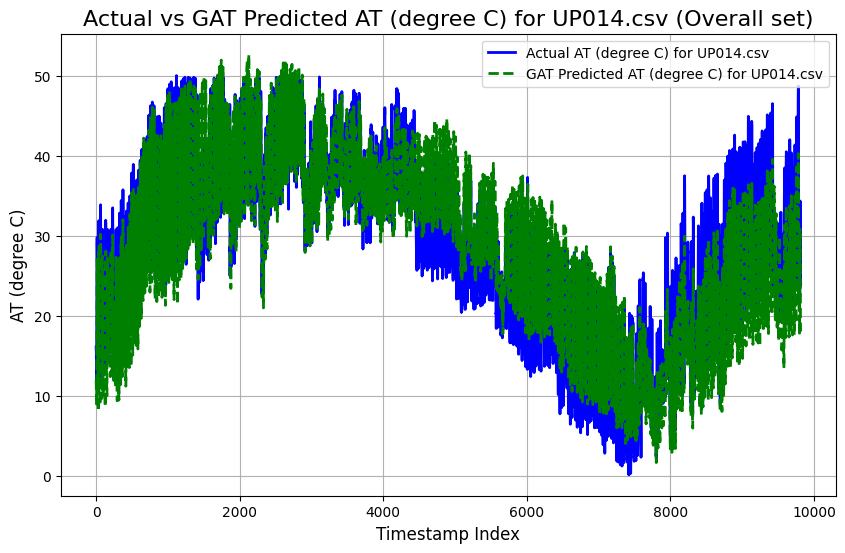

UP016.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.0300
Mean Squared Error (MSE): 13.6798
Root Mean Squared Error (RMSE): 3.6986
Pearson Correlation Coefficient: 0.9468
R-squared (R²): 0.8910

----------------------------------------



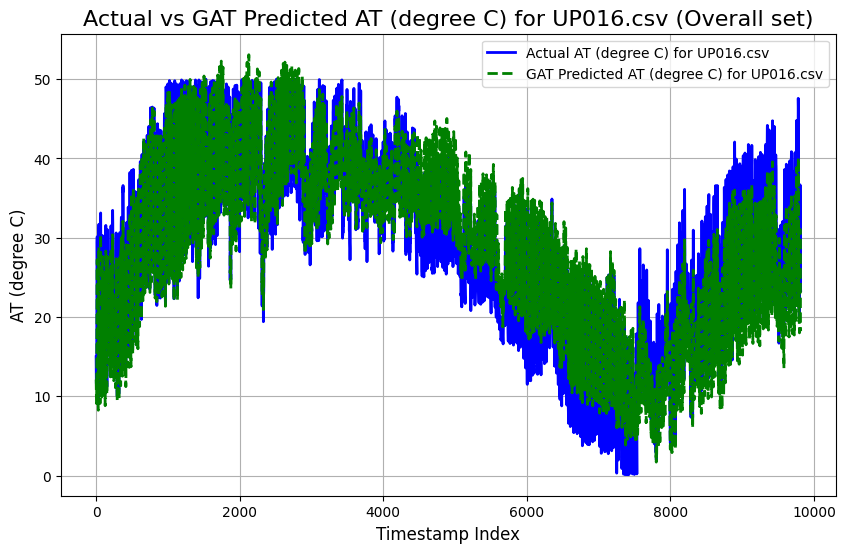

UP017.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.8791
Mean Squared Error (MSE): 1.1615
Root Mean Squared Error (RMSE): 1.0777
Pearson Correlation Coefficient: 0.9838
R-squared (R²): 0.9628

----------------------------------------



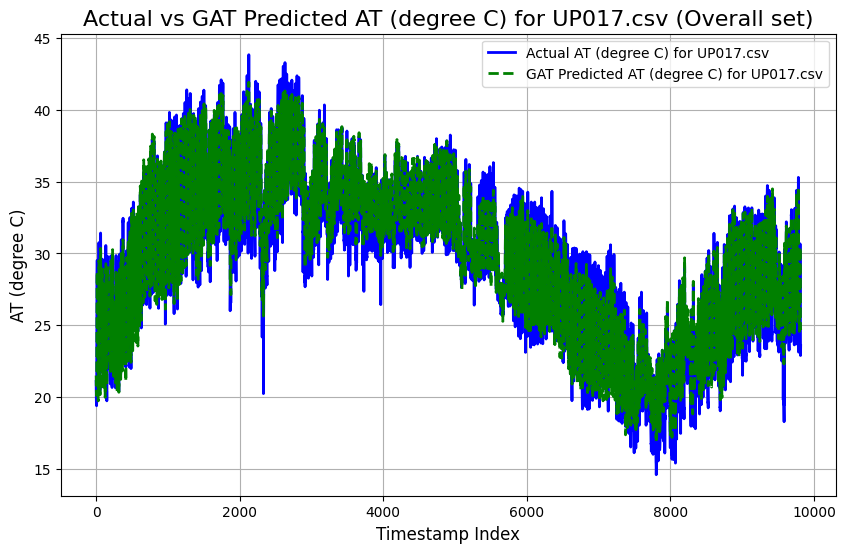

UP018.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.2081
Mean Squared Error (MSE): 52.1239
Root Mean Squared Error (RMSE): 7.2197
Pearson Correlation Coefficient: 0.5076
R-squared (R²): 0.0972

----------------------------------------



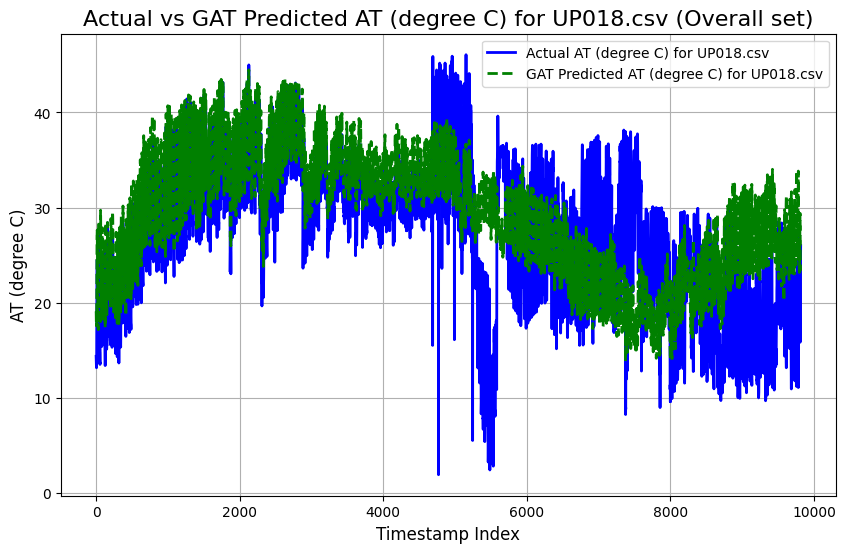

UP019.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5548
Mean Squared Error (MSE): 4.9145
Root Mean Squared Error (RMSE): 2.2169
Pearson Correlation Coefficient: 0.9307
R-squared (R²): 0.8616

----------------------------------------



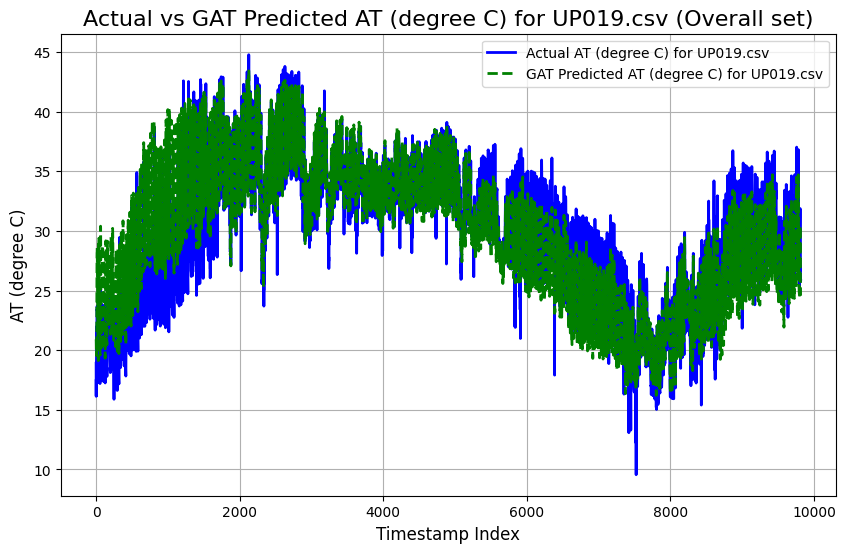

UP020.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1789
Mean Squared Error (MSE): 2.1259
Root Mean Squared Error (RMSE): 1.4581
Pearson Correlation Coefficient: 0.9824
R-squared (R²): 0.9604

----------------------------------------



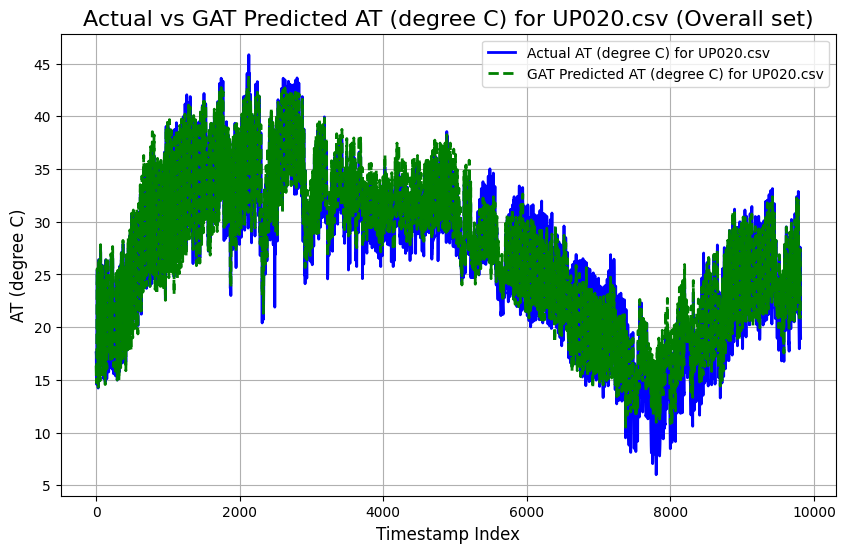

UP021.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.4881
Mean Squared Error (MSE): 20.2900
Root Mean Squared Error (RMSE): 4.5044
Pearson Correlation Coefficient: 0.8565
R-squared (R²): 0.7131

----------------------------------------



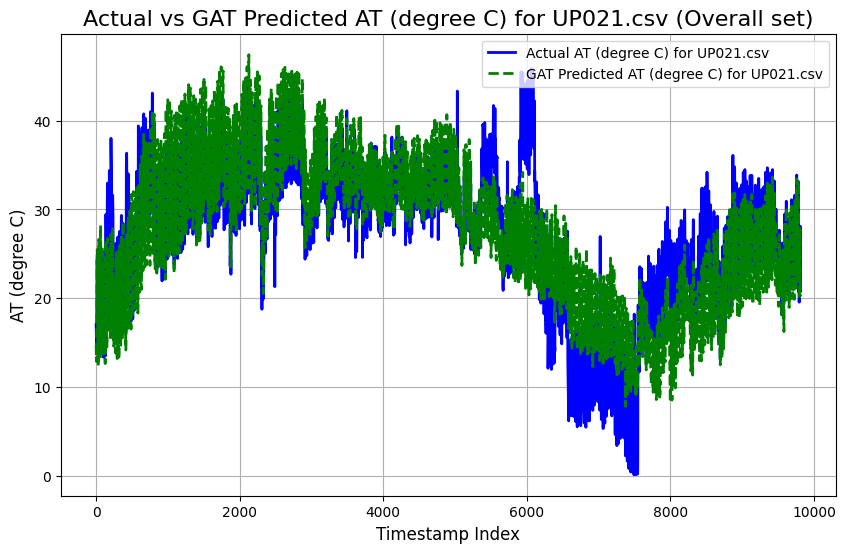

UP022.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2288
Mean Squared Error (MSE): 2.8337
Root Mean Squared Error (RMSE): 1.6834
Pearson Correlation Coefficient: 0.9760
R-squared (R²): 0.9477

----------------------------------------



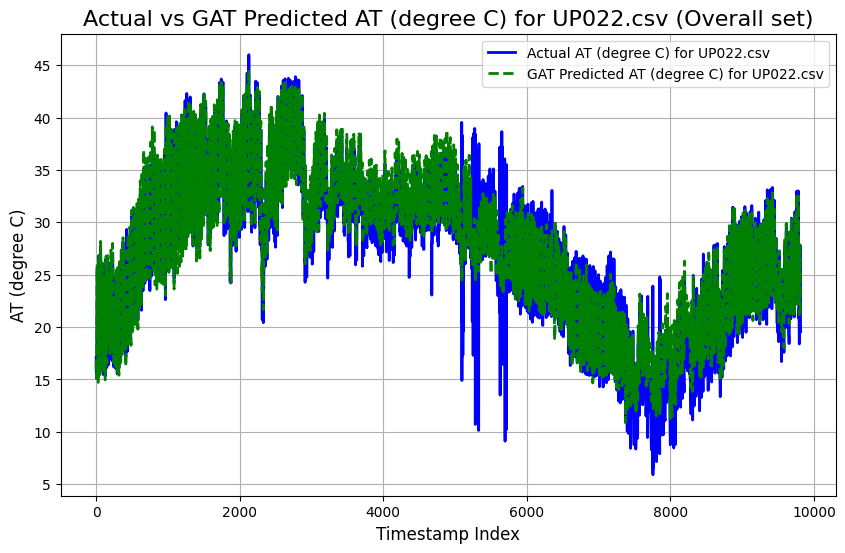

UP023.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3686
Mean Squared Error (MSE): 3.6281
Root Mean Squared Error (RMSE): 1.9048
Pearson Correlation Coefficient: 0.9727
R-squared (R²): 0.9367

----------------------------------------



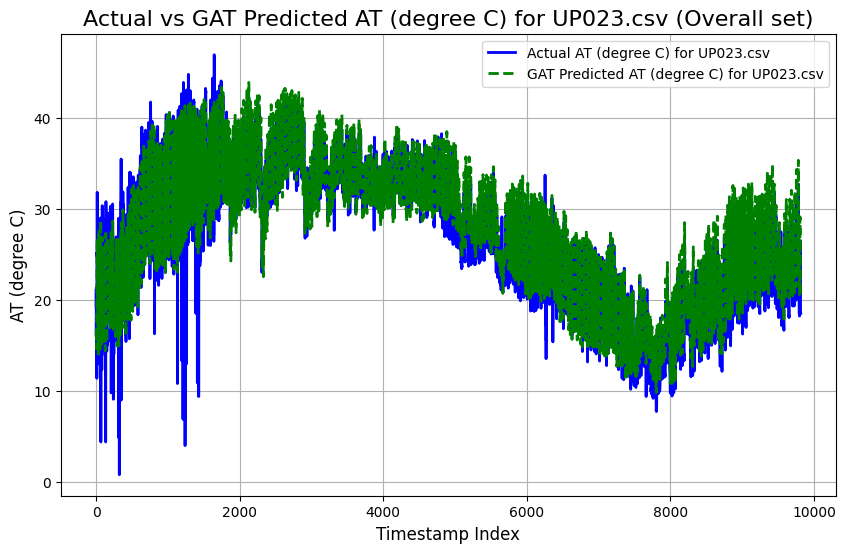

UP024.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.7857
Mean Squared Error (MSE): 13.9023
Root Mean Squared Error (RMSE): 3.7286
Pearson Correlation Coefficient: 0.8386
R-squared (R²): 0.6576

----------------------------------------



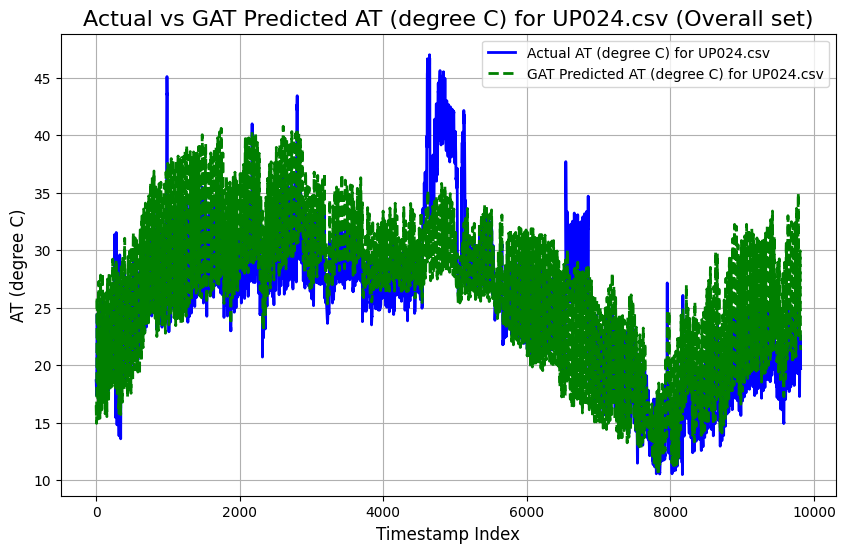

UP025.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0292
Mean Squared Error (MSE): 1.7928
Root Mean Squared Error (RMSE): 1.3390
Pearson Correlation Coefficient: 0.9869
R-squared (R²): 0.9683

----------------------------------------



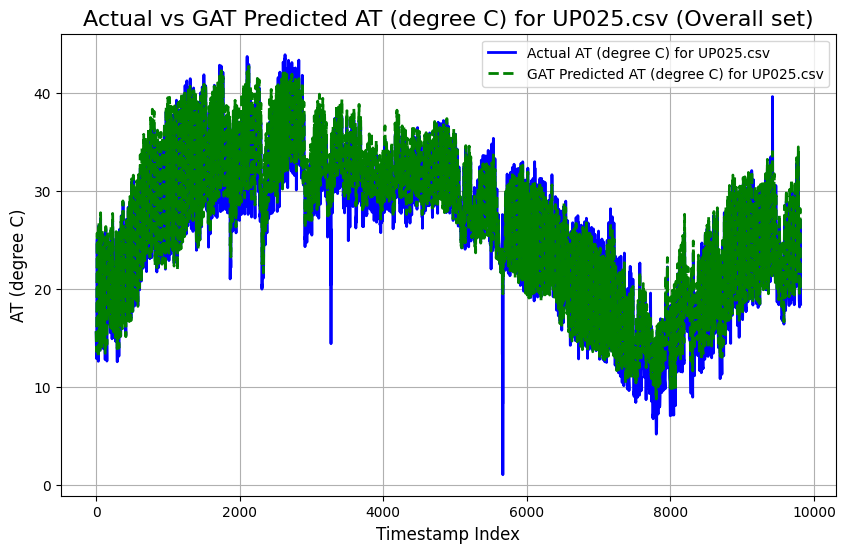

UP026.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1190
Mean Squared Error (MSE): 1.9843
Root Mean Squared Error (RMSE): 1.4086
Pearson Correlation Coefficient: 0.9882
R-squared (R²): 0.9698

----------------------------------------



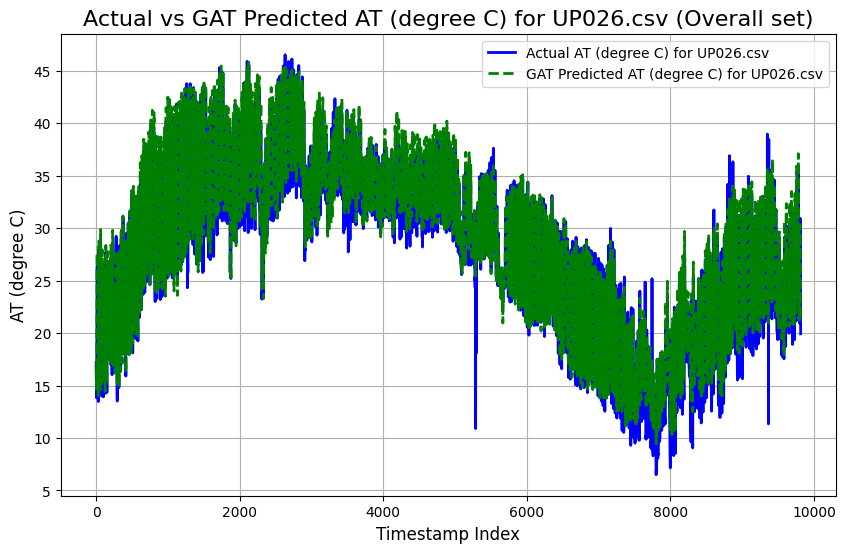

UP028.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7165
Mean Squared Error (MSE): 4.7359
Root Mean Squared Error (RMSE): 2.1762
Pearson Correlation Coefficient: 0.9759
R-squared (R²): 0.9475

----------------------------------------



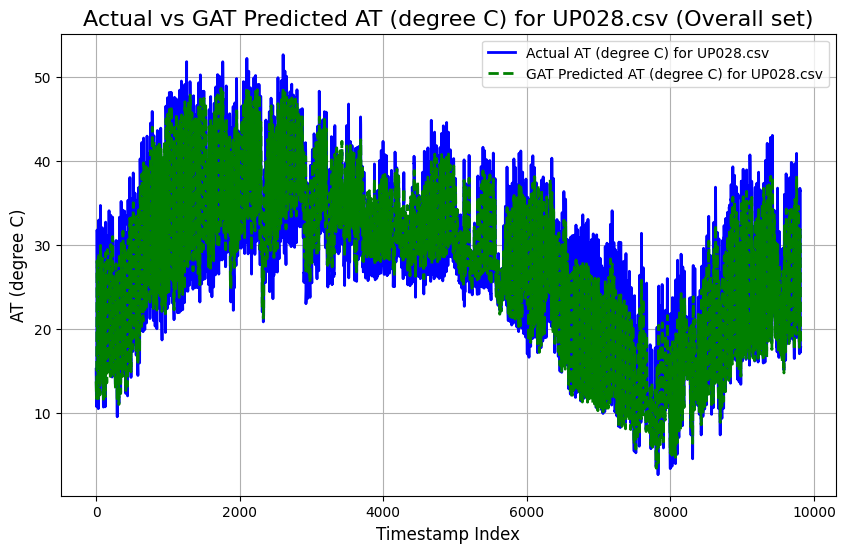

UP029.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9302
Mean Squared Error (MSE): 1.5822
Root Mean Squared Error (RMSE): 1.2578
Pearson Correlation Coefficient: 0.9890
R-squared (R²): 0.9731

----------------------------------------



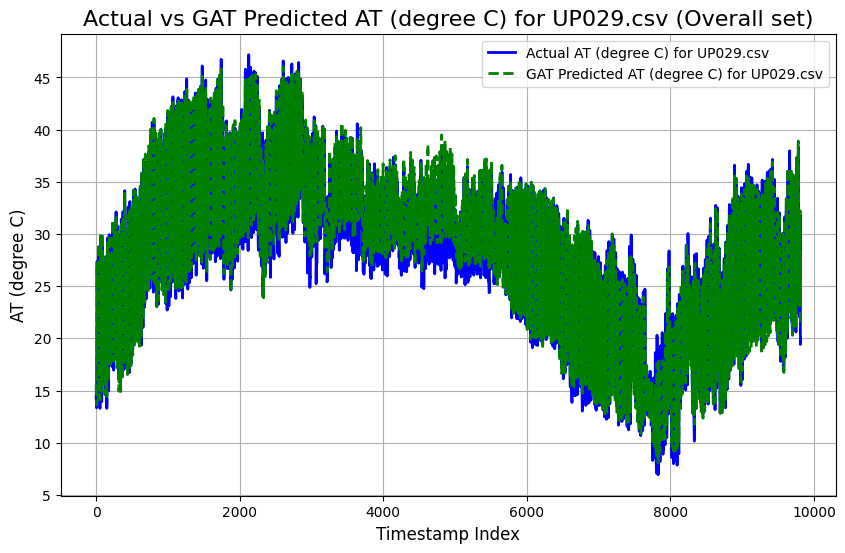

UP030.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2161
Mean Squared Error (MSE): 2.4627
Root Mean Squared Error (RMSE): 1.5693
Pearson Correlation Coefficient: 0.9864
R-squared (R²): 0.9685

----------------------------------------



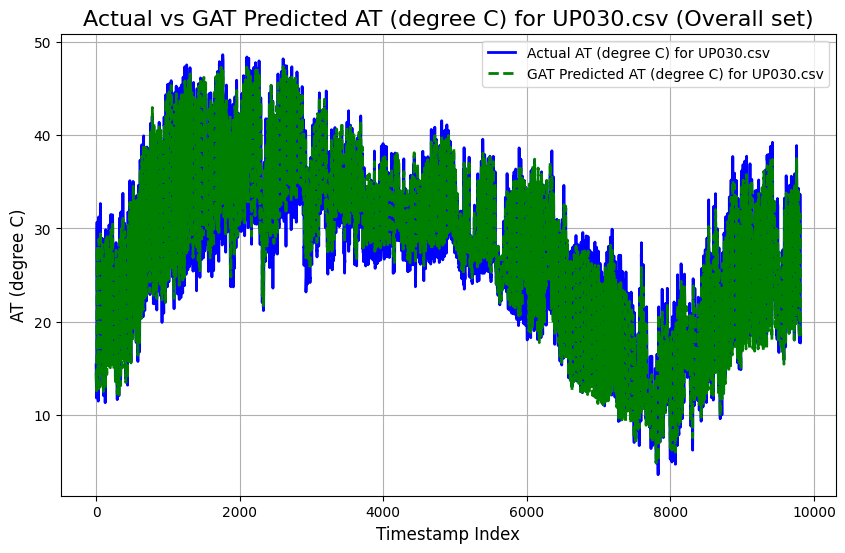

UP031.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5170
Mean Squared Error (MSE): 3.7253
Root Mean Squared Error (RMSE): 1.9301
Pearson Correlation Coefficient: 0.9748
R-squared (R²): 0.9447

----------------------------------------



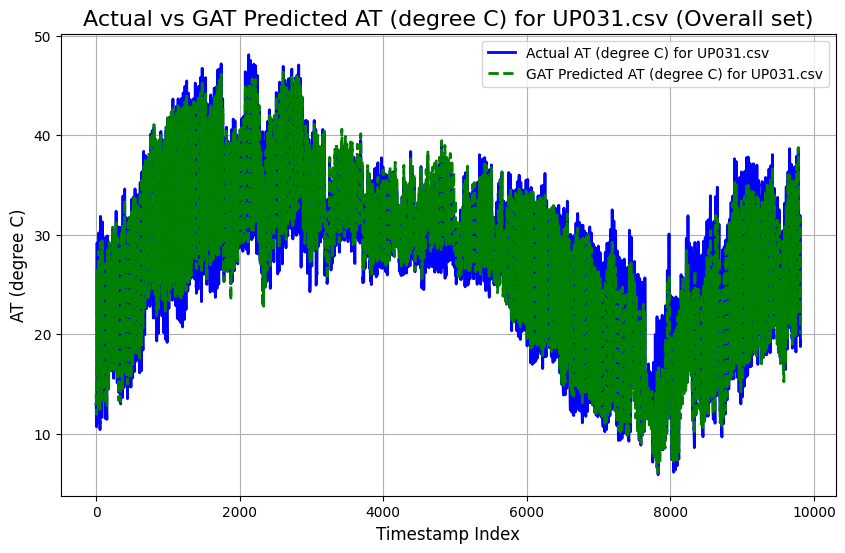

UP032.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4218
Mean Squared Error (MSE): 3.5344
Root Mean Squared Error (RMSE): 1.8800
Pearson Correlation Coefficient: 0.9695
R-squared (R²): 0.9326

----------------------------------------



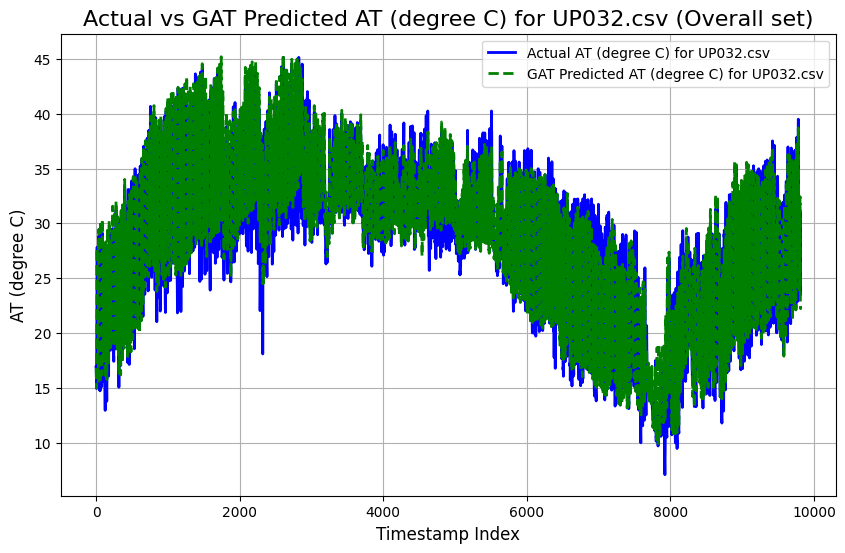

UP033.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9059
Mean Squared Error (MSE): 1.4836
Root Mean Squared Error (RMSE): 1.2180
Pearson Correlation Coefficient: 0.9903
R-squared (R²): 0.9757

----------------------------------------



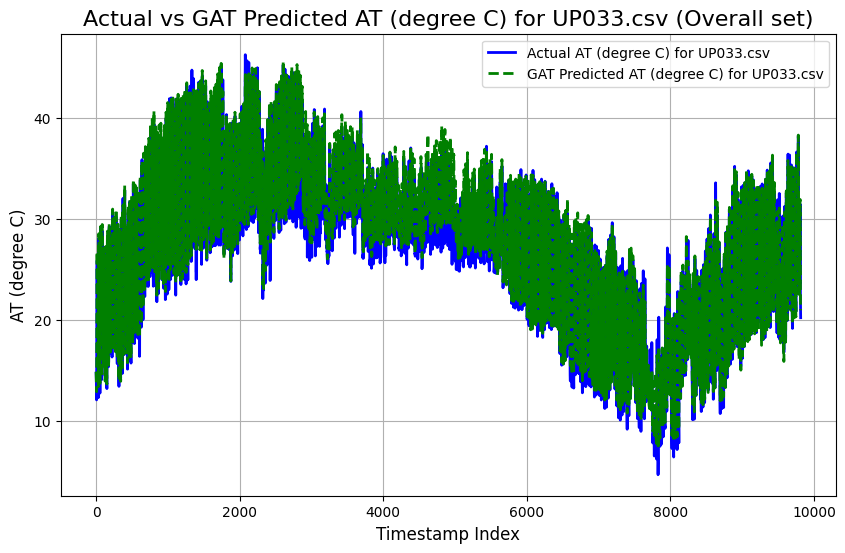

UP034.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.8277
Mean Squared Error (MSE): 7.5391
Root Mean Squared Error (RMSE): 2.7457
Pearson Correlation Coefficient: 0.9660
R-squared (R²): 0.9170

----------------------------------------



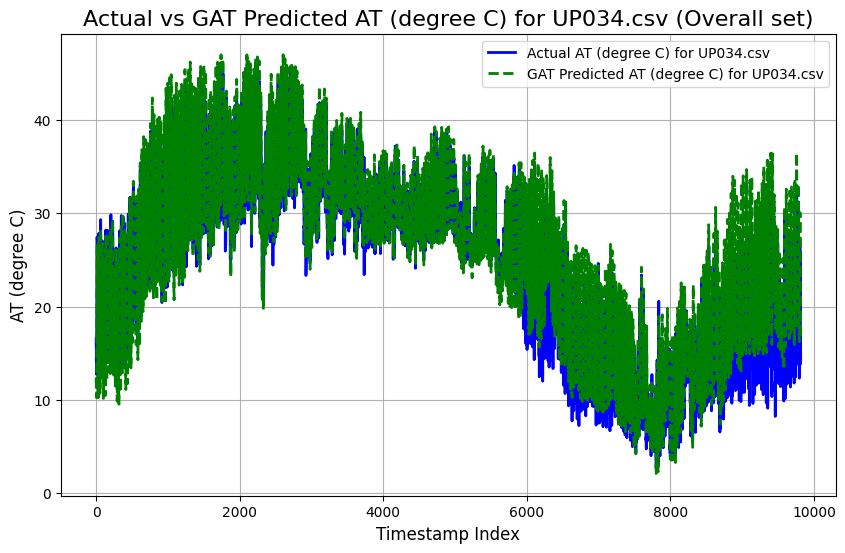

UP035.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0662
Mean Squared Error (MSE): 1.8910
Root Mean Squared Error (RMSE): 1.3751
Pearson Correlation Coefficient: 0.9888
R-squared (R²): 0.9720

----------------------------------------



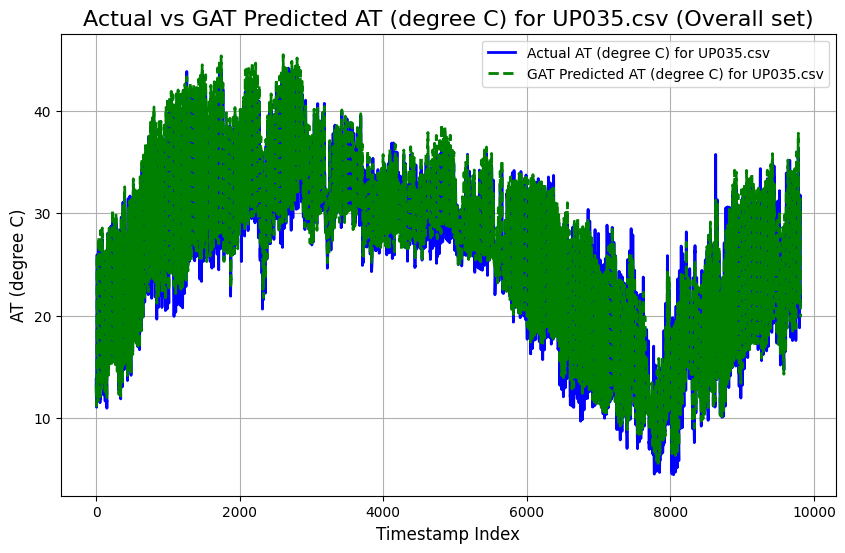

UP036.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0560
Mean Squared Error (MSE): 2.0617
Root Mean Squared Error (RMSE): 1.4358
Pearson Correlation Coefficient: 0.9854
R-squared (R²): 0.9653

----------------------------------------



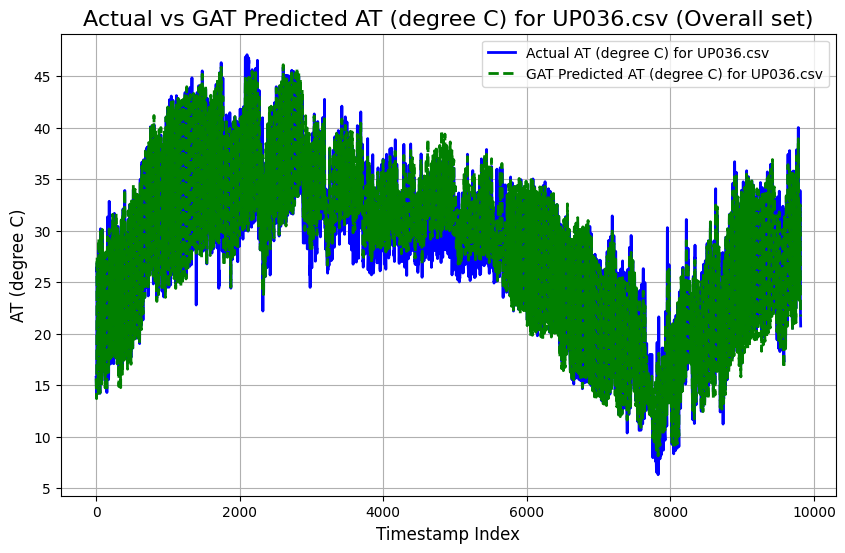

UP037.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1253
Mean Squared Error (MSE): 2.1386
Root Mean Squared Error (RMSE): 1.4624
Pearson Correlation Coefficient: 0.9881
R-squared (R²): 0.9712

----------------------------------------



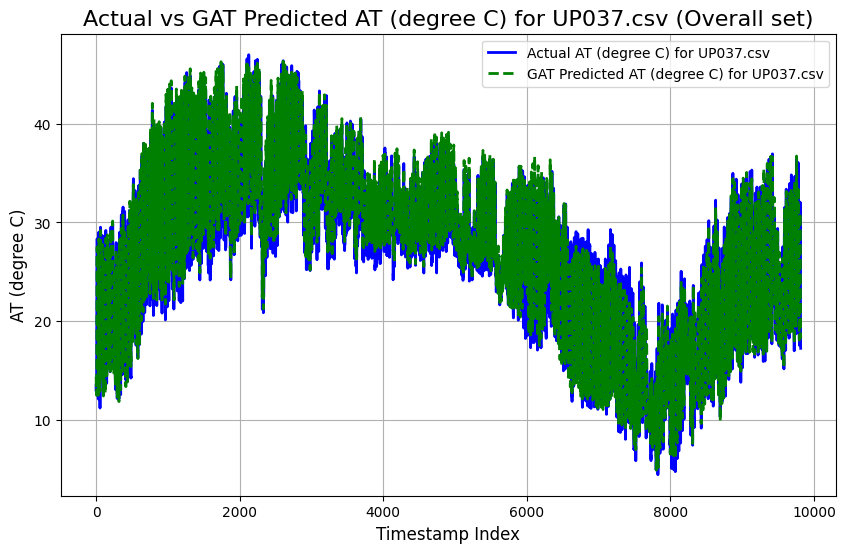

UP038.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9896
Mean Squared Error (MSE): 1.8394
Root Mean Squared Error (RMSE): 1.3562
Pearson Correlation Coefficient: 0.9866
R-squared (R²): 0.9681

----------------------------------------



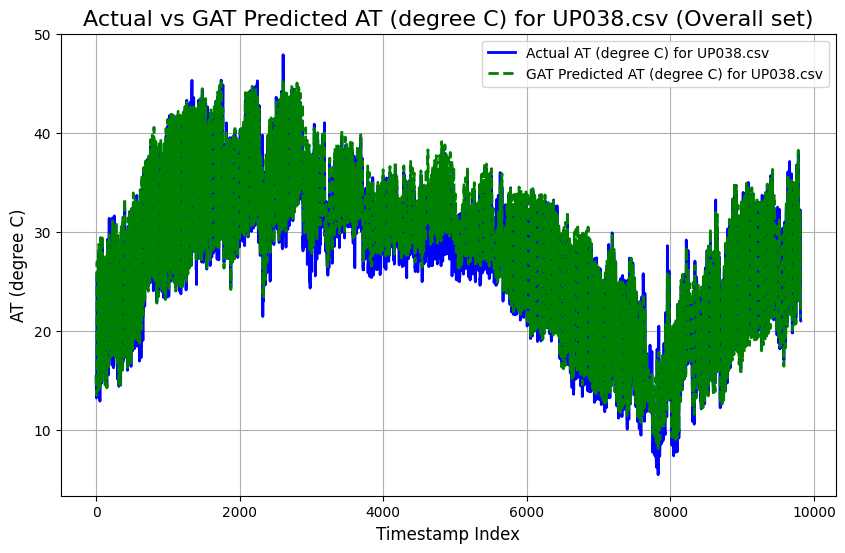

UP039.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5638
Mean Squared Error (MSE): 4.1364
Root Mean Squared Error (RMSE): 2.0338
Pearson Correlation Coefficient: 0.9758
R-squared (R²): 0.9466

----------------------------------------



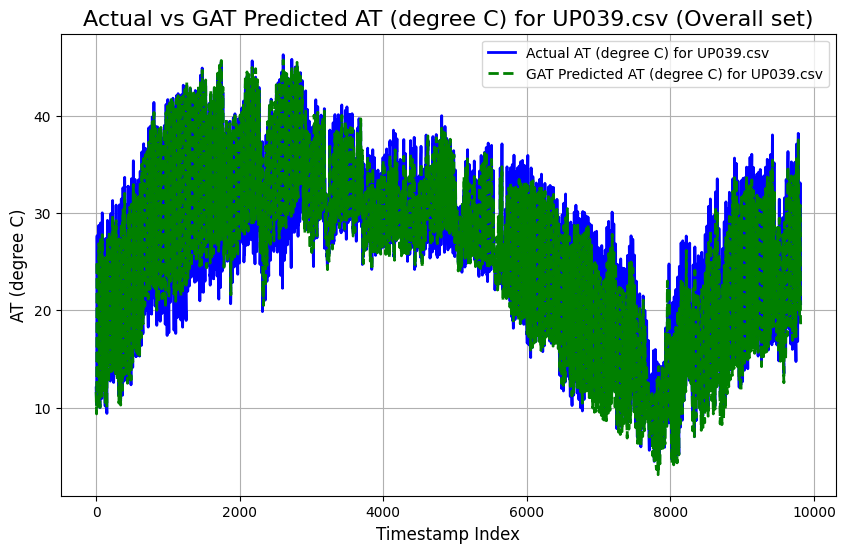

UP040.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3164
Mean Squared Error (MSE): 2.9117
Root Mean Squared Error (RMSE): 1.7064
Pearson Correlation Coefficient: 0.9839
R-squared (R²): 0.9623

----------------------------------------



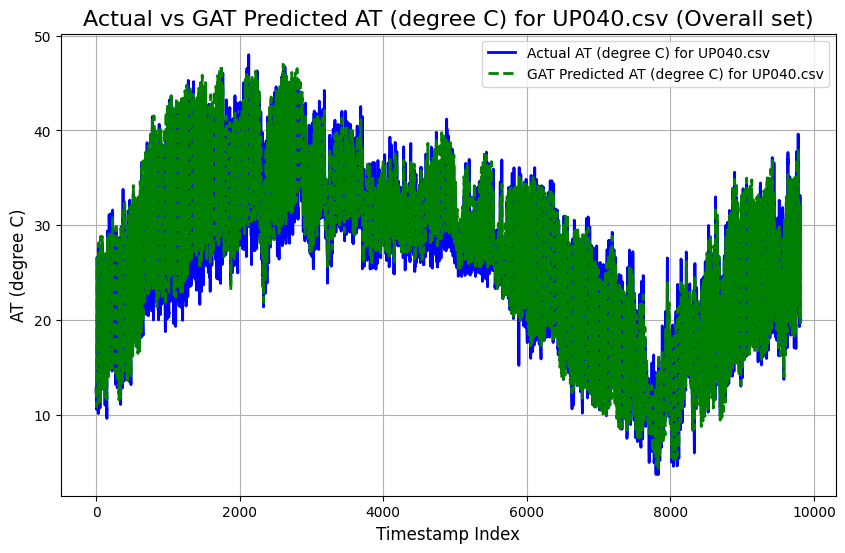

UP041.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0239
Mean Squared Error (MSE): 1.8337
Root Mean Squared Error (RMSE): 1.3541
Pearson Correlation Coefficient: 0.9861
R-squared (R²): 0.9671

----------------------------------------



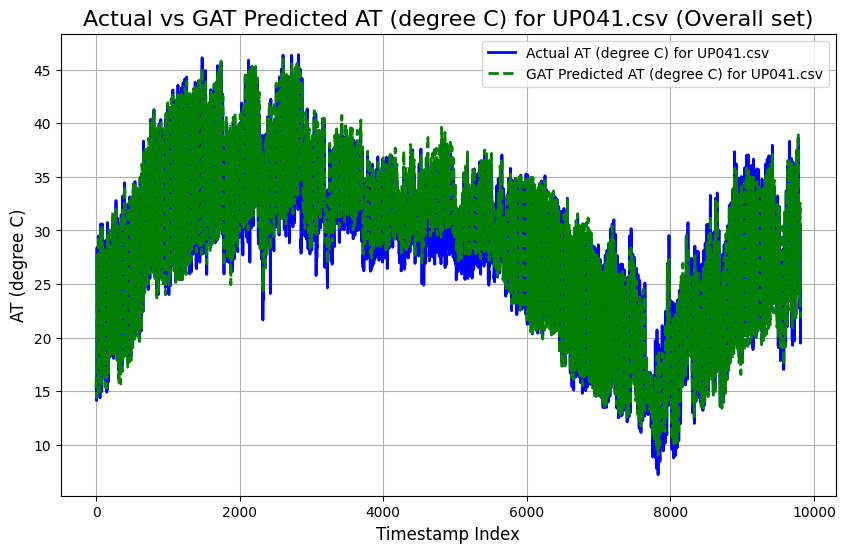

UP042.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1026
Mean Squared Error (MSE): 2.4225
Root Mean Squared Error (RMSE): 1.5564
Pearson Correlation Coefficient: 0.9842
R-squared (R²): 0.9630

----------------------------------------



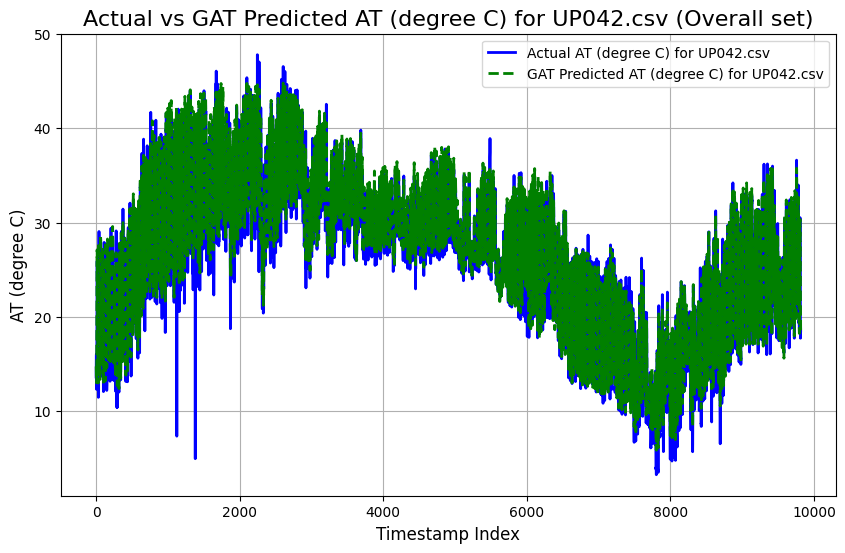

UP043.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1057
Mean Squared Error (MSE): 2.1779
Root Mean Squared Error (RMSE): 1.4758
Pearson Correlation Coefficient: 0.9879
R-squared (R²): 0.9698

----------------------------------------



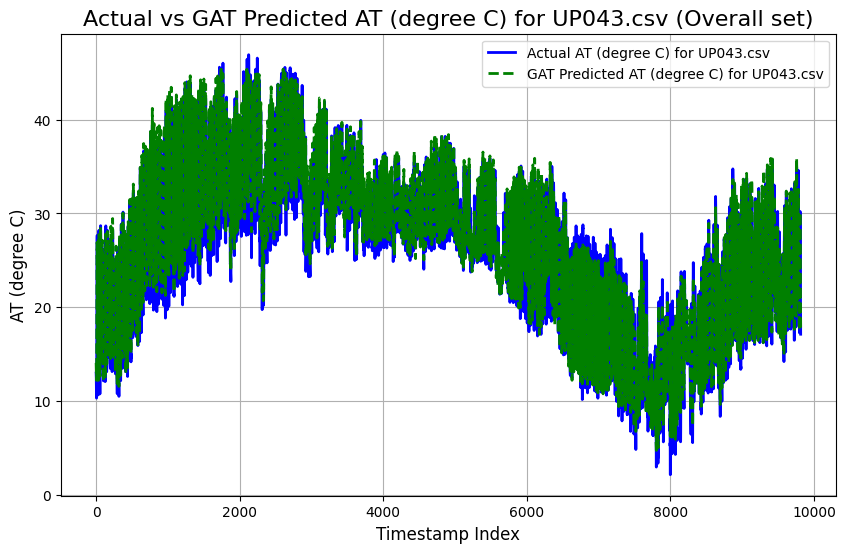

UP044.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1237
Mean Squared Error (MSE): 2.1820
Root Mean Squared Error (RMSE): 1.4771
Pearson Correlation Coefficient: 0.9876
R-squared (R²): 0.9707

----------------------------------------



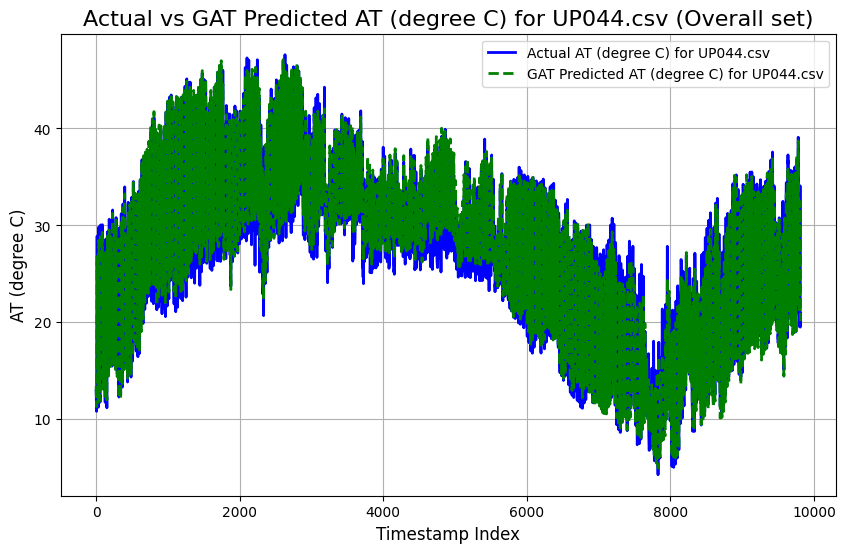

UP046.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4232
Mean Squared Error (MSE): 3.1897
Root Mean Squared Error (RMSE): 1.7860
Pearson Correlation Coefficient: 0.9795
R-squared (R²): 0.9527

----------------------------------------



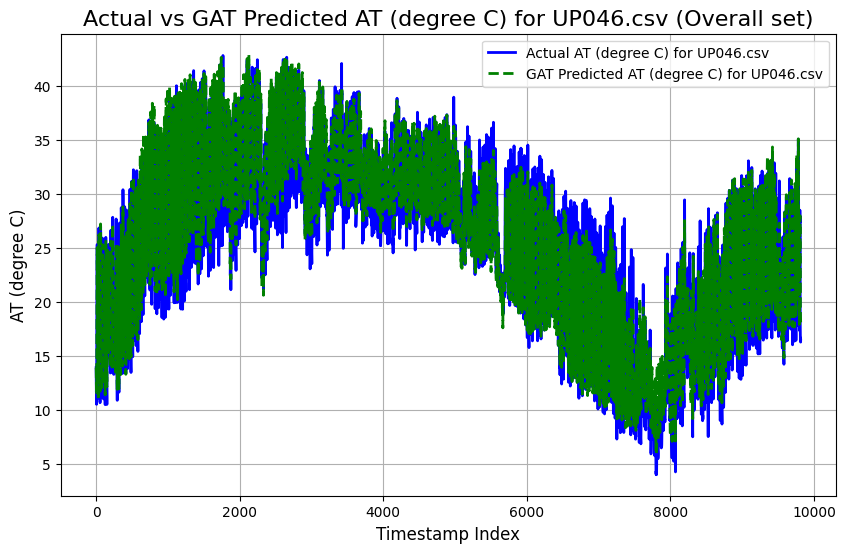

UP048.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5365
Mean Squared Error (MSE): 3.9669
Root Mean Squared Error (RMSE): 1.9917
Pearson Correlation Coefficient: 0.9726
R-squared (R²): 0.9392

----------------------------------------



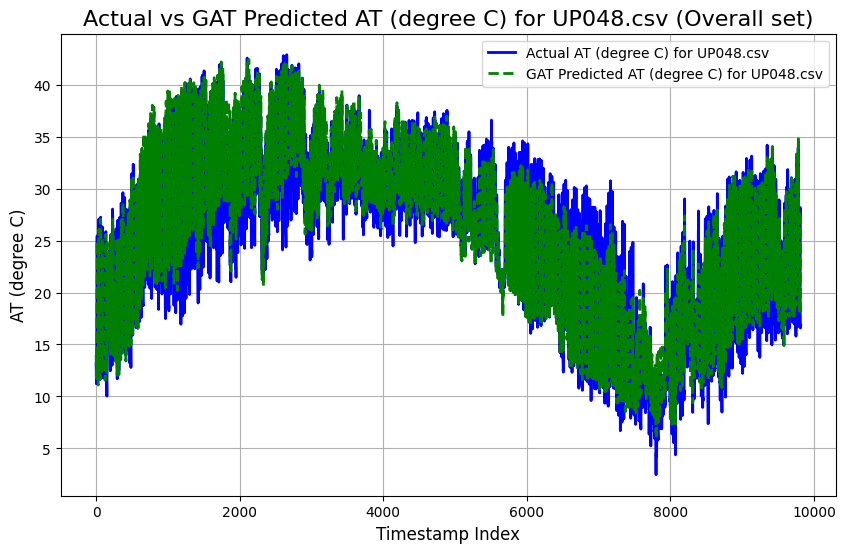

UP049.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3731
Mean Squared Error (MSE): 3.1953
Root Mean Squared Error (RMSE): 1.7875
Pearson Correlation Coefficient: 0.9800
R-squared (R²): 0.9535

----------------------------------------



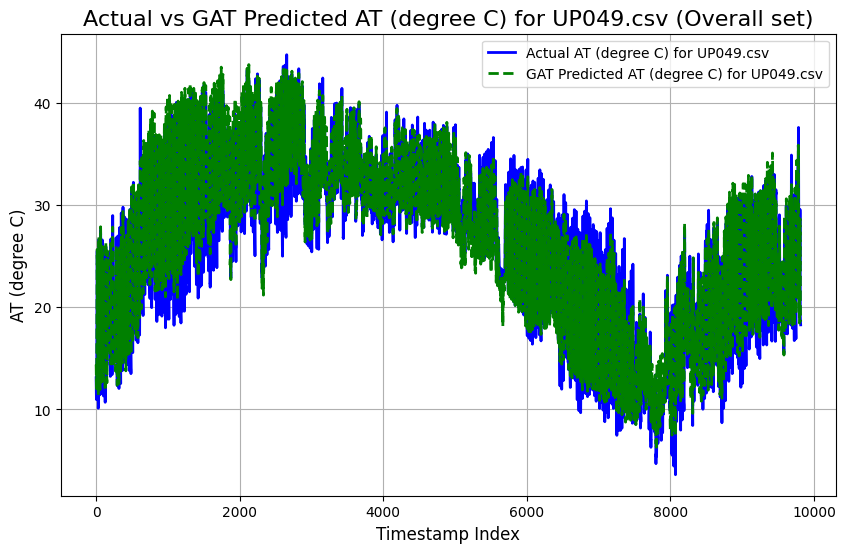

UP050.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4883
Mean Squared Error (MSE): 4.1074
Root Mean Squared Error (RMSE): 2.0267
Pearson Correlation Coefficient: 0.9665
R-squared (R²): 0.9289

----------------------------------------



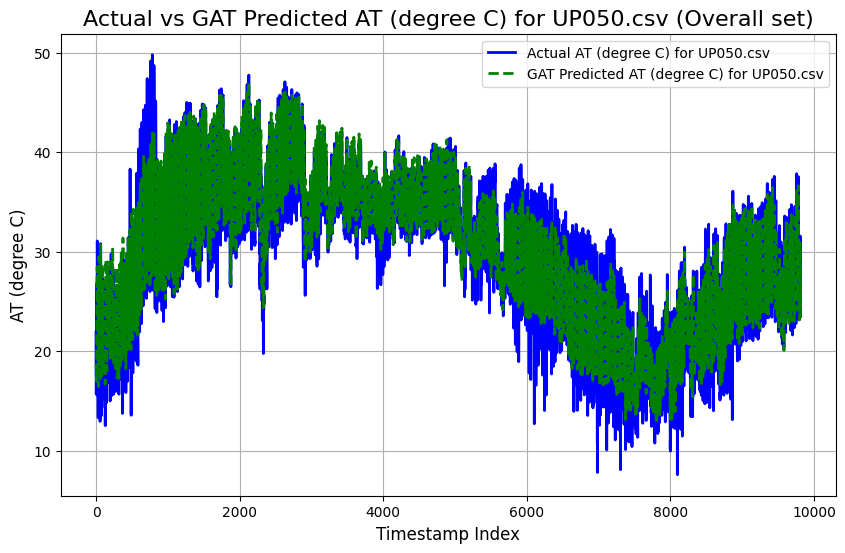

UP051.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.7113
Mean Squared Error (MSE): 24.6214
Root Mean Squared Error (RMSE): 4.9620
Pearson Correlation Coefficient: 0.8303
R-squared (R²): 0.6599

----------------------------------------



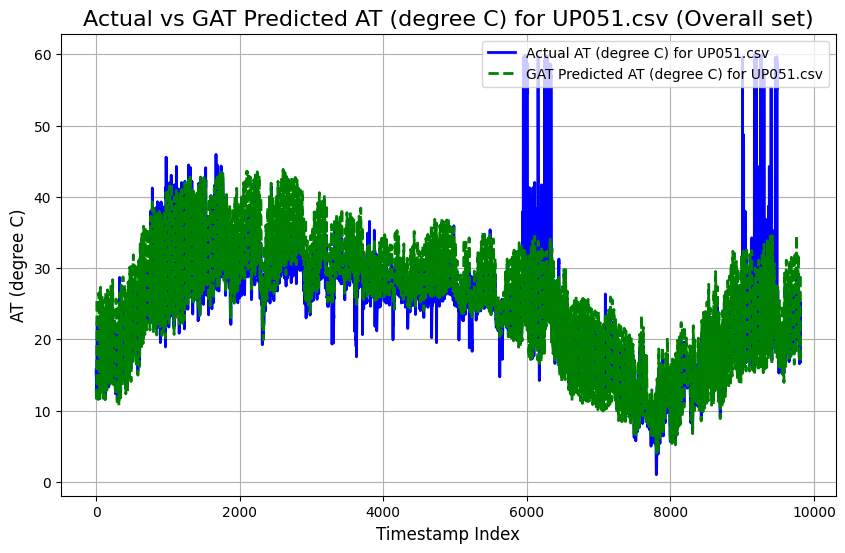

UP052.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5615
Mean Squared Error (MSE): 4.1756
Root Mean Squared Error (RMSE): 2.0434
Pearson Correlation Coefficient: 0.9707
R-squared (R²): 0.9363

----------------------------------------



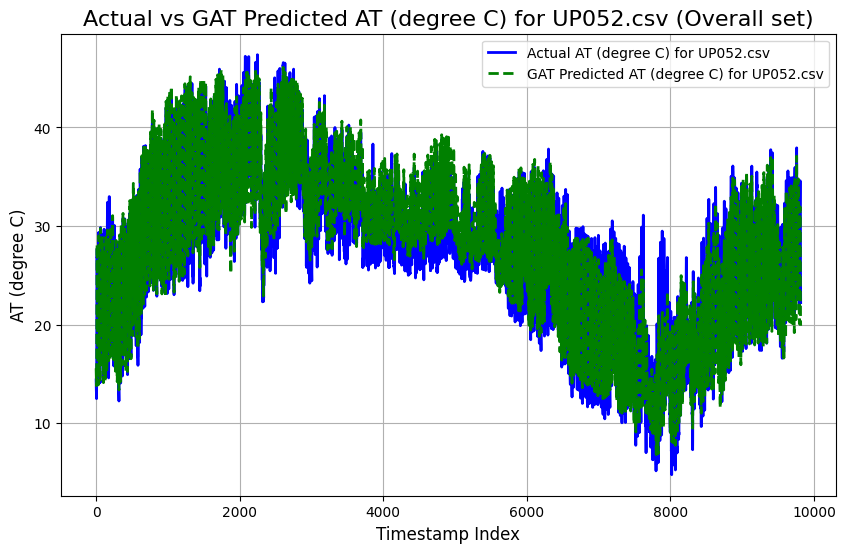

Overall GNN Imputed.csv
CSV file 'Overall GNN Imputed.csv' created successfully.
Shape of gat_outputs: (9816, 41)
Shape of actual_values: (9816, 41)


In [17]:

from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from scipy.stats import pearsonr

# Define the GAT model
class GATModel(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(GATModel, self).__init__()
        self.conv1 = GATConv(in_channels, 8, heads=8, dropout=0.2)
        self.conv2 = GATConv(8 * 8, out_channels, heads=1, concat=False, dropout=0.2)
        
    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        # First GAT layer followed by ELU activation
        x = self.conv1(x, edge_index)
        x = F.elu(x)
        # Dropout
        x = F.dropout(x, p=0.2, training=self.training)
        
        # Second GAT layer followed by ELU activation
        x = self.conv2(x, edge_index)
        return x

# Initialize the model and optimizer
in_channels = train_graph_data_list[0].x.size(-1)  # Number of input features (depends on the number of columns)
out_channels = 1  # Predicting a single value ('AT (degree C)')
model = GATModel(in_channels, out_channels)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=5e-4)
loss_fn = torch.nn.MSELoss()

# StepLR: Reduces the learning rate by gamma every step_size epochs
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)

# Train the GAT model on the training set
def train_gat(graph_data_list, epochs=30):
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        for graph_data in graph_data_list:
            optimizer.zero_grad()
            out = model(graph_data)
            loss = loss_fn(out.squeeze(), graph_data.y)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        scheduler.step()
        print(f"Epoch {epoch}, Loss: {epoch_loss/len(graph_data_list)}")

# Train the model using the training dataset
train_gat(train_graph_data_list)

# Evaluate the model on the training and testing sets
def evaluate_gat(graph_data_list):
    model.eval()
    gat_outputs = []
    actual_values = []
    with torch.no_grad():
        for graph_data in graph_data_list:
            gat_output = model(graph_data)
            gat_outputs.append(gat_output.squeeze().numpy())
            actual_values.append(graph_data.y.squeeze().numpy())
    return np.array(gat_outputs), np.array(actual_values)

# Get GAT predictions for training and testing sets
train_gat_outputs, train_actual_values = evaluate_gat(train_graph_data_list)
test_gat_outputs, test_actual_values = evaluate_gat(test_graph_data_list)

train_gnn_mae_list = []
train_gnn_mse_list = []
train_gnn_rmse_list = []
train_gnn_pearson_corr_list = []
train_gnn_r_squared_list = []

test_gnn_mae_list = []
test_gnn_mse_list = []
test_gnn_rmse_list = []
test_gnn_pearson_corr_list = []
test_gnn_r_squared_list = []

overall_gnn_mae_list = []
overall_gnn_mse_list = []
overall_gnn_rmse_list = []
overall_gnn_pearson_corr_list = []
overall_gnn_r_squared_list = []

# Apply inverse scaling and calculate performance metrics for training and testing sets
def inverse_scale_and_evaluate(gat_outputs, actual_values, set_type):
    gat_outputs_inverse_scaled = []
    actual_values_inverse_scaled = []
    for node_idx in range(gat_outputs.shape[1]):
        gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
        actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
        gat_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(gat_node_values).flatten()
        actual_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(actual_node_values).flatten()
        gat_outputs_inverse_scaled.append(gat_node_inverse_scaled)
        actual_values_inverse_scaled.append(actual_node_inverse_scaled)
    
    # Evaluate performance metrics for each node
    num_nodes = gat_outputs.shape[1]
    for node_idx in range(num_nodes):
        actual = actual_values_inverse_scaled[node_idx]
        predicted = gat_outputs_inverse_scaled[node_idx]
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        rmse = np.sqrt(mse)
        pearson_corr, _ = pearsonr(actual, predicted)
        r_squared = r2_score(actual, predicted)
        
        print(f"{input_files[node_idx]} ({set_type} set) Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {pearson_corr:.4f}")
        print(f"R-squared (R²): {r_squared:.4f}")
        print("\n" + "-"*40 + "\n")

        if(set_type == 'Training'):
            train_gnn_mae_list.append(mae)
            train_gnn_mse_list.append(mse)
            train_gnn_rmse_list.append(rmse)
            train_gnn_pearson_corr_list.append(pearson_corr)
            train_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Testing'):
            test_gnn_mae_list.append(mae)
            test_gnn_mse_list.append(mse)
            test_gnn_rmse_list.append(rmse)
            test_gnn_pearson_corr_list.append(pearson_corr)
            test_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Overall'):
            overall_gnn_mae_list.append(mae)
            overall_gnn_mse_list.append(mse)
            overall_gnn_rmse_list.append(rmse)
            overall_gnn_pearson_corr_list.append(pearson_corr)
            overall_gnn_r_squared_list.append(r_squared)        
        
        # Plot actual vs predicted values for this node
        plt.figure(figsize=(10, 6))
        plt.plot(actual, label=f'Actual AT (degree C) for {input_files[node_idx]}', color='blue', linewidth=2)
        plt.plot(predicted, label=f'GAT Predicted AT (degree C) for {input_files[node_idx]}', color='green', linestyle='--', linewidth=2)
        plt.title(f'Actual vs GAT Predicted AT (degree C) for {input_files[node_idx]} ({set_type} set)', fontsize=16)
        plt.xlabel('Timestamp Index', fontsize=12)
        plt.ylabel('AT (degree C)', fontsize=12)
        plt.legend(loc='upper right')
        plt.grid(True)
        plt.show()

# Evaluate and plot for both training and testing sets
inverse_scale_and_evaluate(train_gat_outputs, train_actual_values, 'Training')
inverse_scale_and_evaluate(test_gat_outputs, test_actual_values, 'Testing')

def create_metrics_gnn_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")


# Create CSV for training set
file_name = "Train GNN Imputed.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, train_gnn_mae_list, train_gnn_mse_list, train_gnn_rmse_list, train_gnn_r_squared_list, train_gnn_pearson_corr_list)

# Create CSV for training set
file_name = "Test GNN Imputed.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, test_gnn_mae_list, test_gnn_mse_list, test_gnn_rmse_list, test_gnn_r_squared_list, test_gnn_pearson_corr_list)

# Concatenate training and testing outputs
gat_outputs = np.concatenate([train_gat_outputs, test_gat_outputs], axis=0)
actual_values = np.concatenate([train_actual_values, test_actual_values], axis=0)
inverse_scale_and_evaluate(gat_outputs, actual_values, 'Overall')

# Create CSV for overall set
file_name = "Overall GNN Imputed.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, overall_gnn_mae_list, overall_gnn_mse_list, overall_gnn_rmse_list, overall_gnn_r_squared_list, overall_gnn_pearson_corr_list)

# Print the shapes of gat_outputs and actual_values
print(f"Shape of gat_outputs: {gat_outputs.shape}")
print(f"Shape of actual_values: {actual_values.shape}")


# Showing the GAT outputs and actual outputs

In [18]:
gat_outputs_without_inverse_scaled = []
actual_values_without_inverse_scaled = []

for node_idx in range(gat_outputs.shape[1]):
    # Extract predictions and actual values for the current node across all timestamps
    gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
    actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
    
    # Append the inverse scaled values for this node
    gat_outputs_without_inverse_scaled.append(gat_node_values)
    actual_values_without_inverse_scaled.append(actual_node_values)

# Plot the actual vs predicted values for each node
num_nodes = gat_outputs.shape[1]
print(gat_outputs_without_inverse_scaled)
print(actual_values_without_inverse_scaled)


[array([[-1.5399076],
       [-1.5774045],
       [-1.6188824],
       ...,
       [-0.682018 ],
       [-0.7281819],
       [-0.7580604]], dtype=float32), array([[-1.5771996 ],
       [-1.6047693 ],
       [-1.6525939 ],
       ...,
       [-0.78946775],
       [-0.8321008 ],
       [-0.8141052 ]], dtype=float32), array([[-1.427495  ],
       [-1.4672741 ],
       [-1.5235169 ],
       ...,
       [-0.910805  ],
       [-0.9419963 ],
       [-0.98595273]], dtype=float32), array([[-1.4307035 ],
       [-1.4660015 ],
       [-1.5349468 ],
       ...,
       [-0.8060302 ],
       [-0.8265385 ],
       [-0.82521445]], dtype=float32), array([[-1.4395162 ],
       [-1.4642206 ],
       [-1.5519199 ],
       ...,
       [-0.8257568 ],
       [-0.8514625 ],
       [-0.85489106]], dtype=float32), array([[-1.4280444],
       [-1.4647158],
       [-1.5316709],
       ...,
       [-0.8607314],
       [-0.8874963],
       [-0.9088963]], dtype=float32), array([[-1.4142361 ],
       [-1.4317882 ],
 

# Adding the GNN predicted values as a new column

In [19]:
train_gat_outputs_without_inverse_scaled = []
test_gat_outputs_without_inverse_scaled = []
train_size = train_dataframes[0].shape[0]

for node_idx in range(num_nodes):
    train1 = gat_outputs_without_inverse_scaled[node_idx][:train_size]
    test1 = gat_outputs_without_inverse_scaled[node_idx][train_size:]
    train_gat_outputs_without_inverse_scaled.append(train1)
    test_gat_outputs_without_inverse_scaled.append(test1)

# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(train_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = train_gat_outputs_without_inverse_scaled[node_idx].flatten()
    print(df.shape)
    print(len(predicted_values))

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(test_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = test_gat_outputs_without_inverse_scaled[node_idx].flatten()

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


(8343, 15)
8343
DataFrame 1 - UP002.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.026293      0.443649    0.117046     0.433734    -0.846243   
1       0.106304      0.344591    0.081311     0.343616    -0.313307   
2       0.078903      0.248329    0.201752     0.640199     0.095690   
3       0.086575      0.237278    0.102818     0.593795     0.157659   
4      -0.176474      0.093884    0.053185     0.202385     0.201038   
5      -0.087257      0.001749    0.093884     0.336890    -0.084021   
6      -0.172748     -0.006638    0.213995     0.894078    -0.112940   
7       0.0

C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

(8343, 15)
8343
DataFrame 13 - UP021.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       1.179878      1.519262    4.534856     0.807608    -0.828433   
1       1.171949      1.912547    6.496965     1.102045    -0.858348   
2       1.239346      1.993221    0.319543     0.215925    -0.315360   
3       1.191772      1.646323    4.848886     0.320079    -1.107216   
4       1.195736      1.339762    5.961652     0.363835    -1.044840   
5       1.187807      1.232869    5.387277     0.274911    -1.105306   
6       1.049051      0.898072    4.893142     0.529827    -1.167682   
7       0.

C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       1.475101      1.587417   -0.180609     0.168359    -1.028191   
1       2.804449      1.646997   -0.245370     0.120562    -1.041406   
2       1.386093      0.680932   -0.366995    -0.056126    -1.022905   
3       0.688921      0.675058   -0.361730    -0.008866    -1.028191   
4       2.116282      2.180902    0.423303     1.008832    -0.943618   
5       1.397022      1.231620    0.904537     1.468005    -0.763901   
6       1.843167      1.064840    1.500552     1.505061    -0.602683   
7       1.298196      1.017638    2.019695     1.608173    -0.196997   
8       2.300979      1.774756    1.920710     2.284848     0.459765   
9       1.836407      1.128825    1.428946     2.236515    -0.138853   

   CO (mg/m3)  Ozone (ug/m3)    RH (%)  WS (m/s)  WD (degree)  AT (degree C)  \
0   -1.449331      -0.881234  0.992743 -1.337200    -1.392711      -1.578205   
1   -1.449331      -0.773796  0.729163 -0.88865

C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

DataFrame 5 - UP009.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 1473
      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343      -0.386473     -0.888274   -0.340662    -0.535849    -0.092518   
8344      -0.062124     -0.636020   -0.330191    -0.225845    -0.310912   
8345       0.279803     -0.112507   -0.308898    -0.364207    -0.338589   
8346       0.308108     -0.352882   -0.289858    -0.278225    -0.352450   
8347      -0.336804     -0.861825   -0.341871    -0.552252    -0.427764   
8348      -0.317491     -0.962183   -0.291426    -0.539335    -0.279997   
8349      -0.497840     -1.142701   -0.352079    -0.742620    -0.339733   
835

C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co


Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 1473
      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343      -0.401921     -0.562126   -0.356863    -0.808015     1.295092   
8344      -0.498362     -0.696048   -0.358990    -0.698260     1.549715   
8345       0.051824     -0.276530   -0.339140    -0.534193     2.030443   
8346       0.209607     -0.204973   -0.335595     0.149229     2.191365   
8347      -0.074339     -0.373506   -0.290224     0.963340     2.260622   
8348       1.139547     -0.165067   -0.251234     1.178324     1.618972   
8349       1.679931      0.853325   -0.200192     1.113829     1.358238   
8350       1.107611      0.819476  

C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18392\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

# Creating feature and target lists

In [20]:
# Initialize lists to store features and target for each dataframe
train_features_list = []
train_target_list = []

test_features_list = []
test_target_list = []

# Iterate over each dataframe to separate features and target
for node_idx, (df1, df2) in enumerate(zip(train_dataframes, test_dataframes)):
    # Features include all columns except 'AT (degree C)'
    trainfeatures1 = df1.drop(columns=['AT (degree C)'])
    testfeatures1 = df2.drop(columns=['AT (degree C)'])
    
    # Target is the 'AT (degree C)' column
    traintarget1 = df1['AT (degree C)']
    testtarget1 = df2['AT (degree C)']
    
    # Append the features and target to the respective lists
    train_features_list.append(trainfeatures1)
    train_target_list.append(traintarget1)
    test_features_list.append(testfeatures1)
    test_target_list.append(testtarget1)
    
    # Print the columns of features and target, and number of rows
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}:")
    print(f"Features columns: {len(trainfeatures1.columns)}")
    print(trainfeatures1.columns)
    
    print("\nTarget column:")
    print(traintarget1.name)
    
    print(f"\nNumber of rows in training features: {trainfeatures1.shape[0]}")
    print(f"Number of rows in training target: {traintarget1.shape[0]}")
    print(f"\nNumber of rows in testing features: {testfeatures1.shape[0]}")
    print(f"Number of rows in testing target: {testtarget1.shape[0]}")
    print("\n" + "="*60 + "\n")

DataFrame 1 - UP002.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFrame 2 - UP003.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFr

# Transformer with Positional Encoding Implementation

Num Layers: 2, Num Heads: 2
For Batch Size= 3 and Sequence Length = 3
Processing node 1...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\transformer.py:307: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to inco

Epoch [1/50], Train Loss: 0.1169
Epoch [2/50], Train Loss: 0.0828
Epoch [3/50], Train Loss: 0.0775
Epoch [4/50], Train Loss: 0.0733
Epoch [5/50], Train Loss: 0.0708
Epoch [6/50], Train Loss: 0.0667
Epoch [7/50], Train Loss: 0.0633
Epoch [8/50], Train Loss: 0.0652
Epoch [9/50], Train Loss: 0.0628
Epoch [10/50], Train Loss: 0.0616
Epoch [11/50], Train Loss: 0.0604
Epoch [12/50], Train Loss: 0.0582
Epoch [13/50], Train Loss: 0.0564
Epoch [14/50], Train Loss: 0.0557
Epoch [15/50], Train Loss: 0.0561
Epoch [16/50], Train Loss: 0.0552
Epoch [17/50], Train Loss: 0.0563
Epoch [18/50], Train Loss: 0.0572
Epoch [19/50], Train Loss: 0.0563
Epoch [20/50], Train Loss: 0.0551
Epoch [21/50], Train Loss: 0.0534
Epoch [22/50], Train Loss: 0.0544
Epoch [23/50], Train Loss: 0.0537
Epoch [24/50], Train Loss: 0.0538
Epoch [25/50], Train Loss: 0.0538
Epoch [26/50], Train Loss: 0.0541
Epoch [27/50], Train Loss: 0.0537
Epoch [28/50], Train Loss: 0.0528
Epoch [29/50], Train Loss: 0.0525
Epoch [30/50], Train Lo

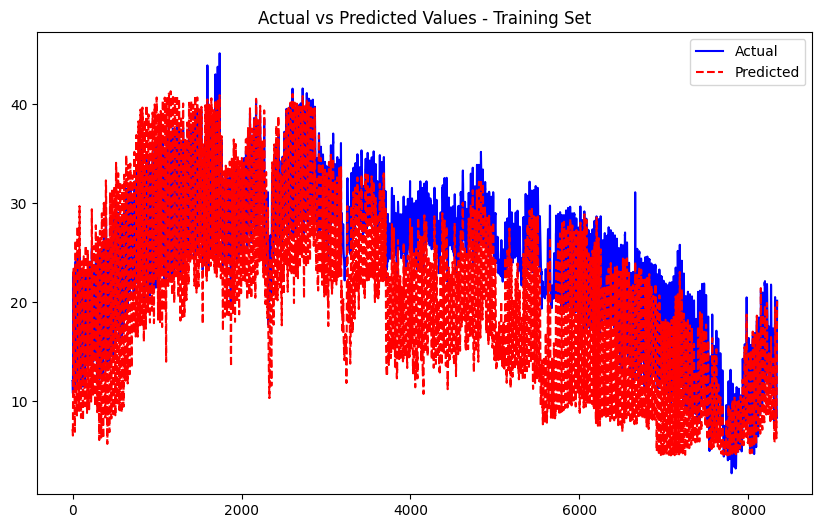

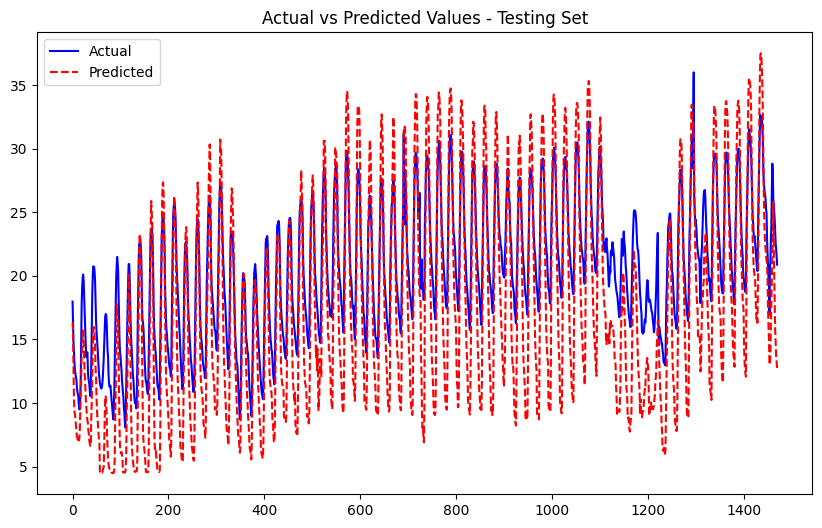

Processing node 2...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0472
Epoch [2/50], Train Loss: 0.0469
Epoch [3/50], Train Loss: 0.0465
Epoch [4/50], Train Loss: 0.0461
Epoch [5/50], Train Loss: 0.0460
Epoch [6/50], Train Loss: 0.0454
Epoch [7/50], Train Loss: 0.0469
Epoch [8/50], Train Loss: 0.0462
Epoch [9/50], Train Loss: 0.0457
Epoch [10/50], Train Loss: 0.0459
Epoch [11/50], Train Loss: 0.0448
Epoch [12/50], Train Loss: 0.0449
Epoch [13/50], Train Loss: 0.0446
Epoch [14/50], Train Loss: 0.0452
Epoch [15/50], Train Loss: 0.0443
Epoch [16/50], Train Loss: 0.0454
Epoch [17/50], Train Loss: 0.0440
Epoch [18/50], Train Loss: 0.0451
Epoch [19/50], Train Loss: 0.0446
Epoch [20/50], Train Loss: 0.0443
Epoch [21/50], Train Loss: 0.0448
Epoch [22/50], Train Loss: 0.0441
Epoch [23/50], Train Loss: 0.0443
Epoch [24/50], Train Loss: 0.0446
Epoch [25/50], Train Loss: 0.0435
Epoch [26/50], Train Loss: 0.0436
Epoch [27/50], Train Loss: 0.0444
Epoch [28/50], Train Loss: 0.0446
Epoch [29/50], Train Loss: 0.0434
Epoch [30/50], Train Lo

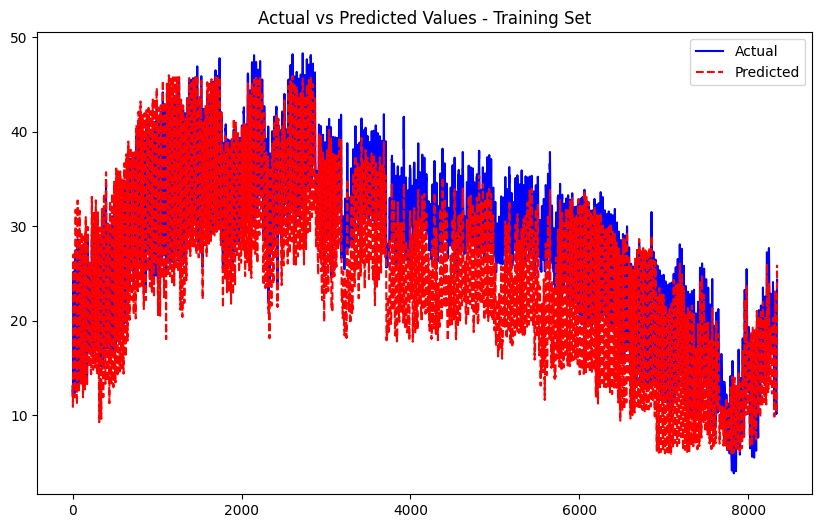

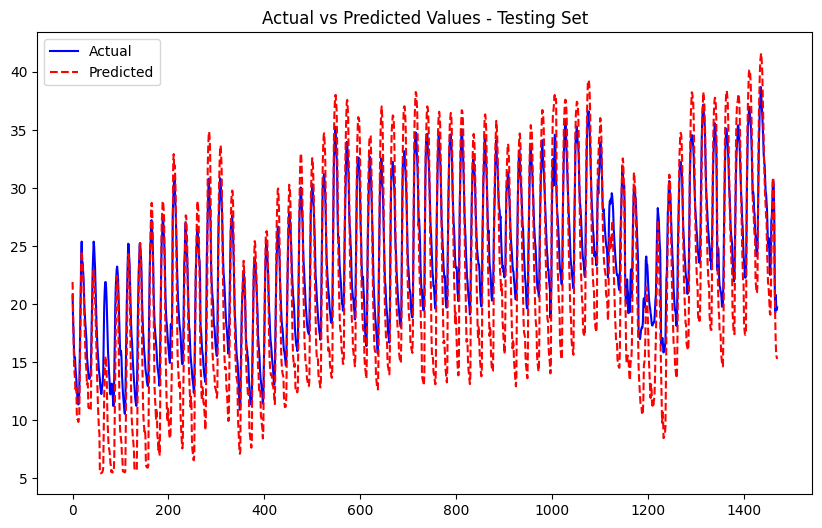

Processing node 3...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0391
Epoch [2/50], Train Loss: 0.0374
Epoch [3/50], Train Loss: 0.0376
Epoch [4/50], Train Loss: 0.0368
Epoch [5/50], Train Loss: 0.0371
Epoch [6/50], Train Loss: 0.0372
Epoch [7/50], Train Loss: 0.0365
Epoch [8/50], Train Loss: 0.0361
Epoch [9/50], Train Loss: 0.0361
Epoch [10/50], Train Loss: 0.0372
Epoch [11/50], Train Loss: 0.0375
Epoch [12/50], Train Loss: 0.0357
Epoch [13/50], Train Loss: 0.0360
Epoch [14/50], Train Loss: 0.0367
Epoch [15/50], Train Loss: 0.0362
Epoch [16/50], Train Loss: 0.0363
Epoch [17/50], Train Loss: 0.0360
Epoch [18/50], Train Loss: 0.0359
Epoch [19/50], Train Loss: 0.0366
Epoch [20/50], Train Loss: 0.0365
Epoch [21/50], Train Loss: 0.0361
Epoch [22/50], Train Loss: 0.0359
Epoch [23/50], Train Loss: 0.0371
Epoch [24/50], Train Loss: 0.0367
Epoch [25/50], Train Loss: 0.0360
Epoch [26/50], Train Loss: 0.0360
Epoch [27/50], Train Loss: 0.0363
Epoch [28/50], Train Loss: 0.0360
Epoch [29/50], Train Loss: 0.0360
Epoch [30/50], Train Lo

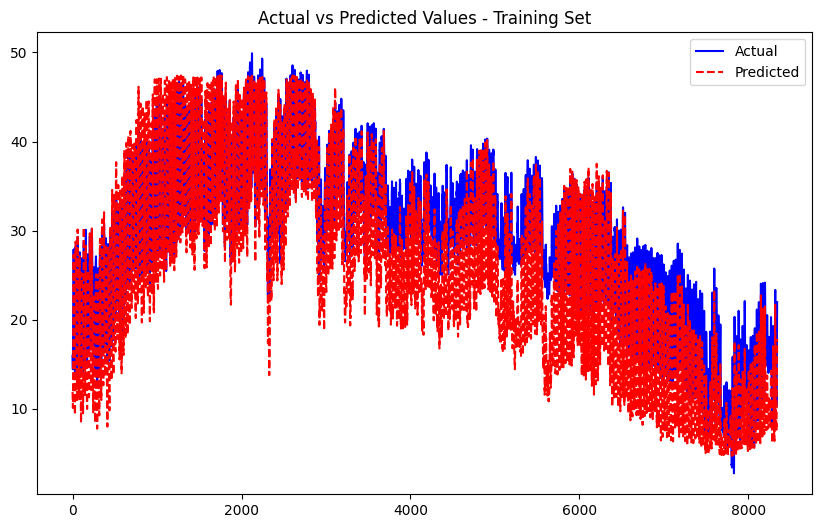

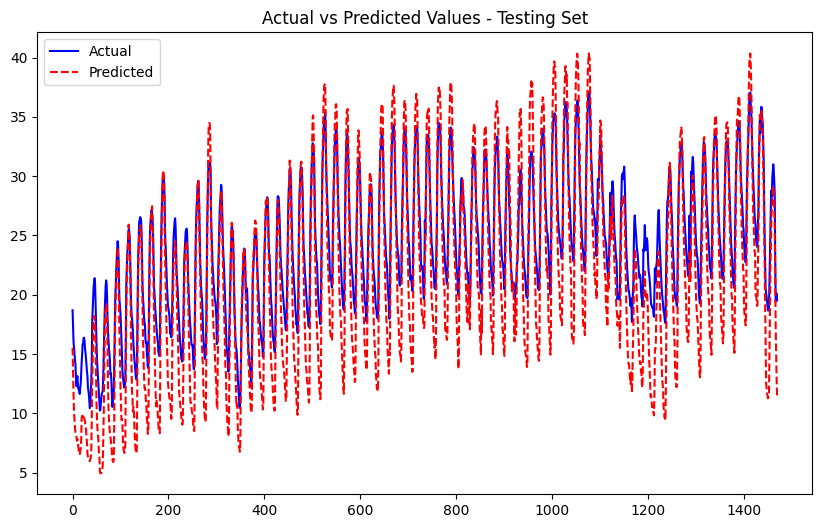

Processing node 4...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1987
Epoch [2/50], Train Loss: 0.2105
Epoch [3/50], Train Loss: 0.2047
Epoch [4/50], Train Loss: 0.2018
Epoch [5/50], Train Loss: 0.2027
Epoch [6/50], Train Loss: 0.2075
Epoch [7/50], Train Loss: 0.2085
Epoch [8/50], Train Loss: 0.2720
Epoch [9/50], Train Loss: 0.2406
Epoch [10/50], Train Loss: 0.2288
Epoch [11/50], Train Loss: 0.2186
Epoch [12/50], Train Loss: 0.2184
Epoch [13/50], Train Loss: 0.2189
Epoch [14/50], Train Loss: 0.2194
Epoch [15/50], Train Loss: 0.2189
Epoch [16/50], Train Loss: 0.2216
Epoch [17/50], Train Loss: 0.2196
Epoch [18/50], Train Loss: 0.2237
Epoch [19/50], Train Loss: 0.2238
Epoch [20/50], Train Loss: 0.2240
Epoch [21/50], Train Loss: 0.2199
Epoch [22/50], Train Loss: 0.2225
Epoch [23/50], Train Loss: 0.2183
Epoch [24/50], Train Loss: 0.2165
Epoch [25/50], Train Loss: 0.2158
Epoch [26/50], Train Loss: 0.2118
Epoch [27/50], Train Loss: 0.2050
Epoch [28/50], Train Loss: 0.1979
Epoch [29/50], Train Loss: 0.1995
Epoch [30/50], Train Lo

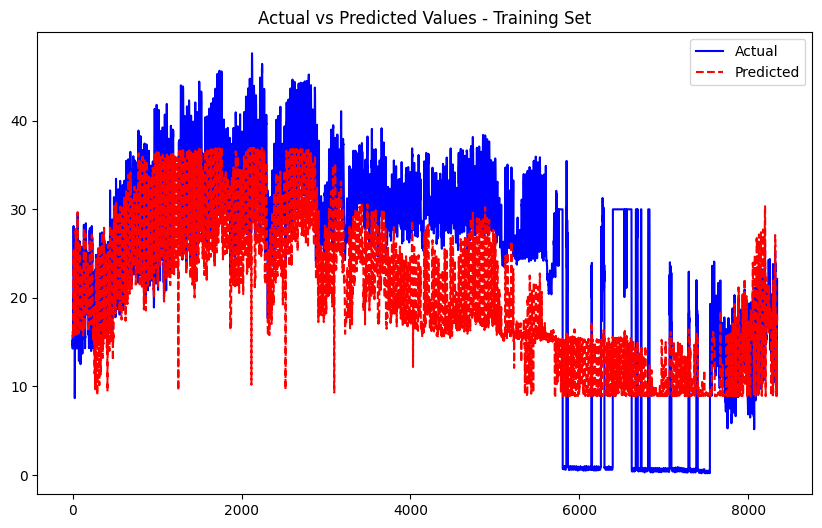

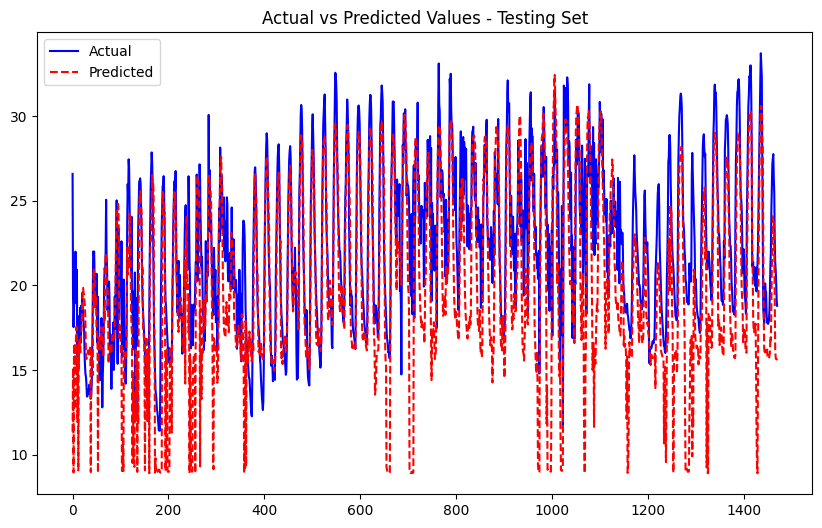

Processing node 5...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0797
Epoch [2/50], Train Loss: 0.0605
Epoch [3/50], Train Loss: 0.0566
Epoch [4/50], Train Loss: 0.0546
Epoch [5/50], Train Loss: 0.0509
Epoch [6/50], Train Loss: 0.0469
Epoch [7/50], Train Loss: 0.0461
Epoch [8/50], Train Loss: 0.0460
Epoch [9/50], Train Loss: 0.0449
Epoch [10/50], Train Loss: 0.0459
Epoch [11/50], Train Loss: 0.0459
Epoch [12/50], Train Loss: 0.0451
Epoch [13/50], Train Loss: 0.0442
Epoch [14/50], Train Loss: 0.0430
Epoch [15/50], Train Loss: 0.0430
Epoch [16/50], Train Loss: 0.0424
Epoch [17/50], Train Loss: 0.0429
Epoch [18/50], Train Loss: 0.0431
Epoch [19/50], Train Loss: 0.0426
Epoch [20/50], Train Loss: 0.0436
Epoch [21/50], Train Loss: 0.0443
Epoch [22/50], Train Loss: 0.0435
Epoch [23/50], Train Loss: 0.0452
Epoch [24/50], Train Loss: 0.0430
Epoch [25/50], Train Loss: 0.0437
Epoch [26/50], Train Loss: 0.0419
Epoch [27/50], Train Loss: 0.0423
Epoch [28/50], Train Loss: 0.0423
Epoch [29/50], Train Loss: 0.0417
Epoch [30/50], Train Lo

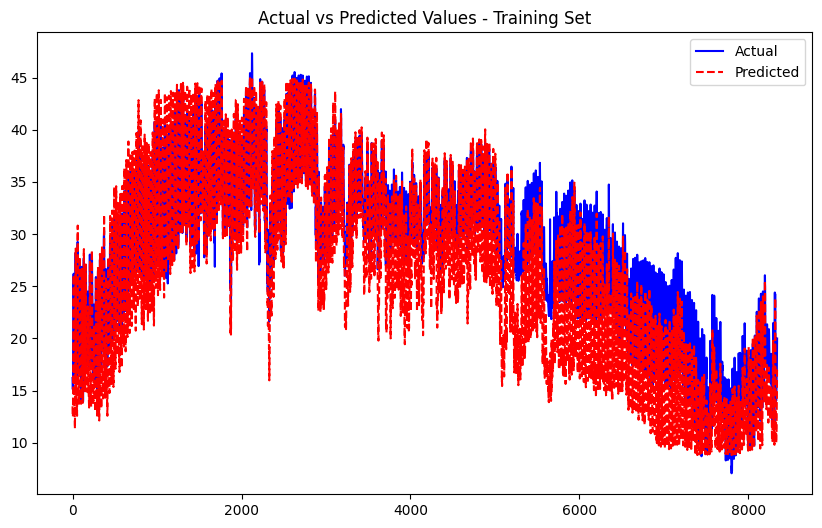

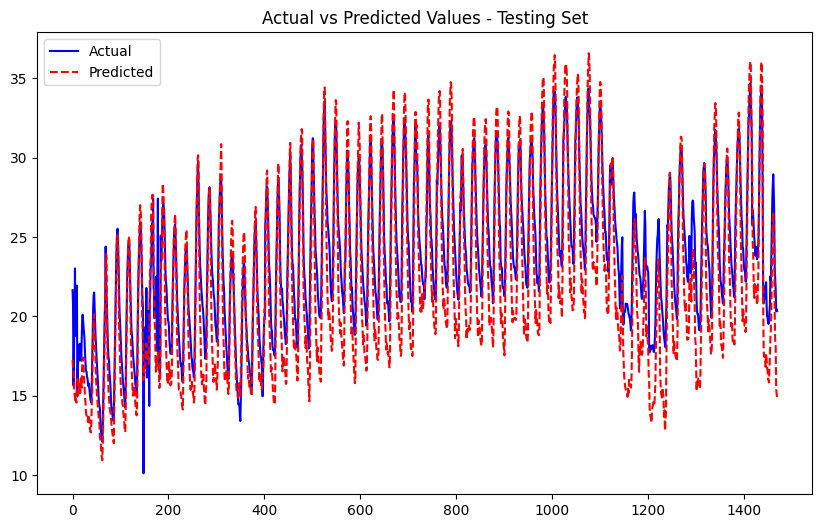

Processing node 6...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0594
Epoch [2/50], Train Loss: 0.0577
Epoch [3/50], Train Loss: 0.0575
Epoch [4/50], Train Loss: 0.0594
Epoch [5/50], Train Loss: 0.0565
Epoch [6/50], Train Loss: 0.0568
Epoch [7/50], Train Loss: 0.0562
Epoch [8/50], Train Loss: 0.0573
Epoch [9/50], Train Loss: 0.0568
Epoch [10/50], Train Loss: 0.0586
Epoch [11/50], Train Loss: 0.0571
Epoch [12/50], Train Loss: 0.0556
Epoch [13/50], Train Loss: 0.0564
Epoch [14/50], Train Loss: 0.0573
Epoch [15/50], Train Loss: 0.0564
Epoch [16/50], Train Loss: 0.0555
Epoch [17/50], Train Loss: 0.0564
Epoch [18/50], Train Loss: 0.0563
Epoch [19/50], Train Loss: 0.0570
Epoch [20/50], Train Loss: 0.0578
Epoch [21/50], Train Loss: 0.0563
Epoch [22/50], Train Loss: 0.0552
Epoch [23/50], Train Loss: 0.0544
Epoch [24/50], Train Loss: 0.0542
Epoch [25/50], Train Loss: 0.0543
Epoch [26/50], Train Loss: 0.0550
Epoch [27/50], Train Loss: 0.0548
Epoch [28/50], Train Loss: 0.0548
Epoch [29/50], Train Loss: 0.0564
Epoch [30/50], Train Lo

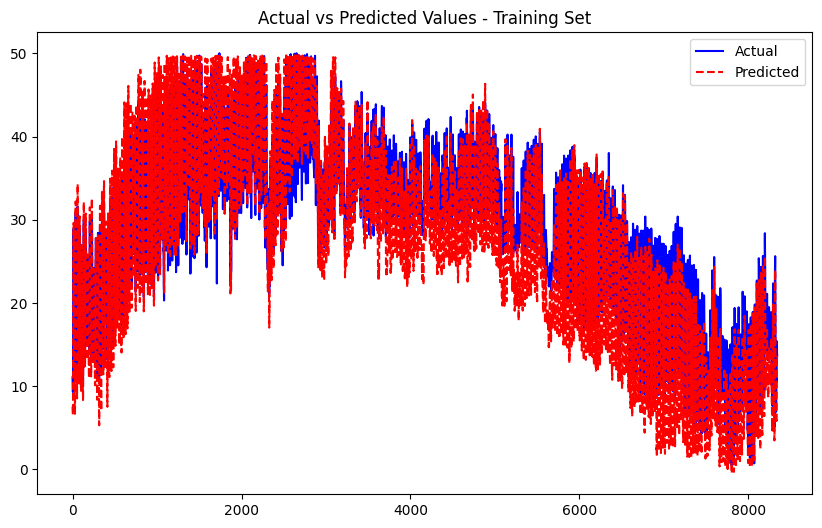

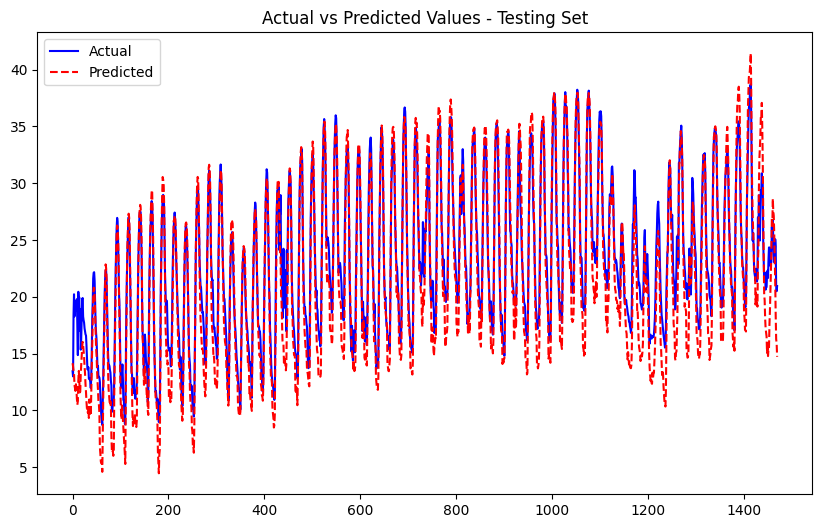

Processing node 7...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0584
Epoch [2/50], Train Loss: 0.0565
Epoch [3/50], Train Loss: 0.0548
Epoch [4/50], Train Loss: 0.0545
Epoch [5/50], Train Loss: 0.0544
Epoch [6/50], Train Loss: 0.0546
Epoch [7/50], Train Loss: 0.0555
Epoch [8/50], Train Loss: 0.0536
Epoch [9/50], Train Loss: 0.0543
Epoch [10/50], Train Loss: 0.0542
Epoch [11/50], Train Loss: 0.0536
Epoch [12/50], Train Loss: 0.0547
Epoch [13/50], Train Loss: 0.0533
Epoch [14/50], Train Loss: 0.0554
Epoch [15/50], Train Loss: 0.0535
Epoch [16/50], Train Loss: 0.0534
Epoch [17/50], Train Loss: 0.0538
Epoch [18/50], Train Loss: 0.0536
Epoch [19/50], Train Loss: 0.0537
Epoch [20/50], Train Loss: 0.0539
Epoch [21/50], Train Loss: 0.0551
Epoch [22/50], Train Loss: 0.0536
Epoch [23/50], Train Loss: 0.0532
Epoch [24/50], Train Loss: 0.0539
Epoch [25/50], Train Loss: 0.0541
Epoch [26/50], Train Loss: 0.0529
Epoch [27/50], Train Loss: 0.0532
Epoch [28/50], Train Loss: 0.0539
Epoch [29/50], Train Loss: 0.0540
Epoch [30/50], Train Lo

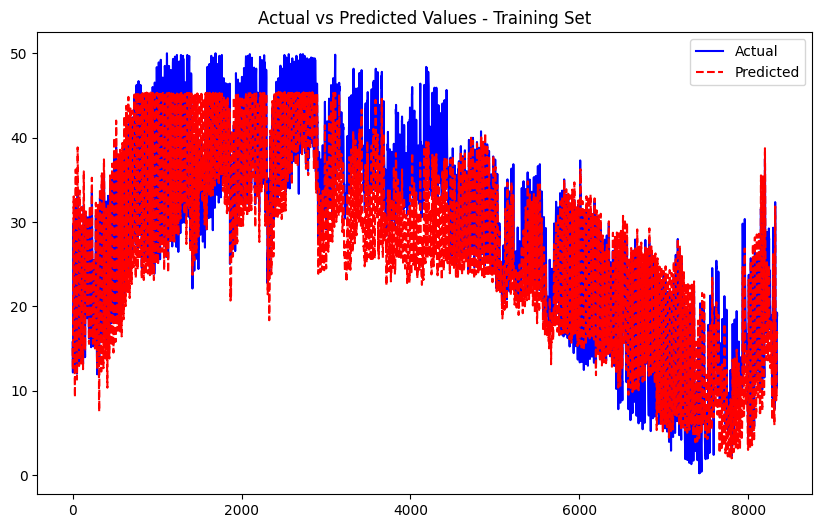

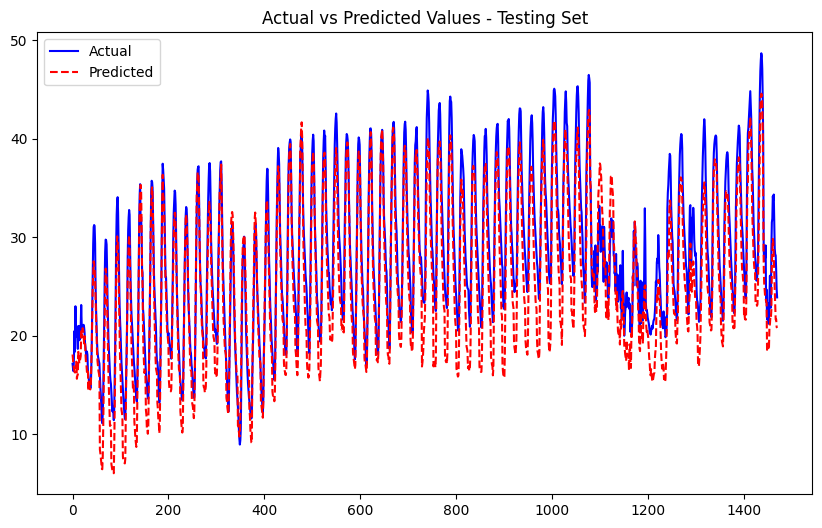

Processing node 8...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0642
Epoch [2/50], Train Loss: 0.0627
Epoch [3/50], Train Loss: 0.0614
Epoch [4/50], Train Loss: 0.0622
Epoch [5/50], Train Loss: 0.0606
Epoch [6/50], Train Loss: 0.0614
Epoch [7/50], Train Loss: 0.0608
Epoch [8/50], Train Loss: 0.0607
Epoch [9/50], Train Loss: 0.0616
Epoch [10/50], Train Loss: 0.0611
Epoch [11/50], Train Loss: 0.0620
Epoch [12/50], Train Loss: 0.0605
Epoch [13/50], Train Loss: 0.0606
Epoch [14/50], Train Loss: 0.0609
Epoch [15/50], Train Loss: 0.0612
Epoch [16/50], Train Loss: 0.0607
Epoch [17/50], Train Loss: 0.0601
Epoch [18/50], Train Loss: 0.0611
Epoch [19/50], Train Loss: 0.0600
Epoch [20/50], Train Loss: 0.0594
Epoch [21/50], Train Loss: 0.0604
Epoch [22/50], Train Loss: 0.0596
Epoch [23/50], Train Loss: 0.0598
Epoch [24/50], Train Loss: 0.0593
Epoch [25/50], Train Loss: 0.0604
Epoch [26/50], Train Loss: 0.0594
Epoch [27/50], Train Loss: 0.0594
Epoch [28/50], Train Loss: 0.0590
Epoch [29/50], Train Loss: 0.0586
Epoch [30/50], Train Lo

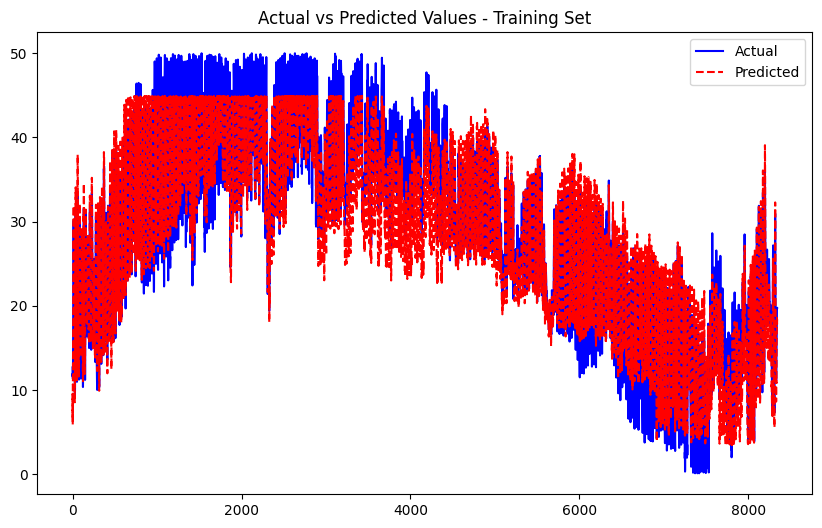

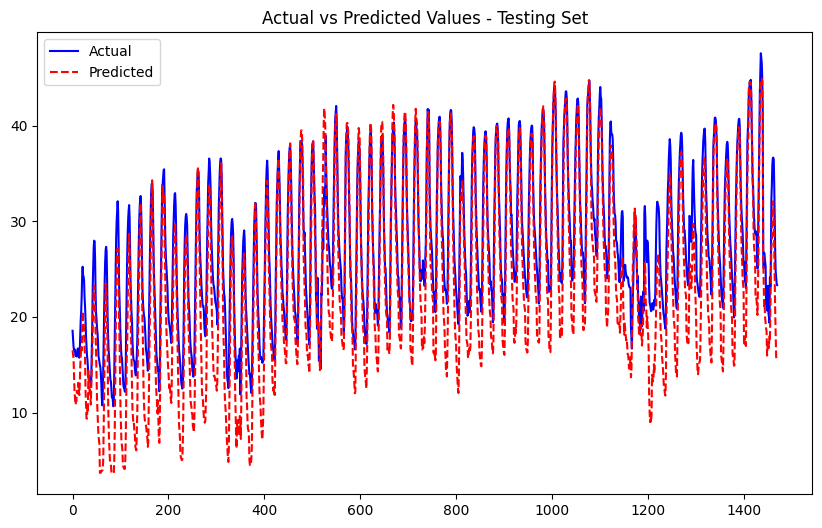

Processing node 9...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0511
Epoch [2/50], Train Loss: 0.0480
Epoch [3/50], Train Loss: 0.0474
Epoch [4/50], Train Loss: 0.0471
Epoch [5/50], Train Loss: 0.0461
Epoch [6/50], Train Loss: 0.0470
Epoch [7/50], Train Loss: 0.0460
Epoch [8/50], Train Loss: 0.0457
Epoch [9/50], Train Loss: 0.0460
Epoch [10/50], Train Loss: 0.0464
Epoch [11/50], Train Loss: 0.0455
Epoch [12/50], Train Loss: 0.0444
Epoch [13/50], Train Loss: 0.0454
Epoch [14/50], Train Loss: 0.0454
Epoch [15/50], Train Loss: 0.0453
Epoch [16/50], Train Loss: 0.0457
Epoch [17/50], Train Loss: 0.0449
Epoch [18/50], Train Loss: 0.0449
Epoch [19/50], Train Loss: 0.0451
Epoch [20/50], Train Loss: 0.0447
Epoch [21/50], Train Loss: 0.0445
Epoch [22/50], Train Loss: 0.0440
Epoch [23/50], Train Loss: 0.0439
Epoch [24/50], Train Loss: 0.0434
Epoch [25/50], Train Loss: 0.0441
Epoch [26/50], Train Loss: 0.0440
Epoch [27/50], Train Loss: 0.0440
Epoch [28/50], Train Loss: 0.0438
Epoch [29/50], Train Loss: 0.0438
Epoch [30/50], Train Lo

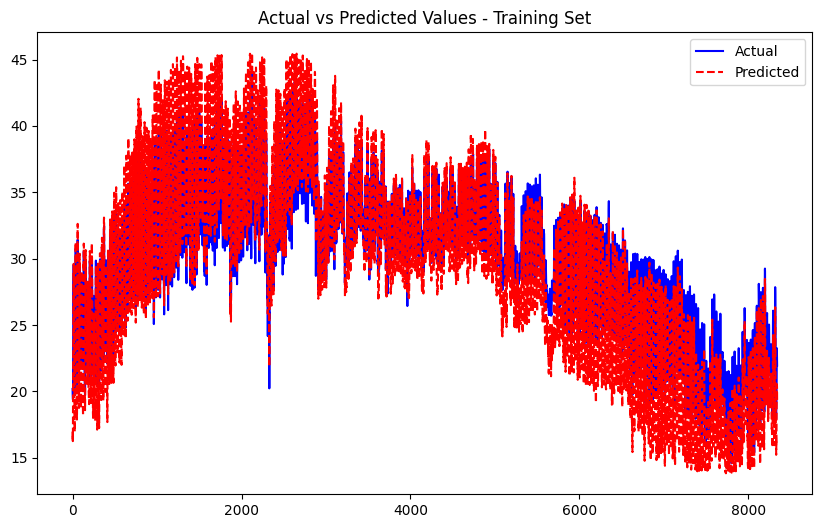

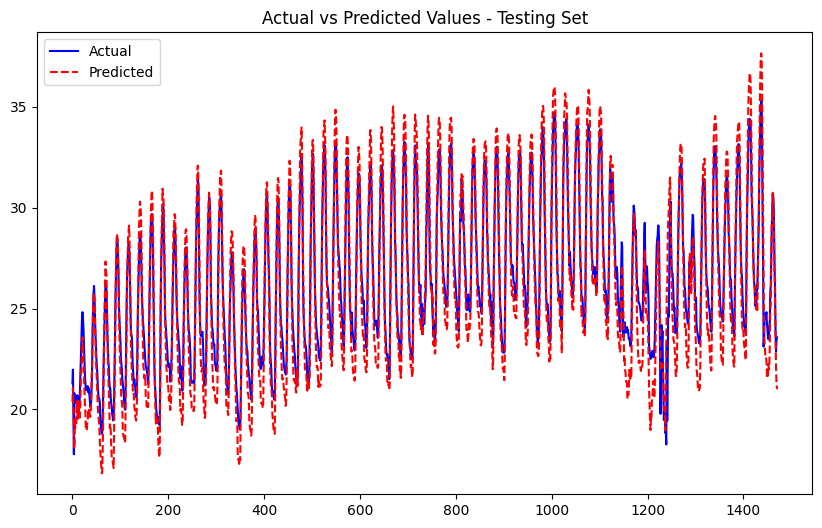

Processing node 10...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.4188
Epoch [2/50], Train Loss: 0.4625
Epoch [3/50], Train Loss: 0.4465
Epoch [4/50], Train Loss: 0.4051
Epoch [5/50], Train Loss: 0.3707
Epoch [6/50], Train Loss: 0.3513
Epoch [7/50], Train Loss: 0.3529
Epoch [8/50], Train Loss: 0.3339
Epoch [9/50], Train Loss: 0.3215
Epoch [10/50], Train Loss: 0.3181
Epoch [11/50], Train Loss: 0.3079
Epoch [12/50], Train Loss: 0.3088
Epoch [13/50], Train Loss: 0.3031
Epoch [14/50], Train Loss: 0.3035
Epoch [15/50], Train Loss: 0.3001
Epoch [16/50], Train Loss: 0.2937
Epoch [17/50], Train Loss: 0.3143
Epoch [18/50], Train Loss: 0.2888
Epoch [19/50], Train Loss: 0.2755
Epoch [20/50], Train Loss: 0.2825
Epoch [21/50], Train Loss: 0.2995
Epoch [22/50], Train Loss: 0.2944
Epoch [23/50], Train Loss: 0.2804
Epoch [24/50], Train Loss: 0.2909
Epoch [25/50], Train Loss: 0.2890
Epoch [26/50], Train Loss: 0.2759
Epoch [27/50], Train Loss: 0.2634
Epoch [28/50], Train Loss: 0.2534
Epoch [29/50], Train Loss: 0.2741
Epoch [30/50], Train Lo

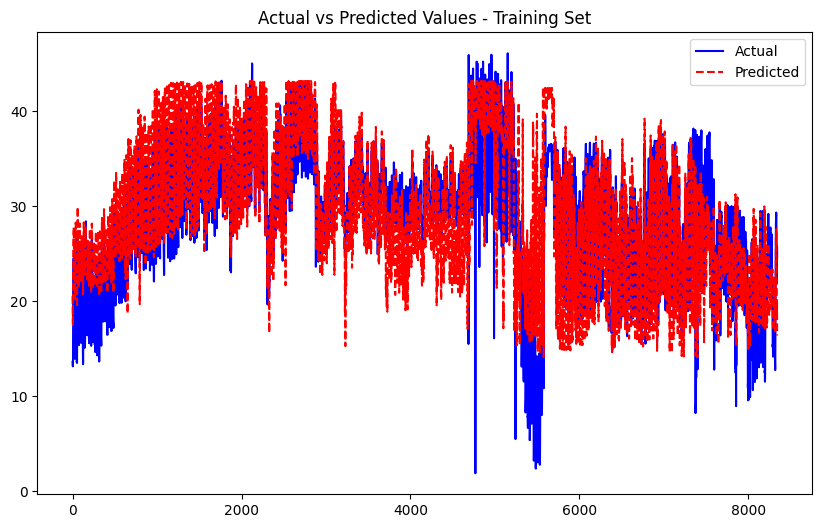

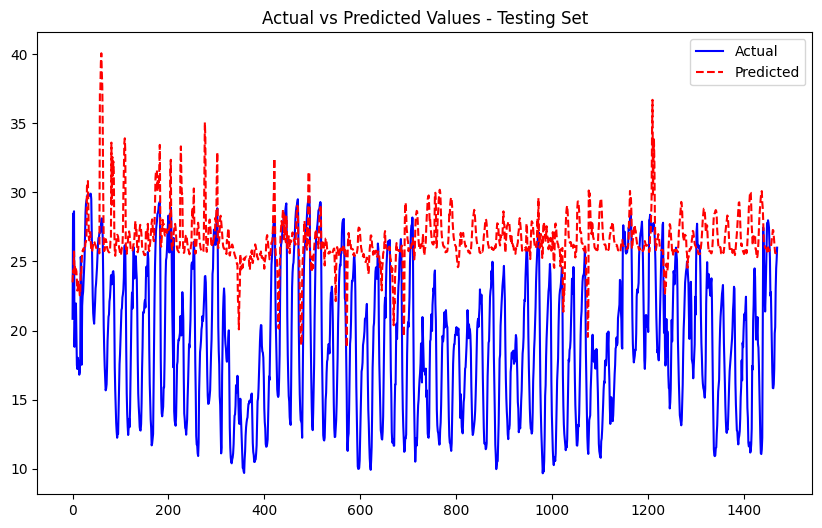

Processing node 11...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1184
Epoch [2/50], Train Loss: 0.0965
Epoch [3/50], Train Loss: 0.0877
Epoch [4/50], Train Loss: 0.0824
Epoch [5/50], Train Loss: 0.0794
Epoch [6/50], Train Loss: 0.0747
Epoch [7/50], Train Loss: 0.0732
Epoch [8/50], Train Loss: 0.0711
Epoch [9/50], Train Loss: 0.0676
Epoch [10/50], Train Loss: 0.0685
Epoch [11/50], Train Loss: 0.0662
Epoch [12/50], Train Loss: 0.0696
Epoch [13/50], Train Loss: 0.0675
Epoch [14/50], Train Loss: 0.0665
Epoch [15/50], Train Loss: 0.0637
Epoch [16/50], Train Loss: 0.0643
Epoch [17/50], Train Loss: 0.0648
Epoch [18/50], Train Loss: 0.0645
Epoch [19/50], Train Loss: 0.0657
Epoch [20/50], Train Loss: 0.0636
Epoch [21/50], Train Loss: 0.0635
Epoch [22/50], Train Loss: 0.0634
Epoch [23/50], Train Loss: 0.0631
Epoch [24/50], Train Loss: 0.0625
Epoch [25/50], Train Loss: 0.0625
Epoch [26/50], Train Loss: 0.0619
Epoch [27/50], Train Loss: 0.0625
Epoch [28/50], Train Loss: 0.0628
Epoch [29/50], Train Loss: 0.0621
Epoch [30/50], Train Lo

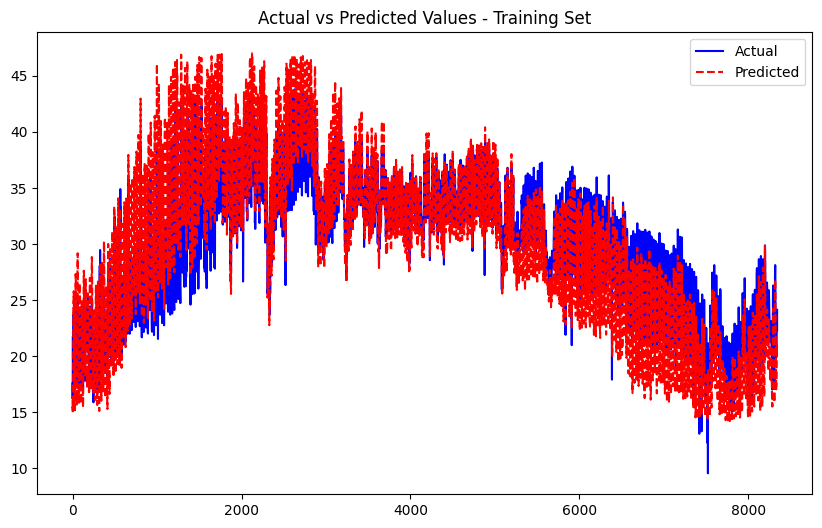

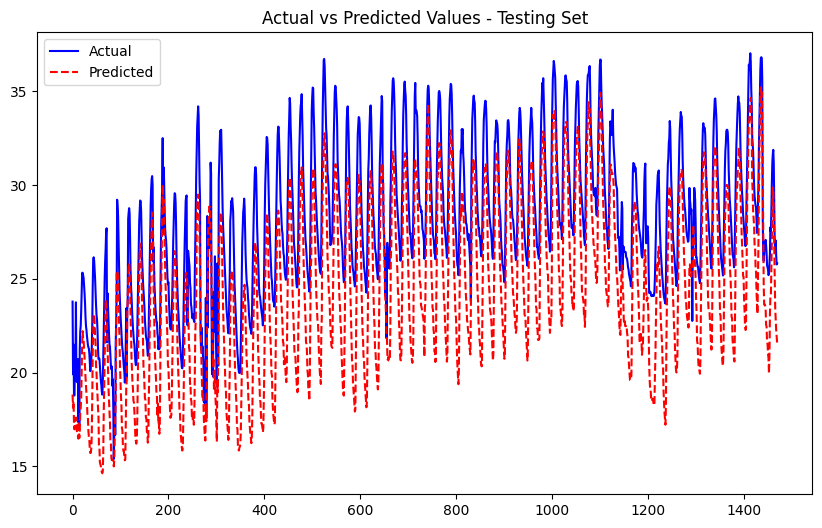

Processing node 12...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0398
Epoch [2/50], Train Loss: 0.0383
Epoch [3/50], Train Loss: 0.0371
Epoch [4/50], Train Loss: 0.0359
Epoch [5/50], Train Loss: 0.0362
Epoch [6/50], Train Loss: 0.0368
Epoch [7/50], Train Loss: 0.0358
Epoch [8/50], Train Loss: 0.0363
Epoch [9/50], Train Loss: 0.0368
Epoch [10/50], Train Loss: 0.0359
Epoch [11/50], Train Loss: 0.0356
Epoch [12/50], Train Loss: 0.0359
Epoch [13/50], Train Loss: 0.0353
Epoch [14/50], Train Loss: 0.0349
Epoch [15/50], Train Loss: 0.0356
Epoch [16/50], Train Loss: 0.0380
Epoch [17/50], Train Loss: 0.0379
Epoch [18/50], Train Loss: 0.0372
Epoch [19/50], Train Loss: 0.0375
Epoch [20/50], Train Loss: 0.0369
Epoch [21/50], Train Loss: 0.0357
Epoch [22/50], Train Loss: 0.0354
Epoch [23/50], Train Loss: 0.0351
Epoch [24/50], Train Loss: 0.0362
Epoch [25/50], Train Loss: 0.0356
Epoch [26/50], Train Loss: 0.0355
Epoch [27/50], Train Loss: 0.0349
Epoch [28/50], Train Loss: 0.0351
Epoch [29/50], Train Loss: 0.0349
Epoch [30/50], Train Lo

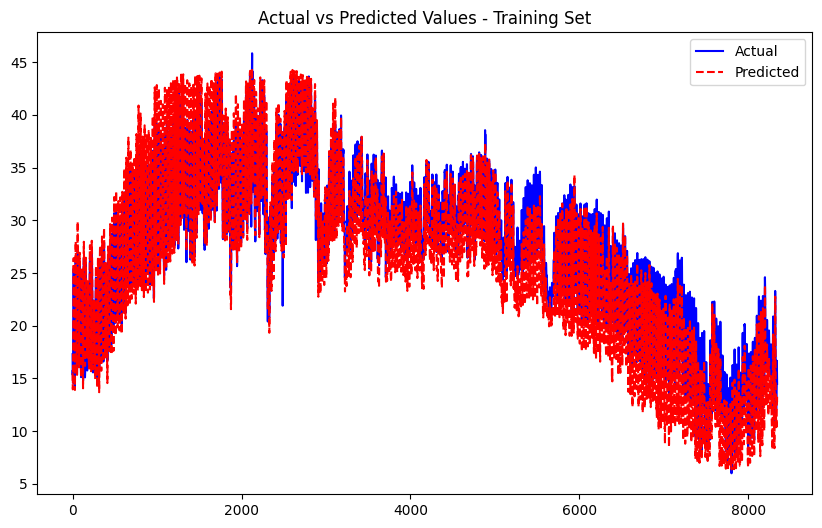

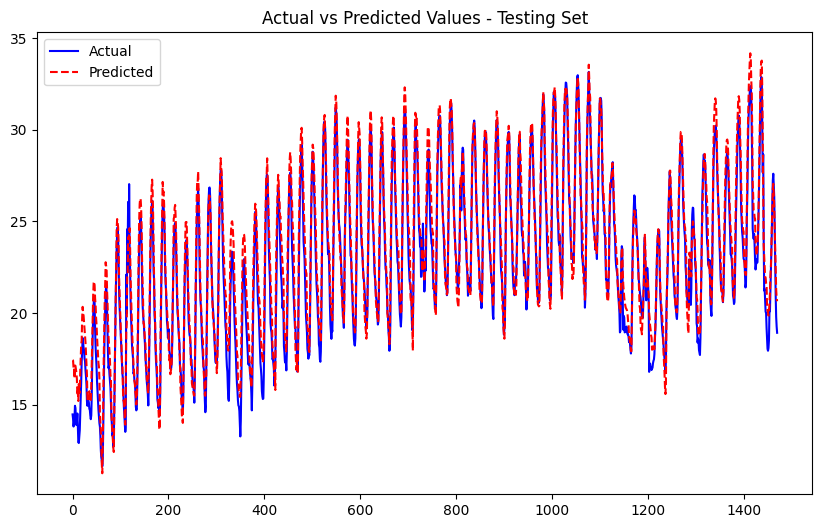

Processing node 13...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0938
Epoch [2/50], Train Loss: 0.1024
Epoch [3/50], Train Loss: 0.0983
Epoch [4/50], Train Loss: 0.0967
Epoch [5/50], Train Loss: 0.0961
Epoch [6/50], Train Loss: 0.1000
Epoch [7/50], Train Loss: 0.1101
Epoch [8/50], Train Loss: 0.1065
Epoch [9/50], Train Loss: 0.1044
Epoch [10/50], Train Loss: 0.0979
Epoch [11/50], Train Loss: 0.1019
Epoch [12/50], Train Loss: 0.1005
Epoch [13/50], Train Loss: 0.0959
Epoch [14/50], Train Loss: 0.0966
Epoch [15/50], Train Loss: 0.1028
Epoch [16/50], Train Loss: 0.1035
Epoch [17/50], Train Loss: 0.0987
Epoch [18/50], Train Loss: 0.0986
Epoch [19/50], Train Loss: 0.0987
Epoch [20/50], Train Loss: 0.0980
Epoch [21/50], Train Loss: 0.0997
Epoch [22/50], Train Loss: 0.1014
Epoch [23/50], Train Loss: 0.1046
Epoch [24/50], Train Loss: 0.1127
Epoch [25/50], Train Loss: 0.1092
Epoch [26/50], Train Loss: 0.1004
Epoch [27/50], Train Loss: 0.0998
Epoch [28/50], Train Loss: 0.1000
Epoch [29/50], Train Loss: 0.1040
Epoch [30/50], Train Lo

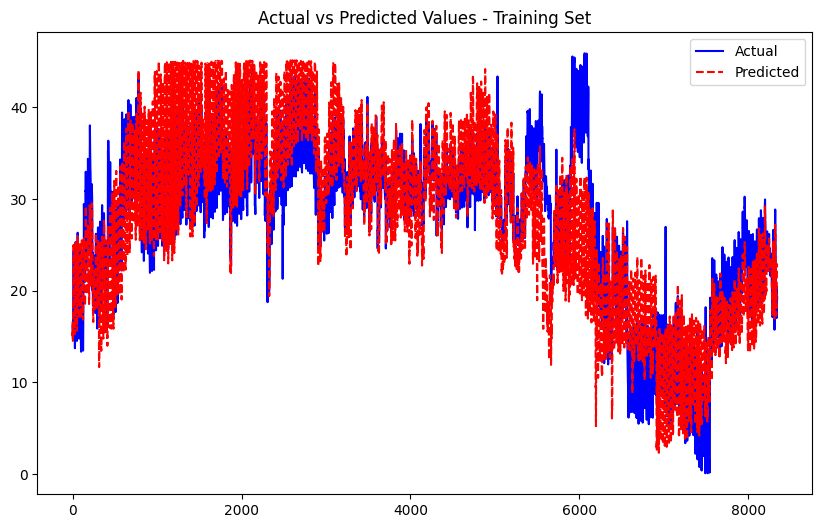

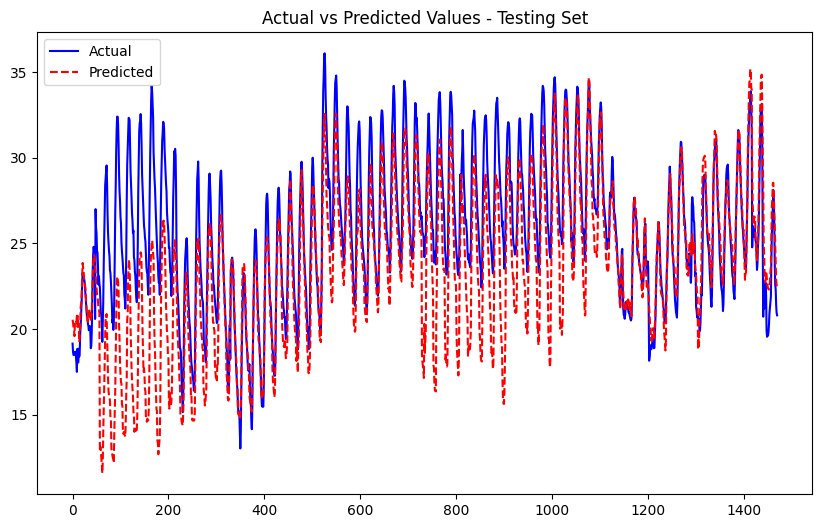

Processing node 14...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0664
Epoch [2/50], Train Loss: 0.0624
Epoch [3/50], Train Loss: 0.0568
Epoch [4/50], Train Loss: 0.0559
Epoch [5/50], Train Loss: 0.0538
Epoch [6/50], Train Loss: 0.0530
Epoch [7/50], Train Loss: 0.0524
Epoch [8/50], Train Loss: 0.0521
Epoch [9/50], Train Loss: 0.0526
Epoch [10/50], Train Loss: 0.0508
Epoch [11/50], Train Loss: 0.0504
Epoch [12/50], Train Loss: 0.0502
Epoch [13/50], Train Loss: 0.0498
Epoch [14/50], Train Loss: 0.0498
Epoch [15/50], Train Loss: 0.0497
Epoch [16/50], Train Loss: 0.0496
Epoch [17/50], Train Loss: 0.0497
Epoch [18/50], Train Loss: 0.0488
Epoch [19/50], Train Loss: 0.0488
Epoch [20/50], Train Loss: 0.0491
Epoch [21/50], Train Loss: 0.0485
Epoch [22/50], Train Loss: 0.0503
Epoch [23/50], Train Loss: 0.0484
Epoch [24/50], Train Loss: 0.0491
Epoch [25/50], Train Loss: 0.0497
Epoch [26/50], Train Loss: 0.0491
Epoch [27/50], Train Loss: 0.0490
Epoch [28/50], Train Loss: 0.0485
Epoch [29/50], Train Loss: 0.0476
Epoch [30/50], Train Lo

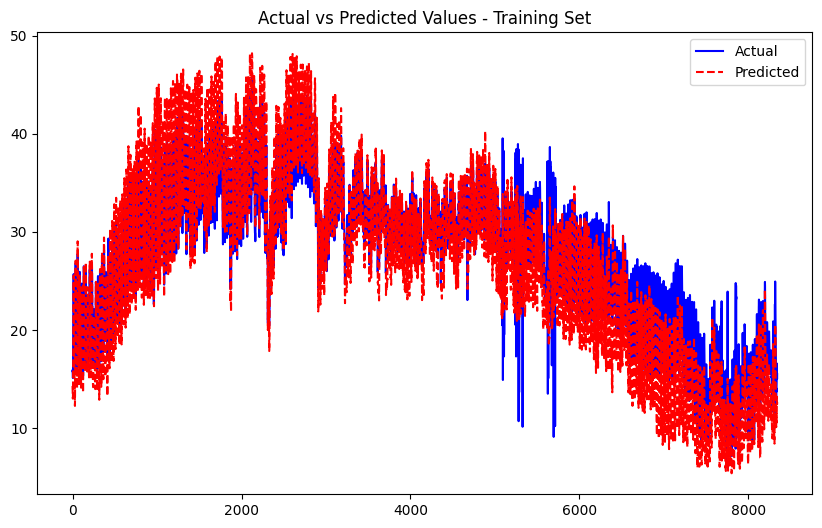

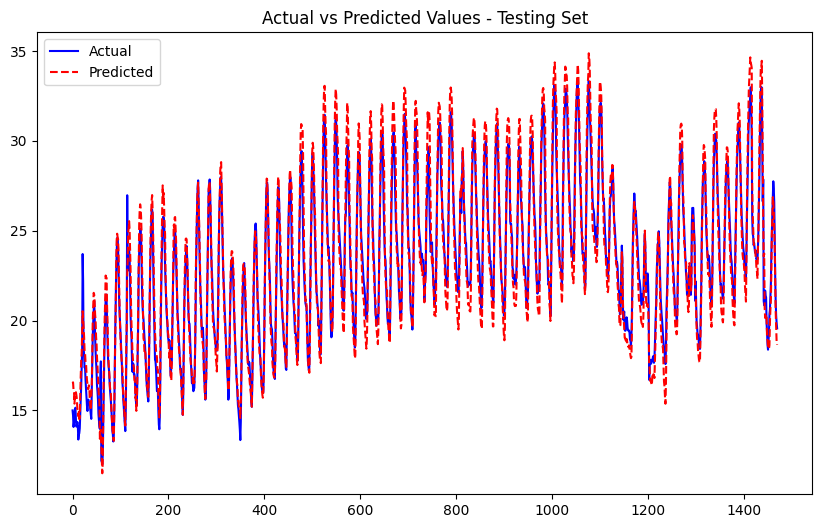

Processing node 15...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0638
Epoch [2/50], Train Loss: 0.0634
Epoch [3/50], Train Loss: 0.0641
Epoch [4/50], Train Loss: 0.0631
Epoch [5/50], Train Loss: 0.0645
Epoch [6/50], Train Loss: 0.0625
Epoch [7/50], Train Loss: 0.0629
Epoch [8/50], Train Loss: 0.0635
Epoch [9/50], Train Loss: 0.0640
Epoch [10/50], Train Loss: 0.0624
Epoch [11/50], Train Loss: 0.0633
Epoch [12/50], Train Loss: 0.0622
Epoch [13/50], Train Loss: 0.0621
Epoch [14/50], Train Loss: 0.0629
Epoch [15/50], Train Loss: 0.0632
Epoch [16/50], Train Loss: 0.0633
Epoch [17/50], Train Loss: 0.0625
Epoch [18/50], Train Loss: 0.0625
Epoch [19/50], Train Loss: 0.0636
Epoch [20/50], Train Loss: 0.0628
Epoch [21/50], Train Loss: 0.0629
Epoch [22/50], Train Loss: 0.0636
Epoch [23/50], Train Loss: 0.0632
Epoch [24/50], Train Loss: 0.0635
Epoch [25/50], Train Loss: 0.0639
Epoch [26/50], Train Loss: 0.0632
Epoch [27/50], Train Loss: 0.0631
Epoch [28/50], Train Loss: 0.0641
Epoch [29/50], Train Loss: 0.0629
Epoch [30/50], Train Lo

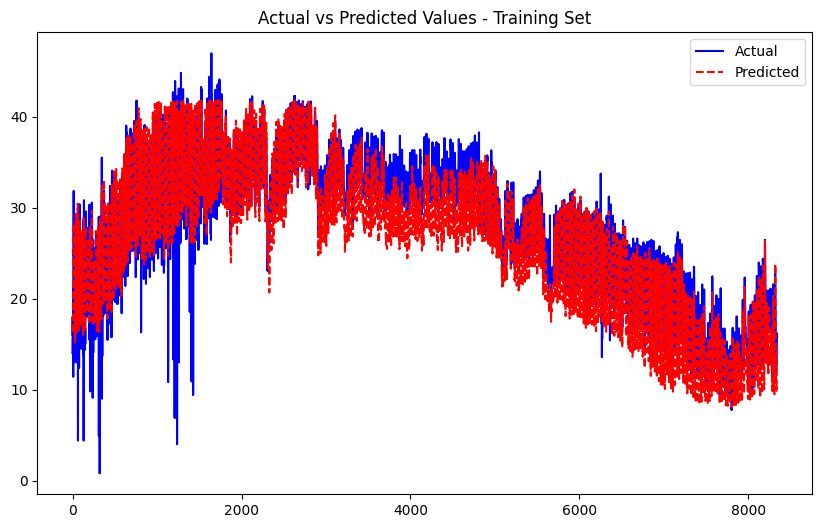

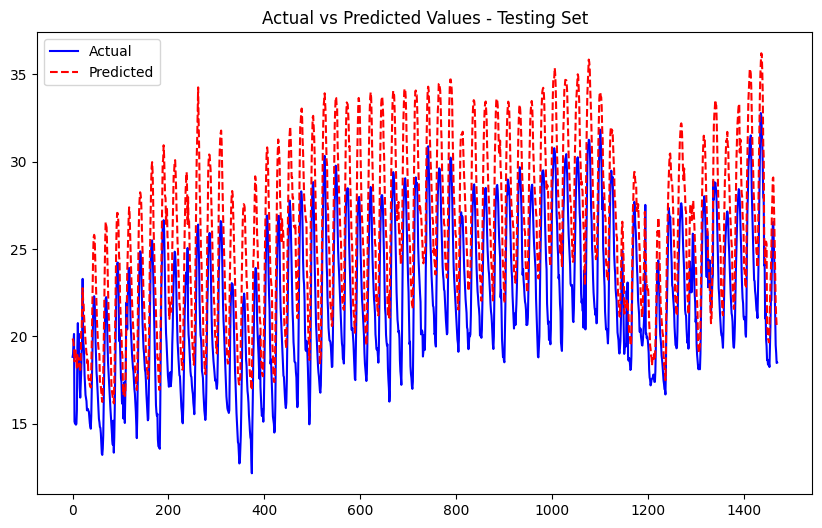

Processing node 16...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1064
Epoch [2/50], Train Loss: 0.1059
Epoch [3/50], Train Loss: 0.1044
Epoch [4/50], Train Loss: 0.1033
Epoch [5/50], Train Loss: 0.1026
Epoch [6/50], Train Loss: 0.1048
Epoch [7/50], Train Loss: 0.1053
Epoch [8/50], Train Loss: 0.1023
Epoch [9/50], Train Loss: 0.1028
Epoch [10/50], Train Loss: 0.1035
Epoch [11/50], Train Loss: 0.1026
Epoch [12/50], Train Loss: 0.1010
Epoch [13/50], Train Loss: 0.0999
Epoch [14/50], Train Loss: 0.1005
Epoch [15/50], Train Loss: 0.1008
Epoch [16/50], Train Loss: 0.1035
Epoch [17/50], Train Loss: 0.1011
Epoch [18/50], Train Loss: 0.0999
Epoch [19/50], Train Loss: 0.1023
Epoch [20/50], Train Loss: 0.0984
Epoch [21/50], Train Loss: 0.1025
Epoch [22/50], Train Loss: 0.0997
Epoch [23/50], Train Loss: 0.1028
Epoch [24/50], Train Loss: 0.0998
Epoch [25/50], Train Loss: 0.0999
Epoch [26/50], Train Loss: 0.1044
Epoch [27/50], Train Loss: 0.1003
Epoch [28/50], Train Loss: 0.0980
Epoch [29/50], Train Loss: 0.0976
Epoch [30/50], Train Lo

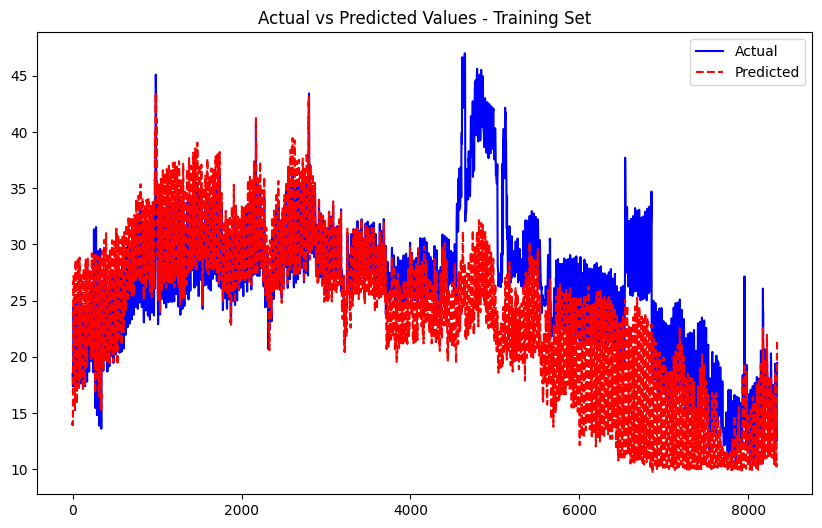

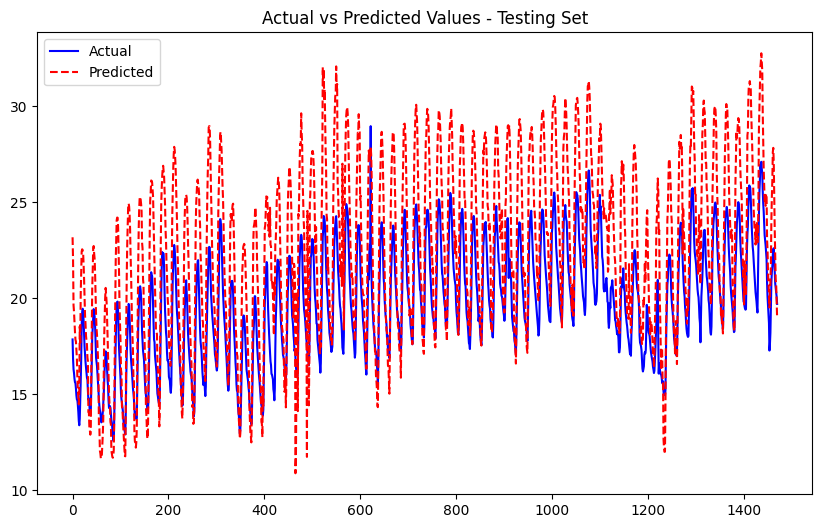

Processing node 17...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0542
Epoch [2/50], Train Loss: 0.0508
Epoch [3/50], Train Loss: 0.0496
Epoch [4/50], Train Loss: 0.0482
Epoch [5/50], Train Loss: 0.0486
Epoch [6/50], Train Loss: 0.0470
Epoch [7/50], Train Loss: 0.0473
Epoch [8/50], Train Loss: 0.0470
Epoch [9/50], Train Loss: 0.0464
Epoch [10/50], Train Loss: 0.0454
Epoch [11/50], Train Loss: 0.0458
Epoch [12/50], Train Loss: 0.0472
Epoch [13/50], Train Loss: 0.0471
Epoch [14/50], Train Loss: 0.0459
Epoch [15/50], Train Loss: 0.0450
Epoch [16/50], Train Loss: 0.0450
Epoch [17/50], Train Loss: 0.0443
Epoch [18/50], Train Loss: 0.0454
Epoch [19/50], Train Loss: 0.0445
Epoch [20/50], Train Loss: 0.0442
Epoch [21/50], Train Loss: 0.0449
Epoch [22/50], Train Loss: 0.0440
Epoch [23/50], Train Loss: 0.0448
Epoch [24/50], Train Loss: 0.0441
Epoch [25/50], Train Loss: 0.0437
Epoch [26/50], Train Loss: 0.0453
Epoch [27/50], Train Loss: 0.0443
Epoch [28/50], Train Loss: 0.0439
Epoch [29/50], Train Loss: 0.0442
Epoch [30/50], Train Lo

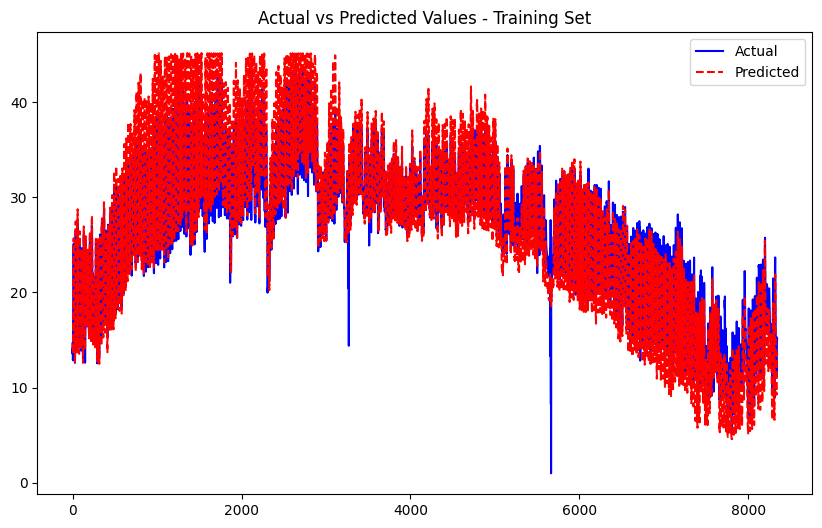

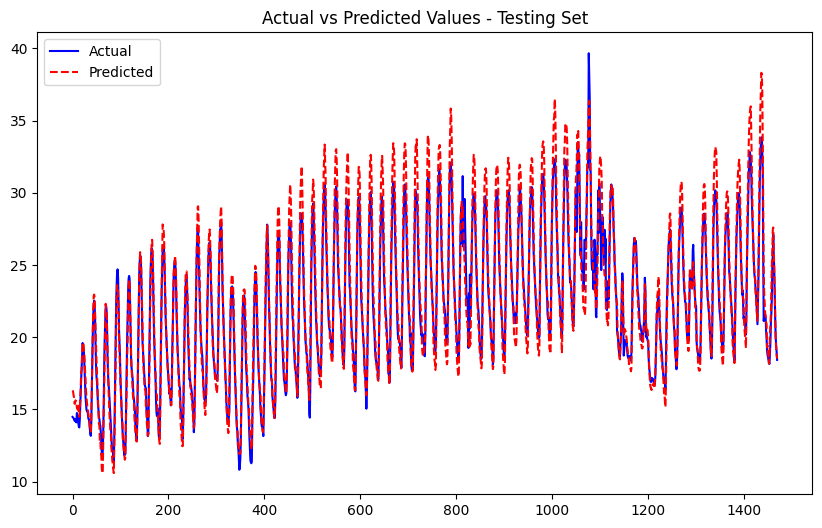

Processing node 18...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0414
Epoch [2/50], Train Loss: 0.0403
Epoch [3/50], Train Loss: 0.0398
Epoch [4/50], Train Loss: 0.0392
Epoch [5/50], Train Loss: 0.0401
Epoch [6/50], Train Loss: 0.0399
Epoch [7/50], Train Loss: 0.0383
Epoch [8/50], Train Loss: 0.0382
Epoch [9/50], Train Loss: 0.0385
Epoch [10/50], Train Loss: 0.0381
Epoch [11/50], Train Loss: 0.0394
Epoch [12/50], Train Loss: 0.0387
Epoch [13/50], Train Loss: 0.0393
Epoch [14/50], Train Loss: 0.0390
Epoch [15/50], Train Loss: 0.0390
Epoch [16/50], Train Loss: 0.0385
Epoch [17/50], Train Loss: 0.0384
Epoch [18/50], Train Loss: 0.0388
Epoch [19/50], Train Loss: 0.0392
Epoch [20/50], Train Loss: 0.0384
Epoch [21/50], Train Loss: 0.0385
Epoch [22/50], Train Loss: 0.0385
Epoch [23/50], Train Loss: 0.0388
Epoch [24/50], Train Loss: 0.0388
Epoch [25/50], Train Loss: 0.0384
Epoch [26/50], Train Loss: 0.0390
Epoch [27/50], Train Loss: 0.0387
Epoch [28/50], Train Loss: 0.0384
Epoch [29/50], Train Loss: 0.0385
Epoch [30/50], Train Lo

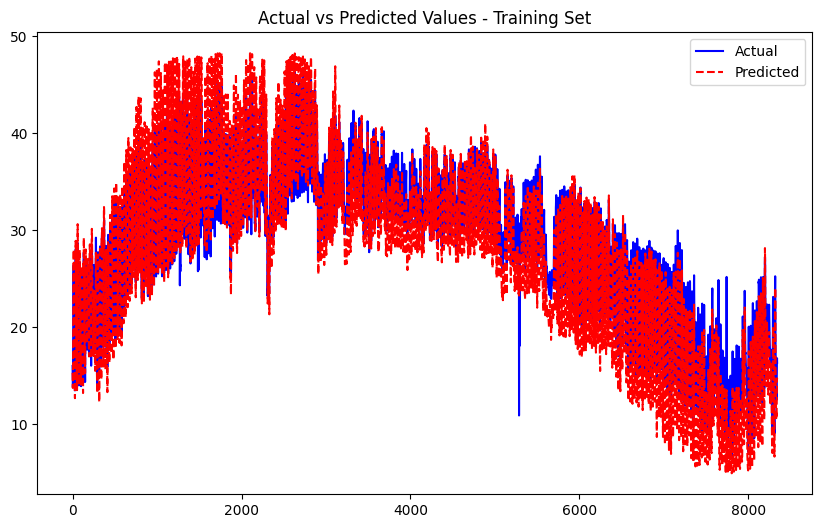

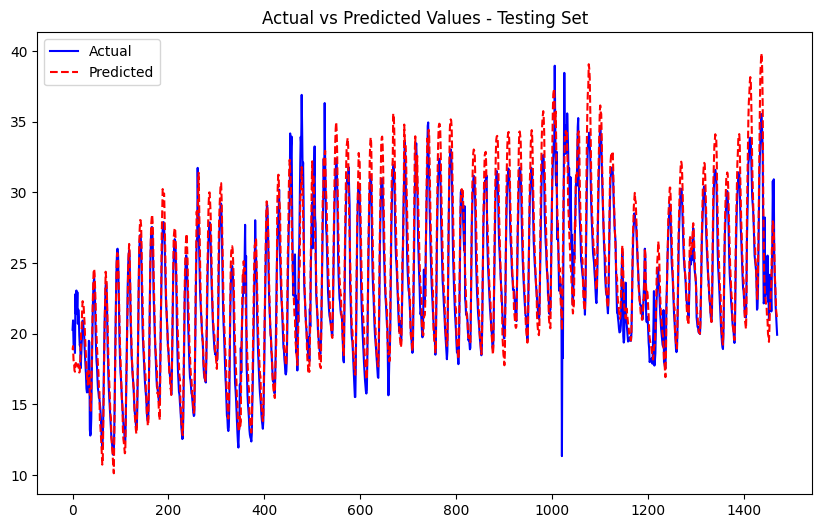

Processing node 19...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0812
Epoch [2/50], Train Loss: 0.0792
Epoch [3/50], Train Loss: 0.0789
Epoch [4/50], Train Loss: 0.0773
Epoch [5/50], Train Loss: 0.0769
Epoch [6/50], Train Loss: 0.0751
Epoch [7/50], Train Loss: 0.0746
Epoch [8/50], Train Loss: 0.0762
Epoch [9/50], Train Loss: 0.0741
Epoch [10/50], Train Loss: 0.0732
Epoch [11/50], Train Loss: 0.0727
Epoch [12/50], Train Loss: 0.0725
Epoch [13/50], Train Loss: 0.0744
Epoch [14/50], Train Loss: 0.0720
Epoch [15/50], Train Loss: 0.0724
Epoch [16/50], Train Loss: 0.0728
Epoch [17/50], Train Loss: 0.0726
Epoch [18/50], Train Loss: 0.0742
Epoch [19/50], Train Loss: 0.0734
Epoch [20/50], Train Loss: 0.0727
Epoch [21/50], Train Loss: 0.0707
Epoch [22/50], Train Loss: 0.0705
Epoch [23/50], Train Loss: 0.0715
Epoch [24/50], Train Loss: 0.0689
Epoch [25/50], Train Loss: 0.0704
Epoch [26/50], Train Loss: 0.0695
Epoch [27/50], Train Loss: 0.0697
Epoch [28/50], Train Loss: 0.0700
Epoch [29/50], Train Loss: 0.0686
Epoch [30/50], Train Lo

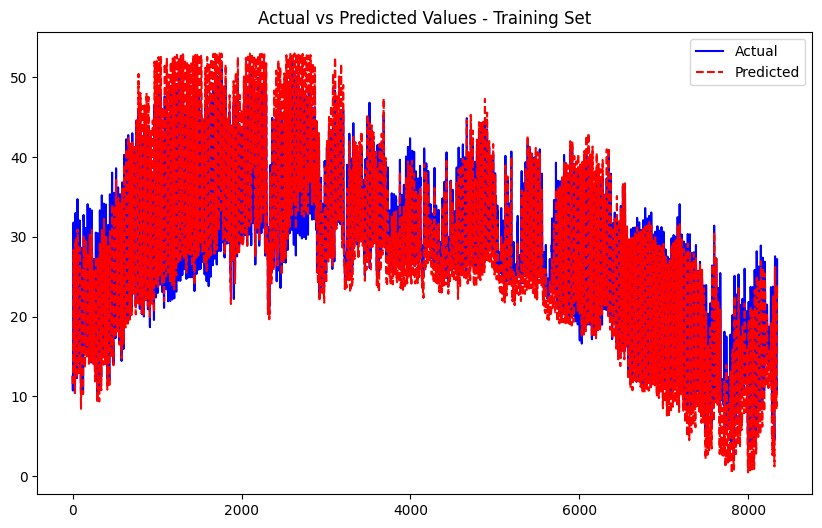

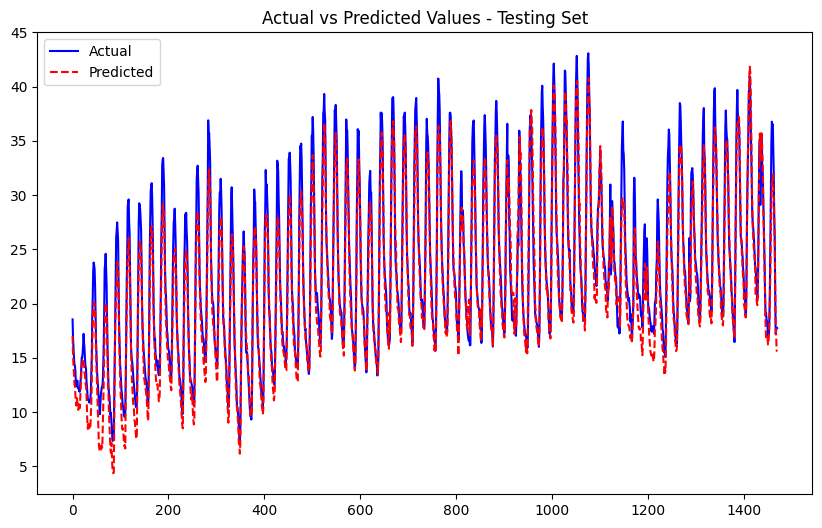

Processing node 20...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0541
Epoch [2/50], Train Loss: 0.0534
Epoch [3/50], Train Loss: 0.0529
Epoch [4/50], Train Loss: 0.0521
Epoch [5/50], Train Loss: 0.0520
Epoch [6/50], Train Loss: 0.0520
Epoch [7/50], Train Loss: 0.0526
Epoch [8/50], Train Loss: 0.0522
Epoch [9/50], Train Loss: 0.0523
Epoch [10/50], Train Loss: 0.0537
Epoch [11/50], Train Loss: 0.0520
Epoch [12/50], Train Loss: 0.0525
Epoch [13/50], Train Loss: 0.0520
Epoch [14/50], Train Loss: 0.0522
Epoch [15/50], Train Loss: 0.0527
Epoch [16/50], Train Loss: 0.0526
Epoch [17/50], Train Loss: 0.0524
Epoch [18/50], Train Loss: 0.0523
Epoch [19/50], Train Loss: 0.0514
Epoch [20/50], Train Loss: 0.0527
Epoch [21/50], Train Loss: 0.0520
Epoch [22/50], Train Loss: 0.0511
Epoch [23/50], Train Loss: 0.0518
Epoch [24/50], Train Loss: 0.0522
Epoch [25/50], Train Loss: 0.0518
Epoch [26/50], Train Loss: 0.0521
Epoch [27/50], Train Loss: 0.0514
Epoch [28/50], Train Loss: 0.0513
Epoch [29/50], Train Loss: 0.0513
Epoch [30/50], Train Lo

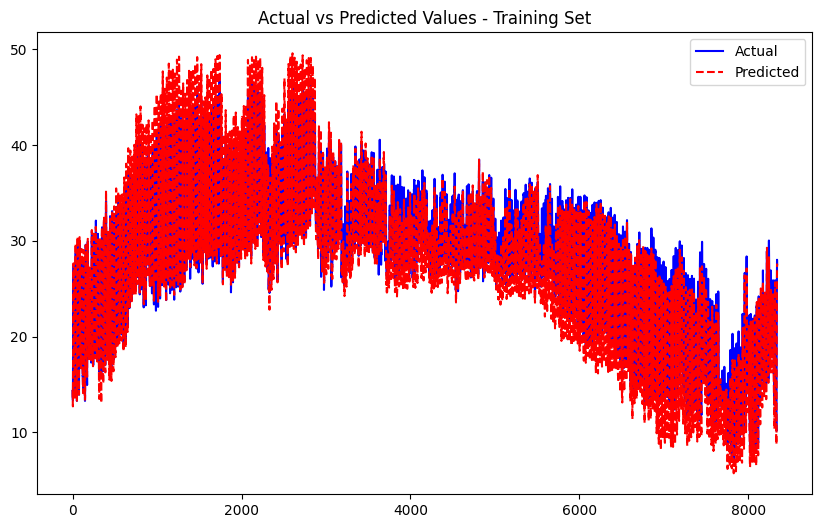

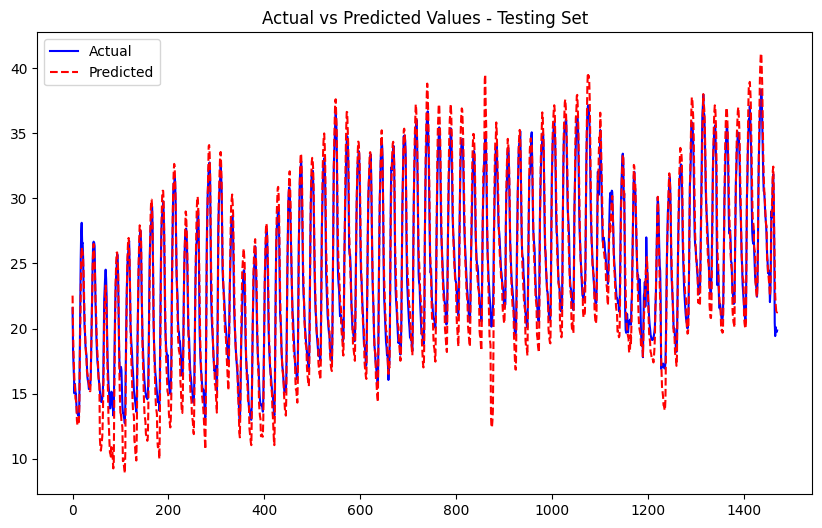

Processing node 21...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0568
Epoch [2/50], Train Loss: 0.0546
Epoch [3/50], Train Loss: 0.0557
Epoch [4/50], Train Loss: 0.0536
Epoch [5/50], Train Loss: 0.0544
Epoch [6/50], Train Loss: 0.0536
Epoch [7/50], Train Loss: 0.0539
Epoch [8/50], Train Loss: 0.0543
Epoch [9/50], Train Loss: 0.0528
Epoch [10/50], Train Loss: 0.0531
Epoch [11/50], Train Loss: 0.0526
Epoch [12/50], Train Loss: 0.0527
Epoch [13/50], Train Loss: 0.0521
Epoch [14/50], Train Loss: 0.0525
Epoch [15/50], Train Loss: 0.0526
Epoch [16/50], Train Loss: 0.0531
Epoch [17/50], Train Loss: 0.0526
Epoch [18/50], Train Loss: 0.0525
Epoch [19/50], Train Loss: 0.0517
Epoch [20/50], Train Loss: 0.0520
Epoch [21/50], Train Loss: 0.0518
Epoch [22/50], Train Loss: 0.0523
Epoch [23/50], Train Loss: 0.0517
Epoch [24/50], Train Loss: 0.0517
Epoch [25/50], Train Loss: 0.0510
Epoch [26/50], Train Loss: 0.0520
Epoch [27/50], Train Loss: 0.0515
Epoch [28/50], Train Loss: 0.0508
Epoch [29/50], Train Loss: 0.0513
Epoch [30/50], Train Lo

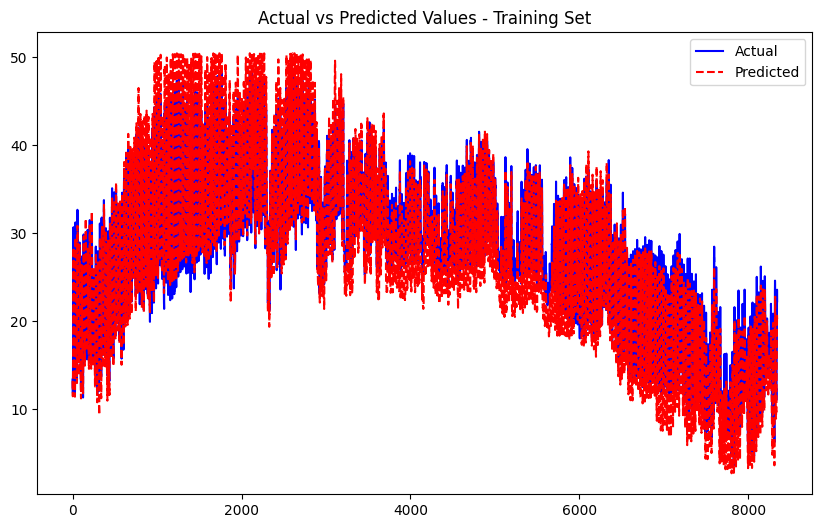

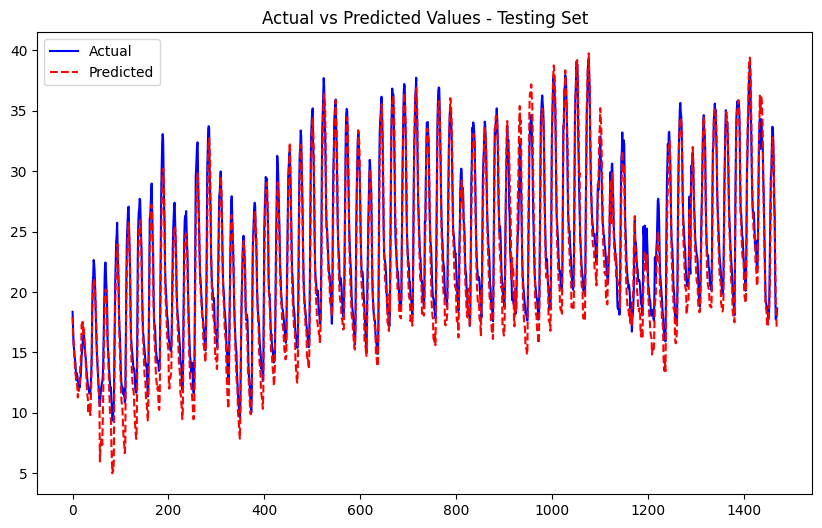

Processing node 22...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0682
Epoch [2/50], Train Loss: 0.0683
Epoch [3/50], Train Loss: 0.0666
Epoch [4/50], Train Loss: 0.0660
Epoch [5/50], Train Loss: 0.0667
Epoch [6/50], Train Loss: 0.0652
Epoch [7/50], Train Loss: 0.0648
Epoch [8/50], Train Loss: 0.0660
Epoch [9/50], Train Loss: 0.0650
Epoch [10/50], Train Loss: 0.0645
Epoch [11/50], Train Loss: 0.0649
Epoch [12/50], Train Loss: 0.0641
Epoch [13/50], Train Loss: 0.0635
Epoch [14/50], Train Loss: 0.0634
Epoch [15/50], Train Loss: 0.0636
Epoch [16/50], Train Loss: 0.0631
Epoch [17/50], Train Loss: 0.0644
Epoch [18/50], Train Loss: 0.0640
Epoch [19/50], Train Loss: 0.0627
Epoch [20/50], Train Loss: 0.0631
Epoch [21/50], Train Loss: 0.0636
Epoch [22/50], Train Loss: 0.0632
Epoch [23/50], Train Loss: 0.0622
Epoch [24/50], Train Loss: 0.0620
Epoch [25/50], Train Loss: 0.0628
Epoch [26/50], Train Loss: 0.0635
Epoch [27/50], Train Loss: 0.0632
Epoch [28/50], Train Loss: 0.0622
Epoch [29/50], Train Loss: 0.0637
Epoch [30/50], Train Lo

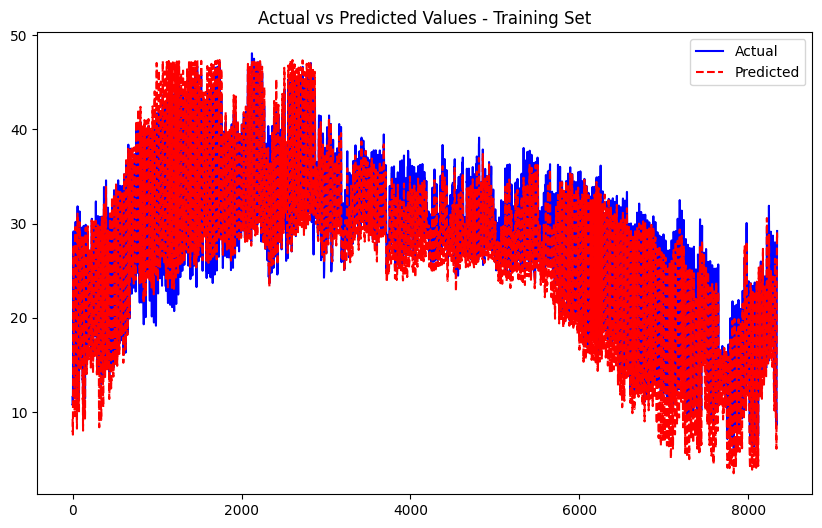

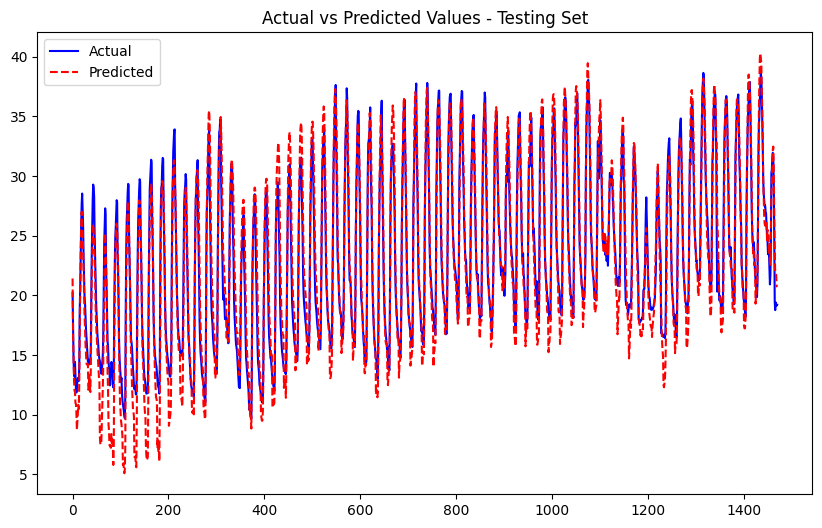

Processing node 23...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0692
Epoch [2/50], Train Loss: 0.0678
Epoch [3/50], Train Loss: 0.0678
Epoch [4/50], Train Loss: 0.0659
Epoch [5/50], Train Loss: 0.0659
Epoch [6/50], Train Loss: 0.0655
Epoch [7/50], Train Loss: 0.0654
Epoch [8/50], Train Loss: 0.0651
Epoch [9/50], Train Loss: 0.0643
Epoch [10/50], Train Loss: 0.0632
Epoch [11/50], Train Loss: 0.0637
Epoch [12/50], Train Loss: 0.0641
Epoch [13/50], Train Loss: 0.0640
Epoch [14/50], Train Loss: 0.0638
Epoch [15/50], Train Loss: 0.0642
Epoch [16/50], Train Loss: 0.0641
Epoch [17/50], Train Loss: 0.0640
Epoch [18/50], Train Loss: 0.0638
Epoch [19/50], Train Loss: 0.0641
Epoch [20/50], Train Loss: 0.0638
Epoch [21/50], Train Loss: 0.0628
Epoch [22/50], Train Loss: 0.0634
Epoch [23/50], Train Loss: 0.0636
Epoch [24/50], Train Loss: 0.0642
Epoch [25/50], Train Loss: 0.0624
Epoch [26/50], Train Loss: 0.0618
Epoch [27/50], Train Loss: 0.0636
Epoch [28/50], Train Loss: 0.0634
Epoch [29/50], Train Loss: 0.0627
Epoch [30/50], Train Lo

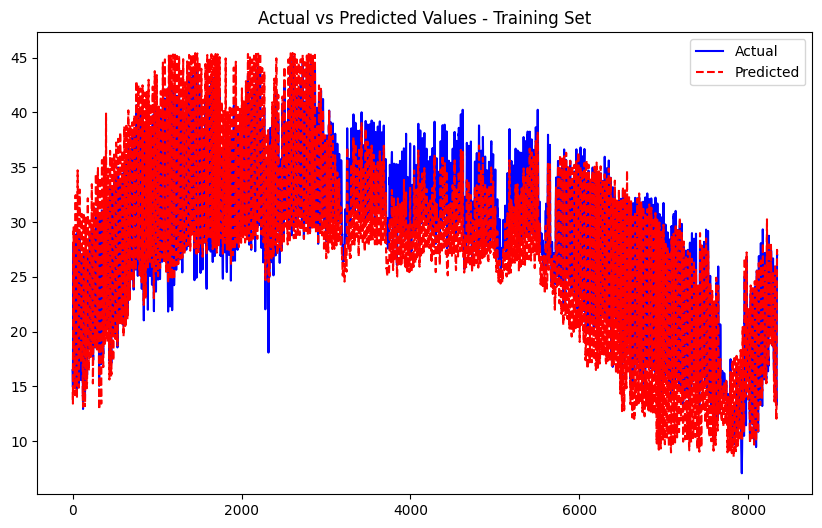

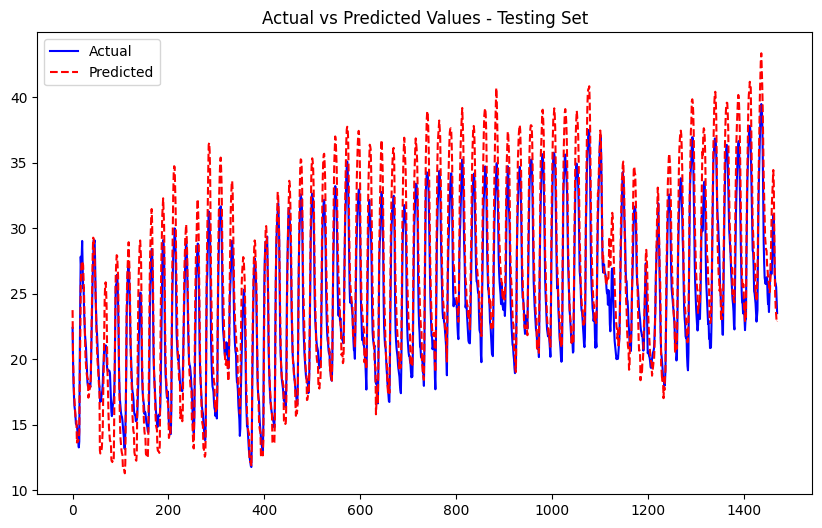

Processing node 24...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0513
Epoch [2/50], Train Loss: 0.0499
Epoch [3/50], Train Loss: 0.0488
Epoch [4/50], Train Loss: 0.0480
Epoch [5/50], Train Loss: 0.0472
Epoch [6/50], Train Loss: 0.0470
Epoch [7/50], Train Loss: 0.0471
Epoch [8/50], Train Loss: 0.0469
Epoch [9/50], Train Loss: 0.0473
Epoch [10/50], Train Loss: 0.0474
Epoch [11/50], Train Loss: 0.0469
Epoch [12/50], Train Loss: 0.0465
Epoch [13/50], Train Loss: 0.0470
Epoch [14/50], Train Loss: 0.0476
Epoch [15/50], Train Loss: 0.0471
Epoch [16/50], Train Loss: 0.0467
Epoch [17/50], Train Loss: 0.0459
Epoch [18/50], Train Loss: 0.0458
Epoch [19/50], Train Loss: 0.0462
Epoch [20/50], Train Loss: 0.0460
Epoch [21/50], Train Loss: 0.0462
Epoch [22/50], Train Loss: 0.0455
Epoch [23/50], Train Loss: 0.0459
Epoch [24/50], Train Loss: 0.0448
Epoch [25/50], Train Loss: 0.0454
Epoch [26/50], Train Loss: 0.0451
Epoch [27/50], Train Loss: 0.0459
Epoch [28/50], Train Loss: 0.0455
Epoch [29/50], Train Loss: 0.0449
Epoch [30/50], Train Lo

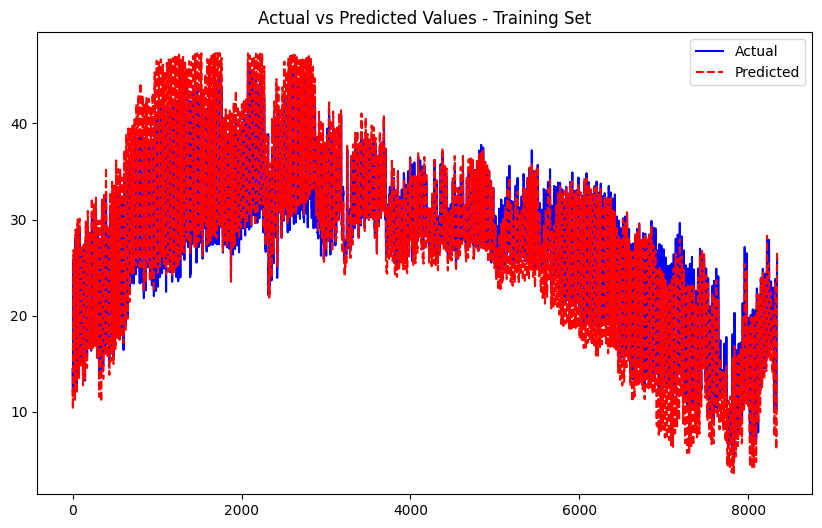

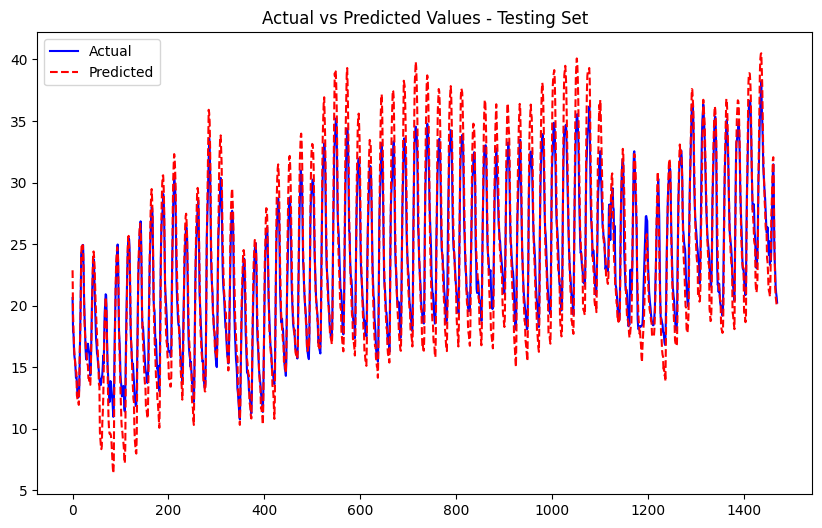

Processing node 25...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0405
Epoch [2/50], Train Loss: 0.0416
Epoch [3/50], Train Loss: 0.0411
Epoch [4/50], Train Loss: 0.0405
Epoch [5/50], Train Loss: 0.0403
Epoch [6/50], Train Loss: 0.0398
Epoch [7/50], Train Loss: 0.0406
Epoch [8/50], Train Loss: 0.0394
Epoch [9/50], Train Loss: 0.0389
Epoch [10/50], Train Loss: 0.0392
Epoch [11/50], Train Loss: 0.0393
Epoch [12/50], Train Loss: 0.0388
Epoch [13/50], Train Loss: 0.0391
Epoch [14/50], Train Loss: 0.0392
Epoch [15/50], Train Loss: 0.0400
Epoch [16/50], Train Loss: 0.0398
Epoch [17/50], Train Loss: 0.0392
Epoch [18/50], Train Loss: 0.0393
Epoch [19/50], Train Loss: 0.0391
Epoch [20/50], Train Loss: 0.0387
Epoch [21/50], Train Loss: 0.0389
Epoch [22/50], Train Loss: 0.0387
Epoch [23/50], Train Loss: 0.0385
Epoch [24/50], Train Loss: 0.0388
Epoch [25/50], Train Loss: 0.0387
Epoch [26/50], Train Loss: 0.0386
Epoch [27/50], Train Loss: 0.0389
Epoch [28/50], Train Loss: 0.0389
Epoch [29/50], Train Loss: 0.0386
Epoch [30/50], Train Lo

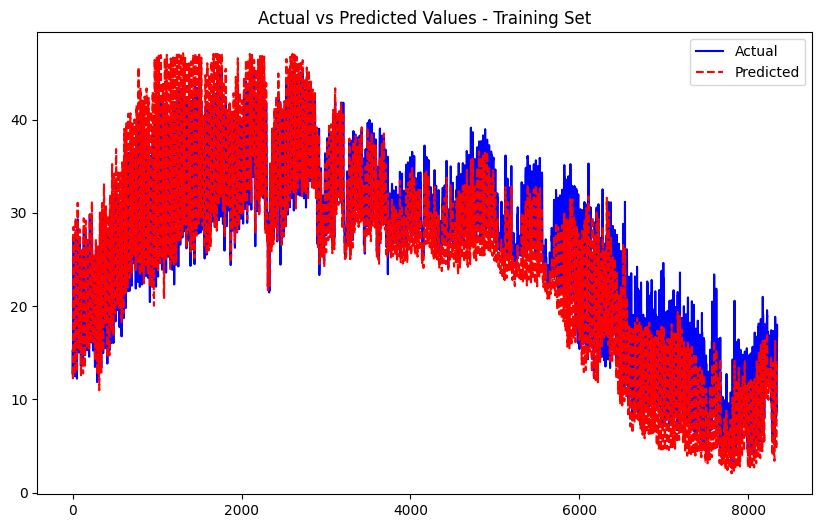

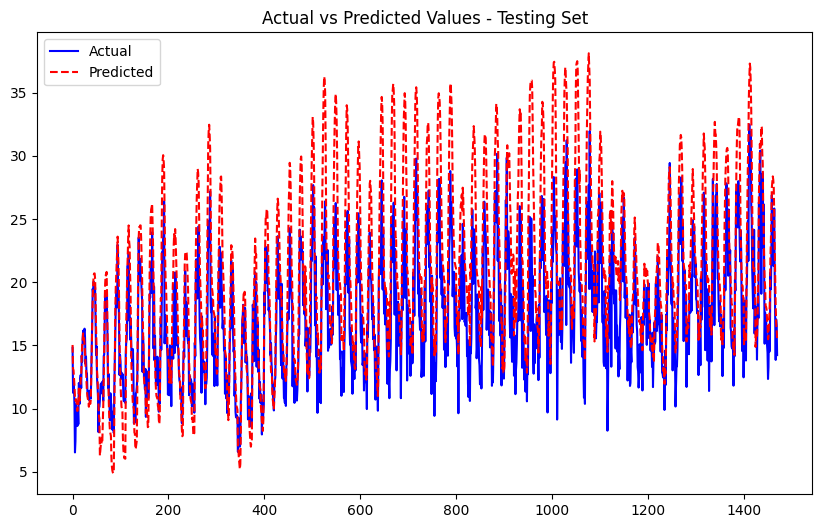

Processing node 26...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0571
Epoch [2/50], Train Loss: 0.0548
Epoch [3/50], Train Loss: 0.0540
Epoch [4/50], Train Loss: 0.0541
Epoch [5/50], Train Loss: 0.0526
Epoch [6/50], Train Loss: 0.0516
Epoch [7/50], Train Loss: 0.0510
Epoch [8/50], Train Loss: 0.0511
Epoch [9/50], Train Loss: 0.0507
Epoch [10/50], Train Loss: 0.0510
Epoch [11/50], Train Loss: 0.0499
Epoch [12/50], Train Loss: 0.0502
Epoch [13/50], Train Loss: 0.0502
Epoch [14/50], Train Loss: 0.0497
Epoch [15/50], Train Loss: 0.0501
Epoch [16/50], Train Loss: 0.0502
Epoch [17/50], Train Loss: 0.0497
Epoch [18/50], Train Loss: 0.0501
Epoch [19/50], Train Loss: 0.0505
Epoch [20/50], Train Loss: 0.0504
Epoch [21/50], Train Loss: 0.0503
Epoch [22/50], Train Loss: 0.0502
Epoch [23/50], Train Loss: 0.0497
Epoch [24/50], Train Loss: 0.0499
Epoch [25/50], Train Loss: 0.0496
Epoch [26/50], Train Loss: 0.0489
Epoch [27/50], Train Loss: 0.0491
Epoch [28/50], Train Loss: 0.0506
Epoch [29/50], Train Loss: 0.0487
Epoch [30/50], Train Lo

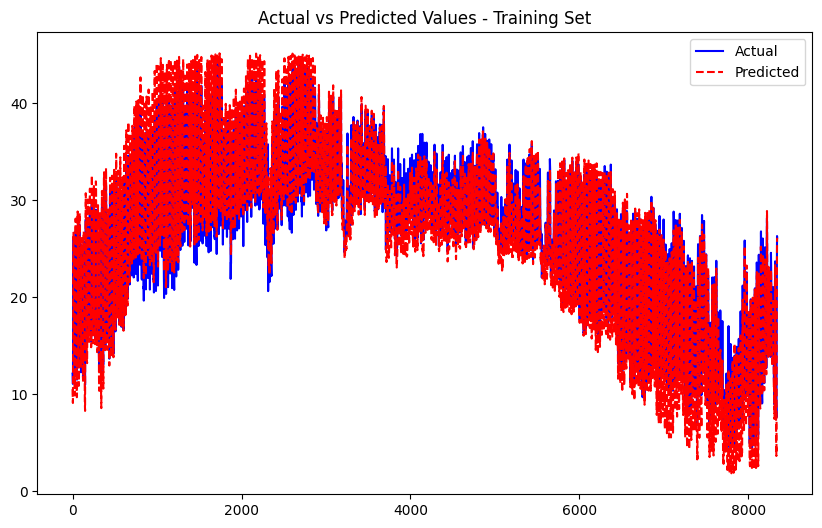

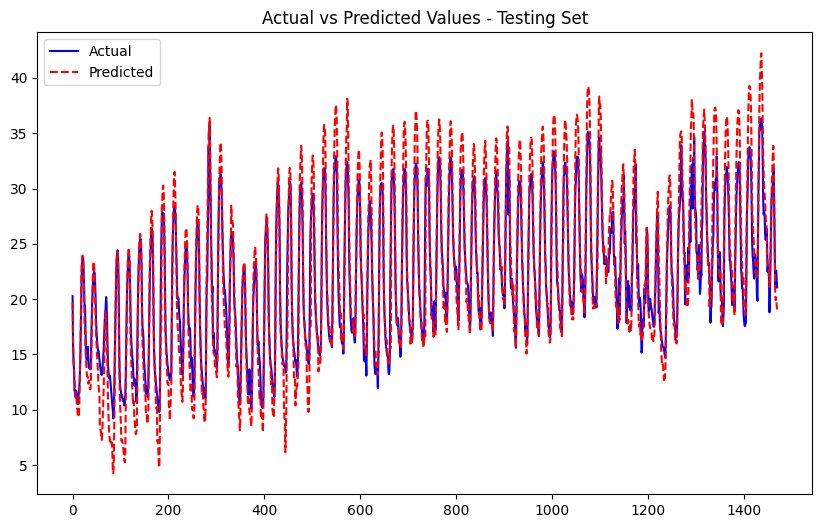

Processing node 27...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0552
Epoch [2/50], Train Loss: 0.0546
Epoch [3/50], Train Loss: 0.0529
Epoch [4/50], Train Loss: 0.0531
Epoch [5/50], Train Loss: 0.0526
Epoch [6/50], Train Loss: 0.0529
Epoch [7/50], Train Loss: 0.0532
Epoch [8/50], Train Loss: 0.0523
Epoch [9/50], Train Loss: 0.0528
Epoch [10/50], Train Loss: 0.0527
Epoch [11/50], Train Loss: 0.0528
Epoch [12/50], Train Loss: 0.0520
Epoch [13/50], Train Loss: 0.0525
Epoch [14/50], Train Loss: 0.0523
Epoch [15/50], Train Loss: 0.0522
Epoch [16/50], Train Loss: 0.0518
Epoch [17/50], Train Loss: 0.0516
Epoch [18/50], Train Loss: 0.0518
Epoch [19/50], Train Loss: 0.0515
Epoch [20/50], Train Loss: 0.0515
Epoch [21/50], Train Loss: 0.0516
Epoch [22/50], Train Loss: 0.0507
Epoch [23/50], Train Loss: 0.0513
Epoch [24/50], Train Loss: 0.0518
Epoch [25/50], Train Loss: 0.0524
Epoch [26/50], Train Loss: 0.0515
Epoch [27/50], Train Loss: 0.0517
Epoch [28/50], Train Loss: 0.0521
Epoch [29/50], Train Loss: 0.0515
Epoch [30/50], Train Lo

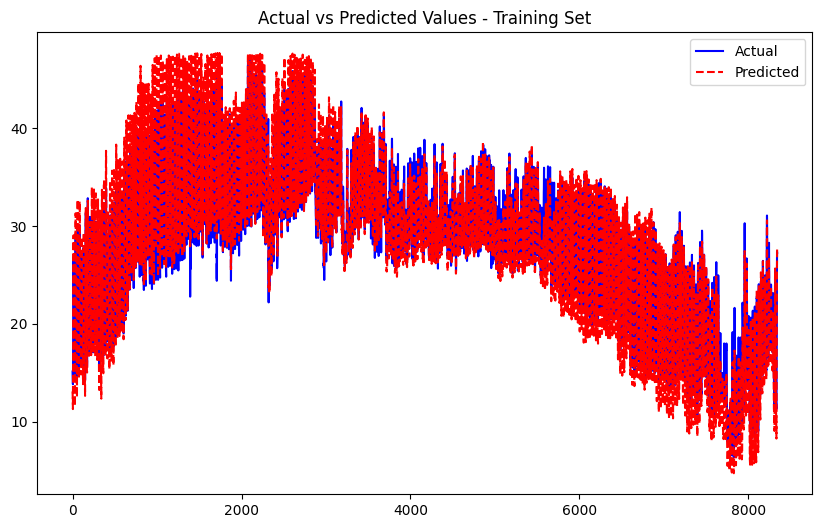

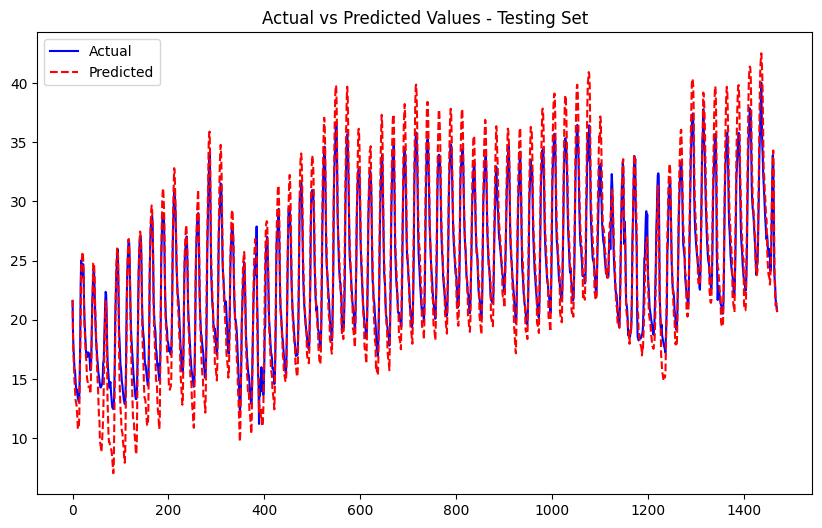

Processing node 28...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0519
Epoch [2/50], Train Loss: 0.0501
Epoch [3/50], Train Loss: 0.0493
Epoch [4/50], Train Loss: 0.0483
Epoch [5/50], Train Loss: 0.0491
Epoch [6/50], Train Loss: 0.0482
Epoch [7/50], Train Loss: 0.0481
Epoch [8/50], Train Loss: 0.0479
Epoch [9/50], Train Loss: 0.0481
Epoch [10/50], Train Loss: 0.0478
Epoch [11/50], Train Loss: 0.0480
Epoch [12/50], Train Loss: 0.0471
Epoch [13/50], Train Loss: 0.0471
Epoch [14/50], Train Loss: 0.0473
Epoch [15/50], Train Loss: 0.0473
Epoch [16/50], Train Loss: 0.0477
Epoch [17/50], Train Loss: 0.0469
Epoch [18/50], Train Loss: 0.0465
Epoch [19/50], Train Loss: 0.0461
Epoch [20/50], Train Loss: 0.0475
Epoch [21/50], Train Loss: 0.0462
Epoch [22/50], Train Loss: 0.0465
Epoch [23/50], Train Loss: 0.0474
Epoch [24/50], Train Loss: 0.0461
Epoch [25/50], Train Loss: 0.0466
Epoch [26/50], Train Loss: 0.0462
Epoch [27/50], Train Loss: 0.0463
Epoch [28/50], Train Loss: 0.0466
Epoch [29/50], Train Loss: 0.0463
Epoch [30/50], Train Lo

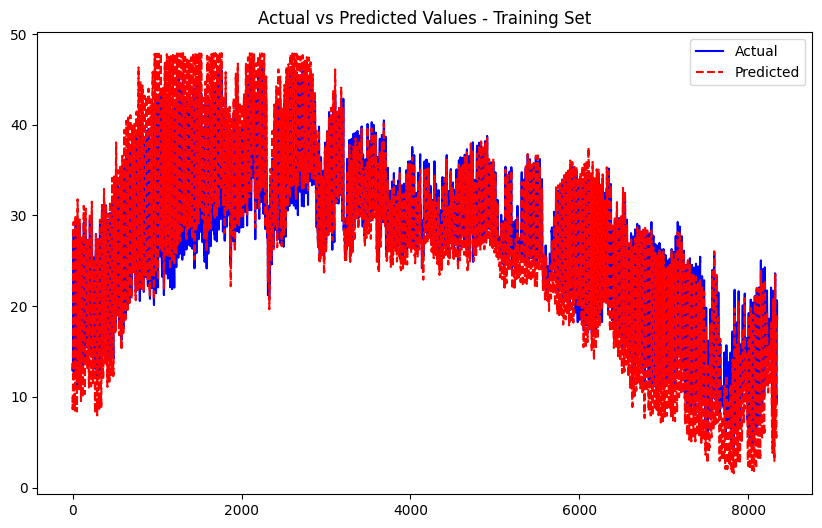

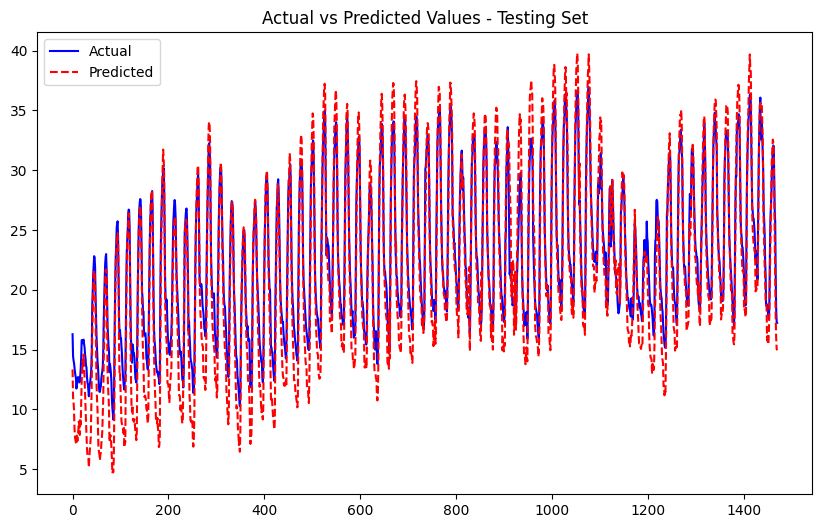

Processing node 29...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0523
Epoch [2/50], Train Loss: 0.0508
Epoch [3/50], Train Loss: 0.0497
Epoch [4/50], Train Loss: 0.0495
Epoch [5/50], Train Loss: 0.0497
Epoch [6/50], Train Loss: 0.0496
Epoch [7/50], Train Loss: 0.0500
Epoch [8/50], Train Loss: 0.0499
Epoch [9/50], Train Loss: 0.0496
Epoch [10/50], Train Loss: 0.0490
Epoch [11/50], Train Loss: 0.0488
Epoch [12/50], Train Loss: 0.0490
Epoch [13/50], Train Loss: 0.0491
Epoch [14/50], Train Loss: 0.0488
Epoch [15/50], Train Loss: 0.0500
Epoch [16/50], Train Loss: 0.0509
Epoch [17/50], Train Loss: 0.0498
Epoch [18/50], Train Loss: 0.0505
Epoch [19/50], Train Loss: 0.0493
Epoch [20/50], Train Loss: 0.0488
Epoch [21/50], Train Loss: 0.0491
Epoch [22/50], Train Loss: 0.0493
Epoch [23/50], Train Loss: 0.0497
Epoch [24/50], Train Loss: 0.0485
Epoch [25/50], Train Loss: 0.0494
Epoch [26/50], Train Loss: 0.0491
Epoch [27/50], Train Loss: 0.0490
Epoch [28/50], Train Loss: 0.0497
Epoch [29/50], Train Loss: 0.0494
Epoch [30/50], Train Lo

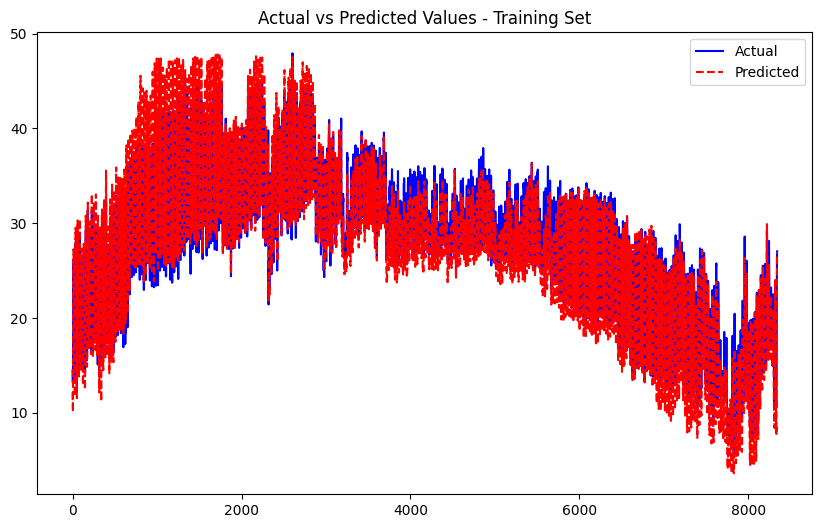

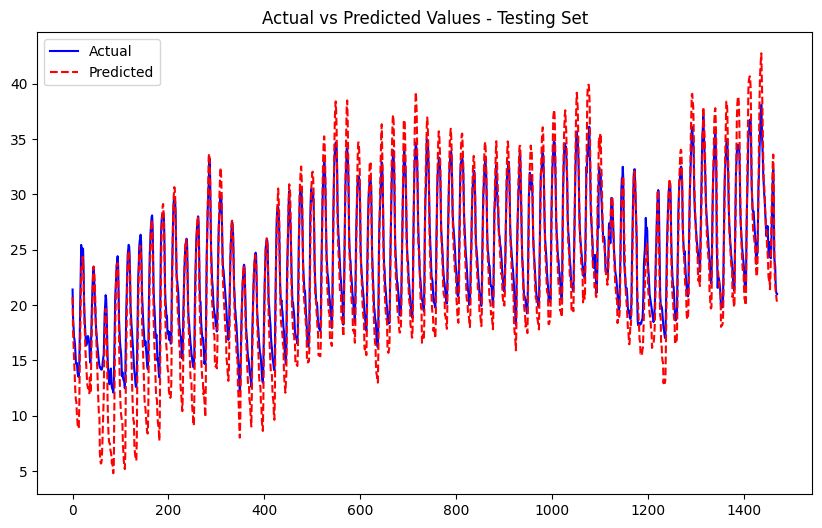

Processing node 30...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0708
Epoch [2/50], Train Loss: 0.0687
Epoch [3/50], Train Loss: 0.0662
Epoch [4/50], Train Loss: 0.0657
Epoch [5/50], Train Loss: 0.0653
Epoch [6/50], Train Loss: 0.0664
Epoch [7/50], Train Loss: 0.0639
Epoch [8/50], Train Loss: 0.0646
Epoch [9/50], Train Loss: 0.0642
Epoch [10/50], Train Loss: 0.0648
Epoch [11/50], Train Loss: 0.0643
Epoch [12/50], Train Loss: 0.0633
Epoch [13/50], Train Loss: 0.0634
Epoch [14/50], Train Loss: 0.0630
Epoch [15/50], Train Loss: 0.0633
Epoch [16/50], Train Loss: 0.0625
Epoch [17/50], Train Loss: 0.0630
Epoch [18/50], Train Loss: 0.0638
Epoch [19/50], Train Loss: 0.0630
Epoch [20/50], Train Loss: 0.0633
Epoch [21/50], Train Loss: 0.0631
Epoch [22/50], Train Loss: 0.0626
Epoch [23/50], Train Loss: 0.0633
Epoch [24/50], Train Loss: 0.0622
Epoch [25/50], Train Loss: 0.0625
Epoch [26/50], Train Loss: 0.0648
Epoch [27/50], Train Loss: 0.0653
Epoch [28/50], Train Loss: 0.0642
Epoch [29/50], Train Loss: 0.0623
Epoch [30/50], Train Lo

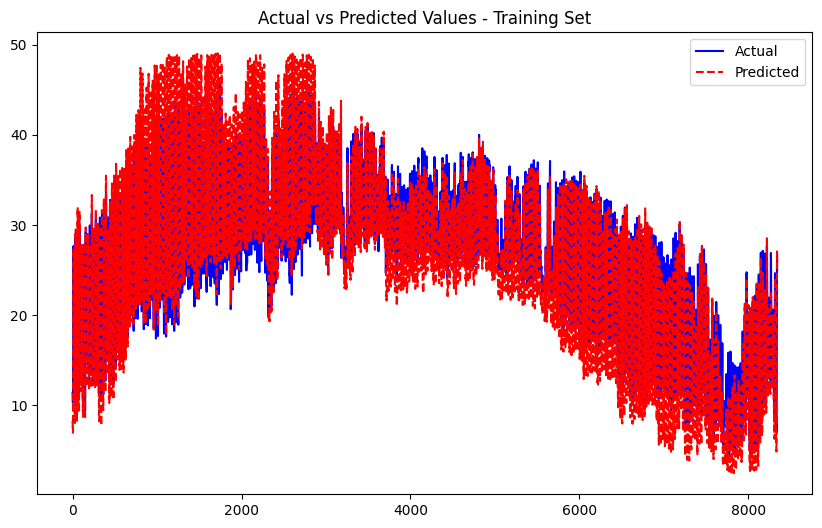

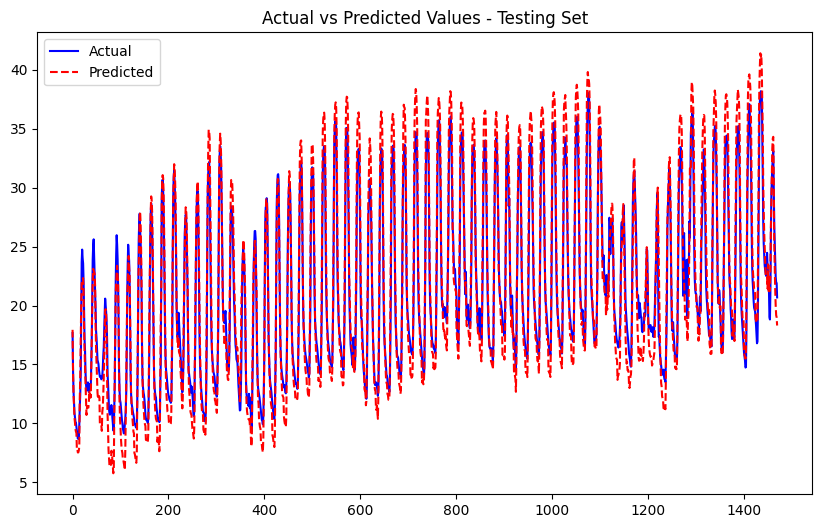

Processing node 31...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0592
Epoch [2/50], Train Loss: 0.0585
Epoch [3/50], Train Loss: 0.0577
Epoch [4/50], Train Loss: 0.0577
Epoch [5/50], Train Loss: 0.0566
Epoch [6/50], Train Loss: 0.0561
Epoch [7/50], Train Loss: 0.0568
Epoch [8/50], Train Loss: 0.0565
Epoch [9/50], Train Loss: 0.0565
Epoch [10/50], Train Loss: 0.0560
Epoch [11/50], Train Loss: 0.0554
Epoch [12/50], Train Loss: 0.0563
Epoch [13/50], Train Loss: 0.0563
Epoch [14/50], Train Loss: 0.0562
Epoch [15/50], Train Loss: 0.0561
Epoch [16/50], Train Loss: 0.0562
Epoch [17/50], Train Loss: 0.0565
Epoch [18/50], Train Loss: 0.0566
Epoch [19/50], Train Loss: 0.0563
Epoch [20/50], Train Loss: 0.0558
Epoch [21/50], Train Loss: 0.0552
Epoch [22/50], Train Loss: 0.0556
Epoch [23/50], Train Loss: 0.0548
Epoch [24/50], Train Loss: 0.0561
Epoch [25/50], Train Loss: 0.0557
Epoch [26/50], Train Loss: 0.0551
Epoch [27/50], Train Loss: 0.0557
Epoch [28/50], Train Loss: 0.0565
Epoch [29/50], Train Loss: 0.0562
Epoch [30/50], Train Lo

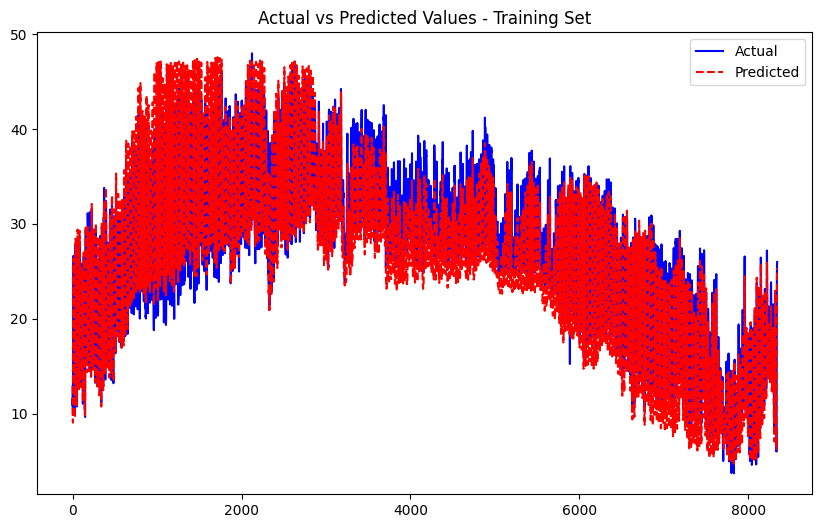

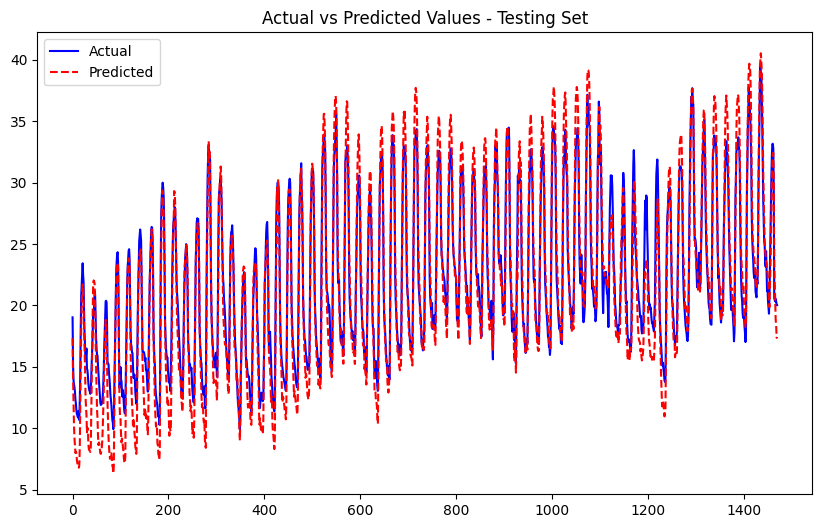

Processing node 32...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0529
Epoch [2/50], Train Loss: 0.0513
Epoch [3/50], Train Loss: 0.0520
Epoch [4/50], Train Loss: 0.0516
Epoch [5/50], Train Loss: 0.0504
Epoch [6/50], Train Loss: 0.0502
Epoch [7/50], Train Loss: 0.0501
Epoch [8/50], Train Loss: 0.0500
Epoch [9/50], Train Loss: 0.0497
Epoch [10/50], Train Loss: 0.0486
Epoch [11/50], Train Loss: 0.0495
Epoch [12/50], Train Loss: 0.0487
Epoch [13/50], Train Loss: 0.0491
Epoch [14/50], Train Loss: 0.0494
Epoch [15/50], Train Loss: 0.0496
Epoch [16/50], Train Loss: 0.0495
Epoch [17/50], Train Loss: 0.0483
Epoch [18/50], Train Loss: 0.0488
Epoch [19/50], Train Loss: 0.0487
Epoch [20/50], Train Loss: 0.0484
Epoch [21/50], Train Loss: 0.0487
Epoch [22/50], Train Loss: 0.0495
Epoch [23/50], Train Loss: 0.0493
Epoch [24/50], Train Loss: 0.0491
Epoch [25/50], Train Loss: 0.0490
Epoch [26/50], Train Loss: 0.0488
Epoch [27/50], Train Loss: 0.0487
Epoch [28/50], Train Loss: 0.0488
Epoch [29/50], Train Loss: 0.0485
Epoch [30/50], Train Lo

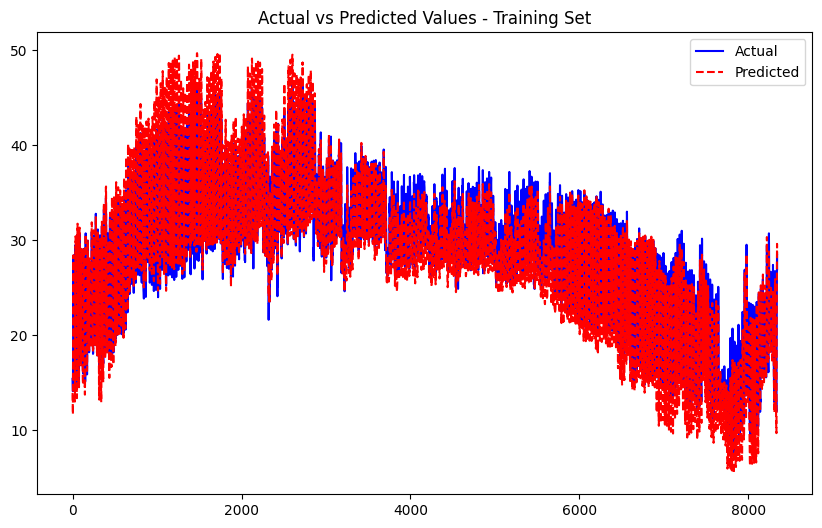

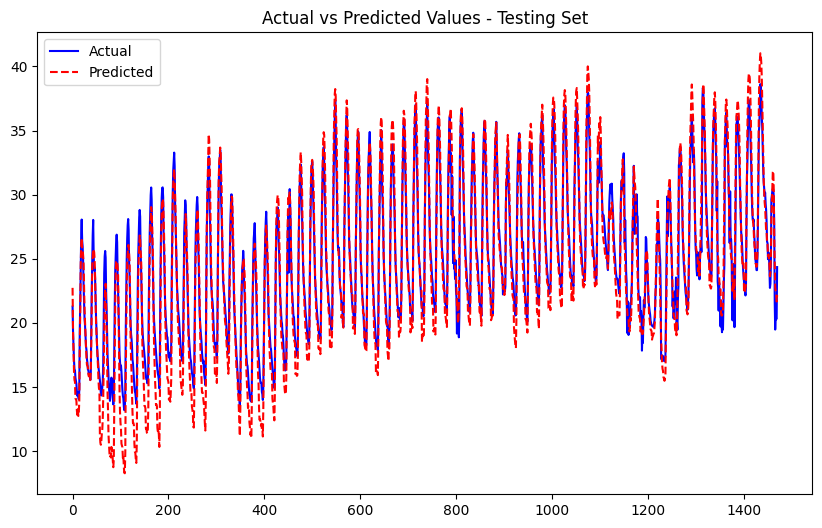

Processing node 33...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0612
Epoch [2/50], Train Loss: 0.0570
Epoch [3/50], Train Loss: 0.0564
Epoch [4/50], Train Loss: 0.0556
Epoch [5/50], Train Loss: 0.0553
Epoch [6/50], Train Loss: 0.0556
Epoch [7/50], Train Loss: 0.0551
Epoch [8/50], Train Loss: 0.0554
Epoch [9/50], Train Loss: 0.0548
Epoch [10/50], Train Loss: 0.0551
Epoch [11/50], Train Loss: 0.0543
Epoch [12/50], Train Loss: 0.0543
Epoch [13/50], Train Loss: 0.0538
Epoch [14/50], Train Loss: 0.0538
Epoch [15/50], Train Loss: 0.0538
Epoch [16/50], Train Loss: 0.0543
Epoch [17/50], Train Loss: 0.0535
Epoch [18/50], Train Loss: 0.0544
Epoch [19/50], Train Loss: 0.0536
Epoch [20/50], Train Loss: 0.0539
Epoch [21/50], Train Loss: 0.0539
Epoch [22/50], Train Loss: 0.0538
Epoch [23/50], Train Loss: 0.0542
Epoch [24/50], Train Loss: 0.0537
Epoch [25/50], Train Loss: 0.0532
Epoch [26/50], Train Loss: 0.0537
Epoch [27/50], Train Loss: 0.0530
Epoch [28/50], Train Loss: 0.0537
Epoch [29/50], Train Loss: 0.0530
Epoch [30/50], Train Lo

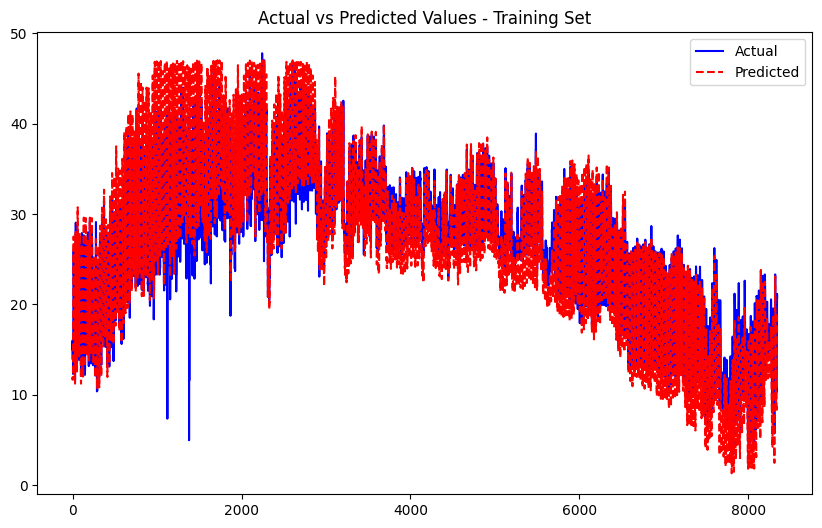

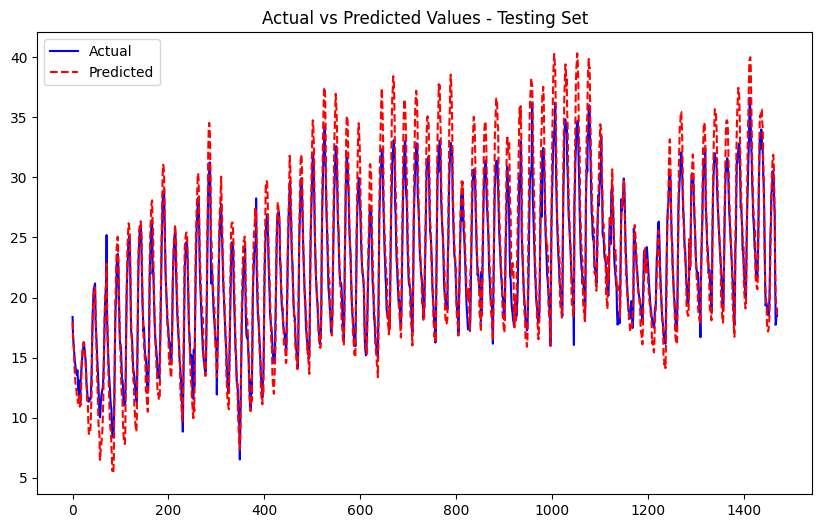

Processing node 34...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0521
Epoch [2/50], Train Loss: 0.0498
Epoch [3/50], Train Loss: 0.0496
Epoch [4/50], Train Loss: 0.0485
Epoch [5/50], Train Loss: 0.0485
Epoch [6/50], Train Loss: 0.0487
Epoch [7/50], Train Loss: 0.0484
Epoch [8/50], Train Loss: 0.0482
Epoch [9/50], Train Loss: 0.0475
Epoch [10/50], Train Loss: 0.0482
Epoch [11/50], Train Loss: 0.0479
Epoch [12/50], Train Loss: 0.0472
Epoch [13/50], Train Loss: 0.0490
Epoch [14/50], Train Loss: 0.0474
Epoch [15/50], Train Loss: 0.0477
Epoch [16/50], Train Loss: 0.0479
Epoch [17/50], Train Loss: 0.0481
Epoch [18/50], Train Loss: 0.0477
Epoch [19/50], Train Loss: 0.0475
Epoch [20/50], Train Loss: 0.0479
Epoch [21/50], Train Loss: 0.0475
Epoch [22/50], Train Loss: 0.0469
Epoch [23/50], Train Loss: 0.0479
Epoch [24/50], Train Loss: 0.0474
Epoch [25/50], Train Loss: 0.0471
Epoch [26/50], Train Loss: 0.0468
Epoch [27/50], Train Loss: 0.0465
Epoch [28/50], Train Loss: 0.0471
Epoch [29/50], Train Loss: 0.0482
Epoch [30/50], Train Lo

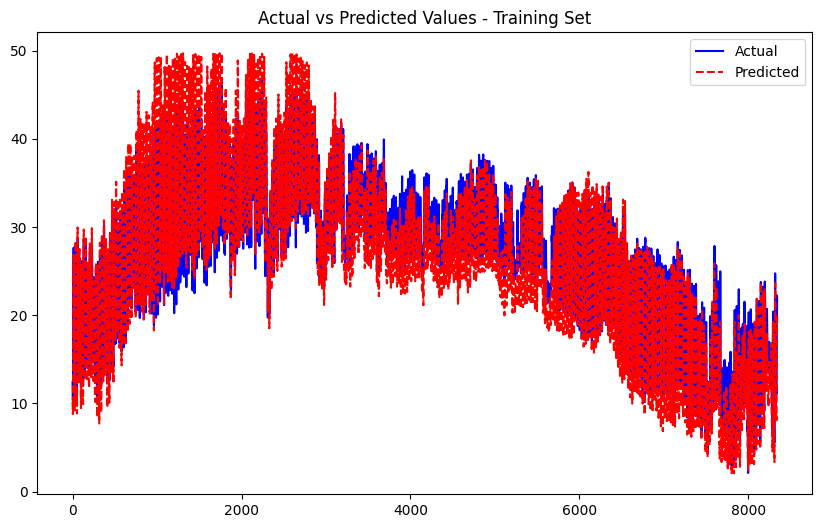

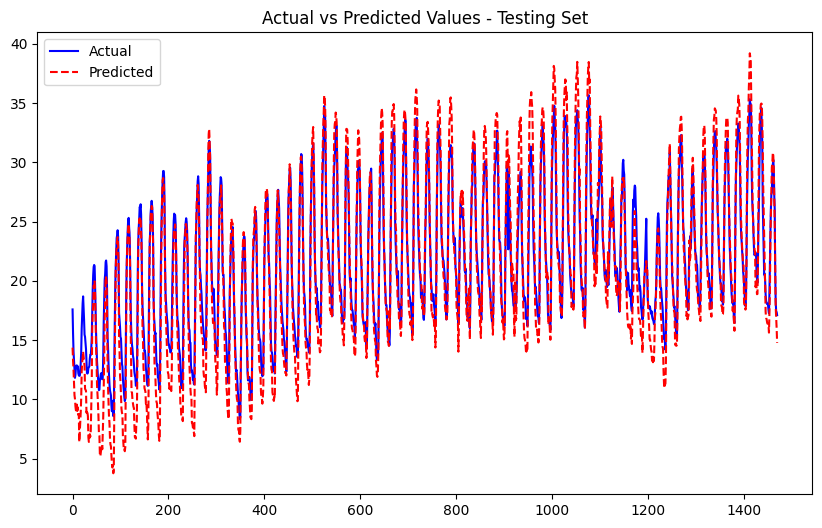

Processing node 35...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0510
Epoch [2/50], Train Loss: 0.0505
Epoch [3/50], Train Loss: 0.0499
Epoch [4/50], Train Loss: 0.0496
Epoch [5/50], Train Loss: 0.0500
Epoch [6/50], Train Loss: 0.0494
Epoch [7/50], Train Loss: 0.0492
Epoch [8/50], Train Loss: 0.0491
Epoch [9/50], Train Loss: 0.0491
Epoch [10/50], Train Loss: 0.0485
Epoch [11/50], Train Loss: 0.0489
Epoch [12/50], Train Loss: 0.0497
Epoch [13/50], Train Loss: 0.0493
Epoch [14/50], Train Loss: 0.0488
Epoch [15/50], Train Loss: 0.0482
Epoch [16/50], Train Loss: 0.0486
Epoch [17/50], Train Loss: 0.0488
Epoch [18/50], Train Loss: 0.0492
Epoch [19/50], Train Loss: 0.0484
Epoch [20/50], Train Loss: 0.0495
Epoch [21/50], Train Loss: 0.0486
Epoch [22/50], Train Loss: 0.0485
Epoch [23/50], Train Loss: 0.0481
Epoch [24/50], Train Loss: 0.0483
Epoch [25/50], Train Loss: 0.0487
Epoch [26/50], Train Loss: 0.0485
Epoch [27/50], Train Loss: 0.0482
Epoch [28/50], Train Loss: 0.0493
Epoch [29/50], Train Loss: 0.0486
Epoch [30/50], Train Lo

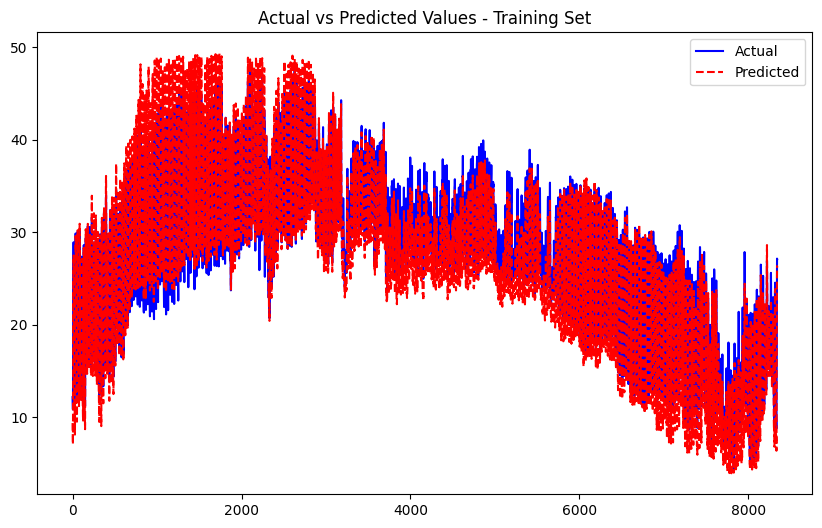

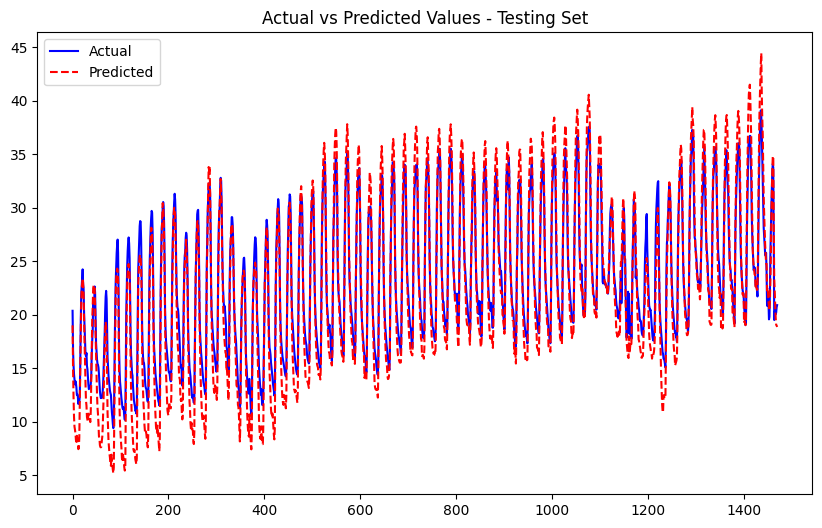

Processing node 36...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0545
Epoch [2/50], Train Loss: 0.0558
Epoch [3/50], Train Loss: 0.0549
Epoch [4/50], Train Loss: 0.0541
Epoch [5/50], Train Loss: 0.0531
Epoch [6/50], Train Loss: 0.0525
Epoch [7/50], Train Loss: 0.0524
Epoch [8/50], Train Loss: 0.0525
Epoch [9/50], Train Loss: 0.0520
Epoch [10/50], Train Loss: 0.0522
Epoch [11/50], Train Loss: 0.0517
Epoch [12/50], Train Loss: 0.0523
Epoch [13/50], Train Loss: 0.0528
Epoch [14/50], Train Loss: 0.0520
Epoch [15/50], Train Loss: 0.0523
Epoch [16/50], Train Loss: 0.0513
Epoch [17/50], Train Loss: 0.0516
Epoch [18/50], Train Loss: 0.0519
Epoch [19/50], Train Loss: 0.0516
Epoch [20/50], Train Loss: 0.0513
Epoch [21/50], Train Loss: 0.0512
Epoch [22/50], Train Loss: 0.0509
Epoch [23/50], Train Loss: 0.0509
Epoch [24/50], Train Loss: 0.0517
Epoch [25/50], Train Loss: 0.0505
Epoch [26/50], Train Loss: 0.0513
Epoch [27/50], Train Loss: 0.0510
Epoch [28/50], Train Loss: 0.0512
Epoch [29/50], Train Loss: 0.0512
Epoch [30/50], Train Lo

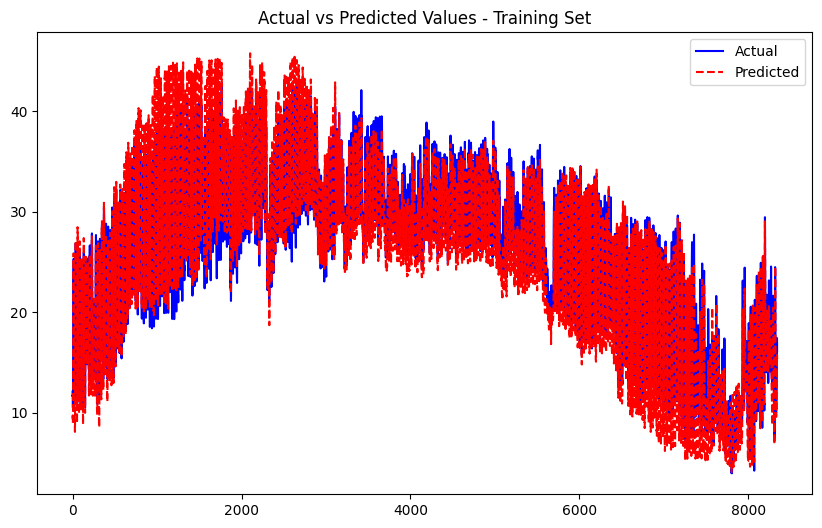

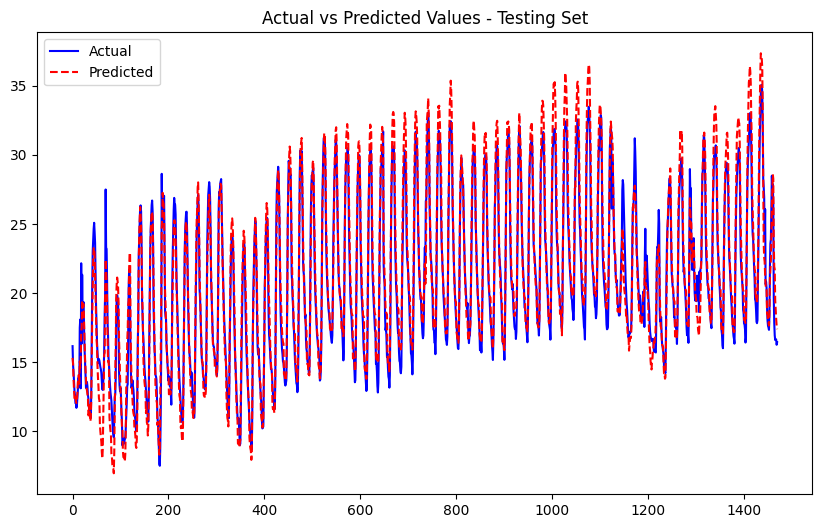

Processing node 37...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0567
Epoch [2/50], Train Loss: 0.0564
Epoch [3/50], Train Loss: 0.0557
Epoch [4/50], Train Loss: 0.0555
Epoch [5/50], Train Loss: 0.0556
Epoch [6/50], Train Loss: 0.0547
Epoch [7/50], Train Loss: 0.0548
Epoch [8/50], Train Loss: 0.0544
Epoch [9/50], Train Loss: 0.0548
Epoch [10/50], Train Loss: 0.0552
Epoch [11/50], Train Loss: 0.0537
Epoch [12/50], Train Loss: 0.0547
Epoch [13/50], Train Loss: 0.0546
Epoch [14/50], Train Loss: 0.0548
Epoch [15/50], Train Loss: 0.0543
Epoch [16/50], Train Loss: 0.0539
Epoch [17/50], Train Loss: 0.0542
Epoch [18/50], Train Loss: 0.0547
Epoch [19/50], Train Loss: 0.0542
Epoch [20/50], Train Loss: 0.0541
Epoch [21/50], Train Loss: 0.0545
Epoch [22/50], Train Loss: 0.0539
Epoch [23/50], Train Loss: 0.0548
Epoch [24/50], Train Loss: 0.0543
Epoch [25/50], Train Loss: 0.0540
Epoch [26/50], Train Loss: 0.0545
Epoch [27/50], Train Loss: 0.0535
Epoch [28/50], Train Loss: 0.0543
Epoch [29/50], Train Loss: 0.0549
Epoch [30/50], Train Lo

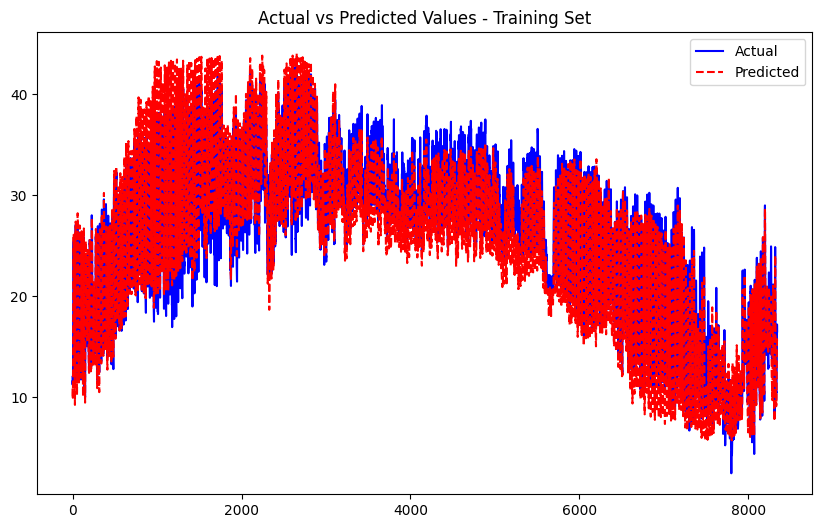

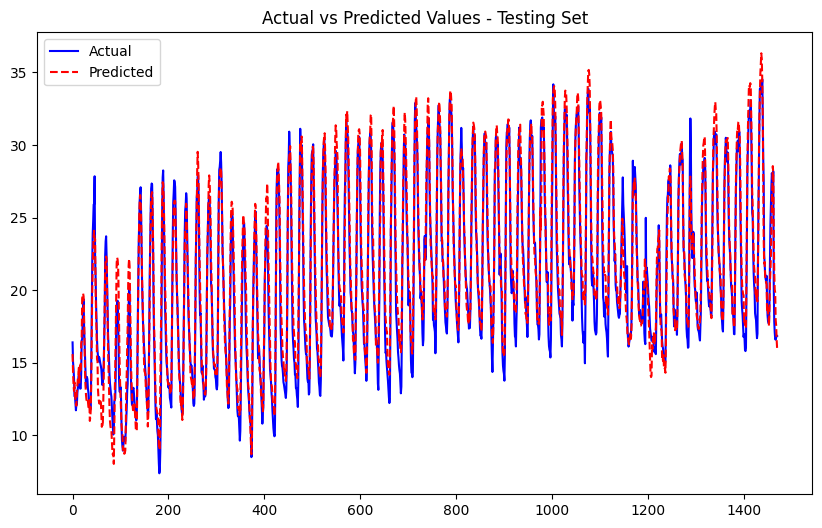

Processing node 38...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0508
Epoch [2/50], Train Loss: 0.0504
Epoch [3/50], Train Loss: 0.0493
Epoch [4/50], Train Loss: 0.0492
Epoch [5/50], Train Loss: 0.0493
Epoch [6/50], Train Loss: 0.0490
Epoch [7/50], Train Loss: 0.0492
Epoch [8/50], Train Loss: 0.0490
Epoch [9/50], Train Loss: 0.0490
Epoch [10/50], Train Loss: 0.0487
Epoch [11/50], Train Loss: 0.0478
Epoch [12/50], Train Loss: 0.0475
Epoch [13/50], Train Loss: 0.0477
Epoch [14/50], Train Loss: 0.0484
Epoch [15/50], Train Loss: 0.0494
Epoch [16/50], Train Loss: 0.0494
Epoch [17/50], Train Loss: 0.0478
Epoch [18/50], Train Loss: 0.0482
Epoch [19/50], Train Loss: 0.0482
Epoch [20/50], Train Loss: 0.0483
Epoch [21/50], Train Loss: 0.0475
Epoch [22/50], Train Loss: 0.0474
Epoch [23/50], Train Loss: 0.0472
Epoch [24/50], Train Loss: 0.0475
Epoch [25/50], Train Loss: 0.0476
Epoch [26/50], Train Loss: 0.0477
Epoch [27/50], Train Loss: 0.0476
Epoch [28/50], Train Loss: 0.0479
Epoch [29/50], Train Loss: 0.0466
Epoch [30/50], Train Lo

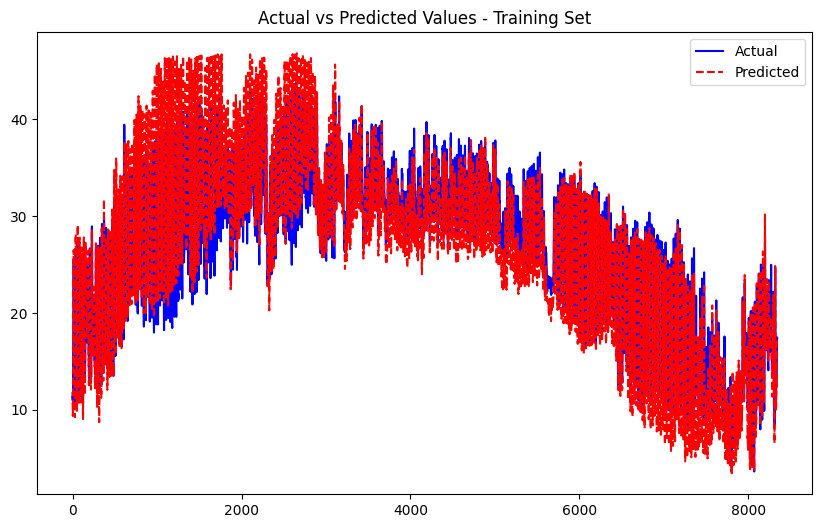

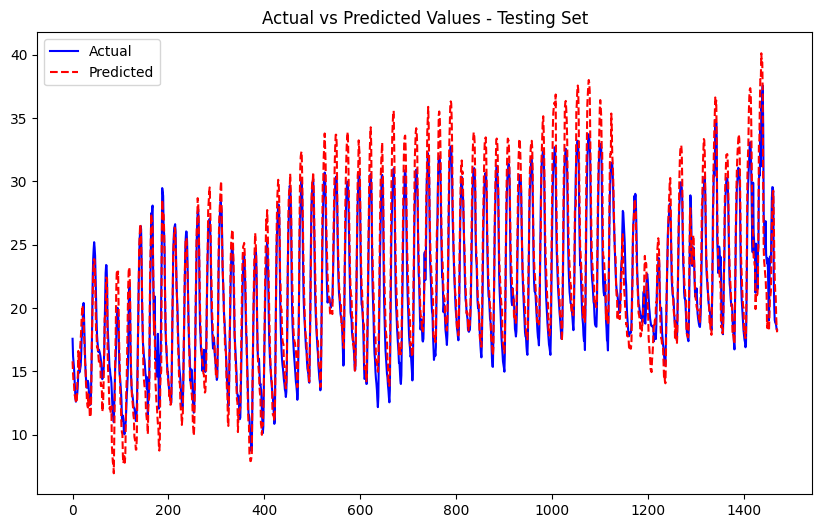

Processing node 39...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0858
Epoch [2/50], Train Loss: 0.0841
Epoch [3/50], Train Loss: 0.0831
Epoch [4/50], Train Loss: 0.0830
Epoch [5/50], Train Loss: 0.0829
Epoch [6/50], Train Loss: 0.0815
Epoch [7/50], Train Loss: 0.0807
Epoch [8/50], Train Loss: 0.0806
Epoch [9/50], Train Loss: 0.0809
Epoch [10/50], Train Loss: 0.0810
Epoch [11/50], Train Loss: 0.0820
Epoch [12/50], Train Loss: 0.0820
Epoch [13/50], Train Loss: 0.0805
Epoch [14/50], Train Loss: 0.0797
Epoch [15/50], Train Loss: 0.0790
Epoch [16/50], Train Loss: 0.0786
Epoch [17/50], Train Loss: 0.0786
Epoch [18/50], Train Loss: 0.0801
Epoch [19/50], Train Loss: 0.0796
Epoch [20/50], Train Loss: 0.0791
Epoch [21/50], Train Loss: 0.0792
Epoch [22/50], Train Loss: 0.0797
Epoch [23/50], Train Loss: 0.0781
Epoch [24/50], Train Loss: 0.0788
Epoch [25/50], Train Loss: 0.0783
Epoch [26/50], Train Loss: 0.0782
Epoch [27/50], Train Loss: 0.0790
Epoch [28/50], Train Loss: 0.0785
Epoch [29/50], Train Loss: 0.0786
Epoch [30/50], Train Lo

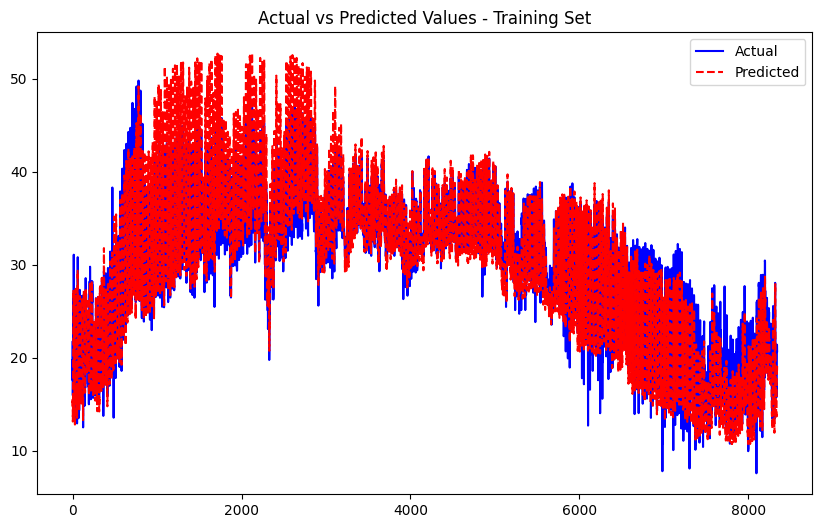

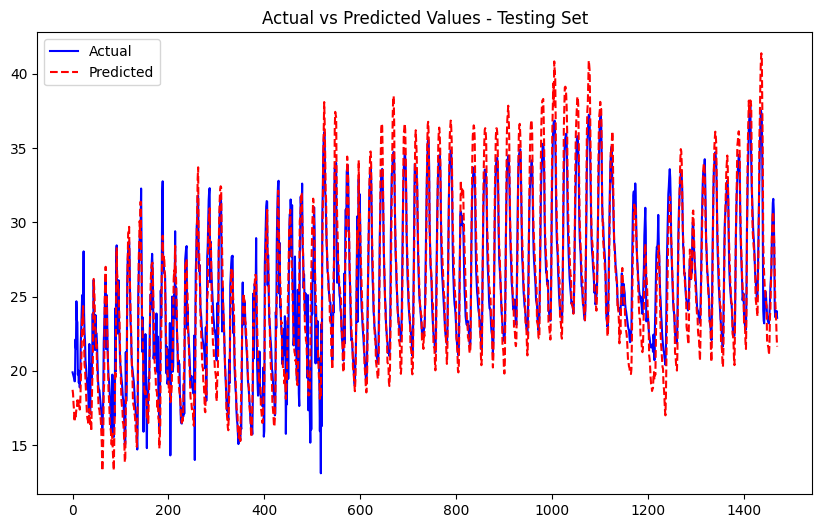

Processing node 40...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2124
Epoch [2/50], Train Loss: 0.1929
Epoch [3/50], Train Loss: 0.1860
Epoch [4/50], Train Loss: 0.1885
Epoch [5/50], Train Loss: 0.1811
Epoch [6/50], Train Loss: 0.1759
Epoch [7/50], Train Loss: 0.1680
Epoch [8/50], Train Loss: 0.1623
Epoch [9/50], Train Loss: 0.1671
Epoch [10/50], Train Loss: 0.1569
Epoch [11/50], Train Loss: 0.1488
Epoch [12/50], Train Loss: 0.1471
Epoch [13/50], Train Loss: 0.1363
Epoch [14/50], Train Loss: 0.1448
Epoch [15/50], Train Loss: 0.1388
Epoch [16/50], Train Loss: 0.1407
Epoch [17/50], Train Loss: 0.1332
Epoch [18/50], Train Loss: 0.1281
Epoch [19/50], Train Loss: 0.1304
Epoch [20/50], Train Loss: 0.1387
Epoch [21/50], Train Loss: 0.1273
Epoch [22/50], Train Loss: 0.1297
Epoch [23/50], Train Loss: 0.1356
Epoch [24/50], Train Loss: 0.1257
Epoch [25/50], Train Loss: 0.1284
Epoch [26/50], Train Loss: 0.1242
Epoch [27/50], Train Loss: 0.1310
Epoch [28/50], Train Loss: 0.1215
Epoch [29/50], Train Loss: 0.1260
Epoch [30/50], Train Lo

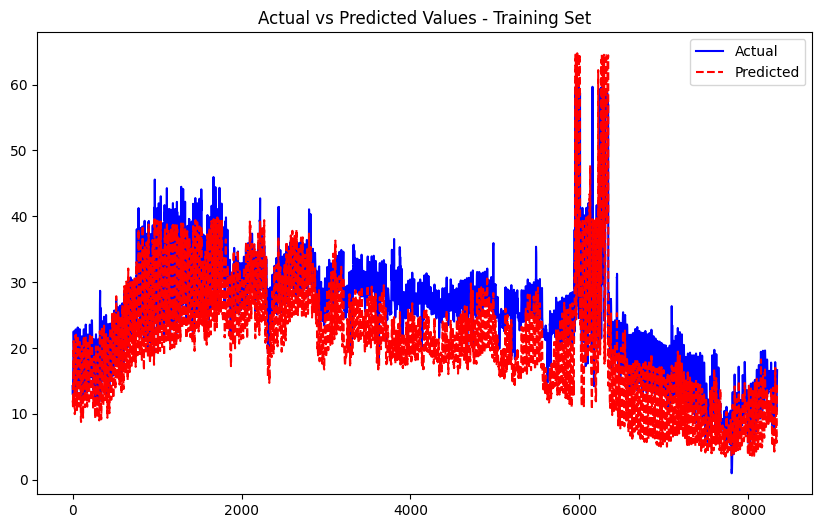

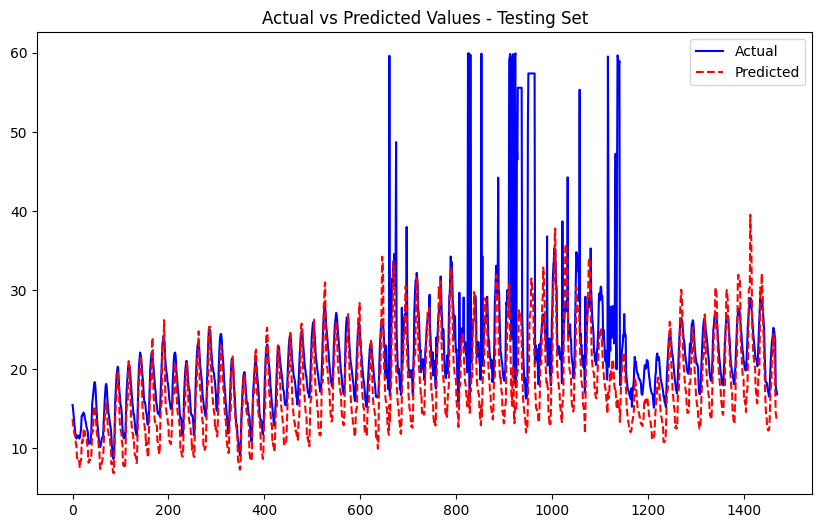

Processing node 41...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0917
Epoch [2/50], Train Loss: 0.0842
Epoch [3/50], Train Loss: 0.0805
Epoch [4/50], Train Loss: 0.0781
Epoch [5/50], Train Loss: 0.0755
Epoch [6/50], Train Loss: 0.0733
Epoch [7/50], Train Loss: 0.0721
Epoch [8/50], Train Loss: 0.0712
Epoch [9/50], Train Loss: 0.0702
Epoch [10/50], Train Loss: 0.0685
Epoch [11/50], Train Loss: 0.0696
Epoch [12/50], Train Loss: 0.0690
Epoch [13/50], Train Loss: 0.0673
Epoch [14/50], Train Loss: 0.0674
Epoch [15/50], Train Loss: 0.0674
Epoch [16/50], Train Loss: 0.0673
Epoch [17/50], Train Loss: 0.0654
Epoch [18/50], Train Loss: 0.0676
Epoch [19/50], Train Loss: 0.0676
Epoch [20/50], Train Loss: 0.0662
Epoch [21/50], Train Loss: 0.0656
Epoch [22/50], Train Loss: 0.0661
Epoch [23/50], Train Loss: 0.0668
Epoch [24/50], Train Loss: 0.0659
Epoch [25/50], Train Loss: 0.0660
Epoch [26/50], Train Loss: 0.0642
Epoch [27/50], Train Loss: 0.0651
Epoch [28/50], Train Loss: 0.0685
Epoch [29/50], Train Loss: 0.0661
Epoch [30/50], Train Lo

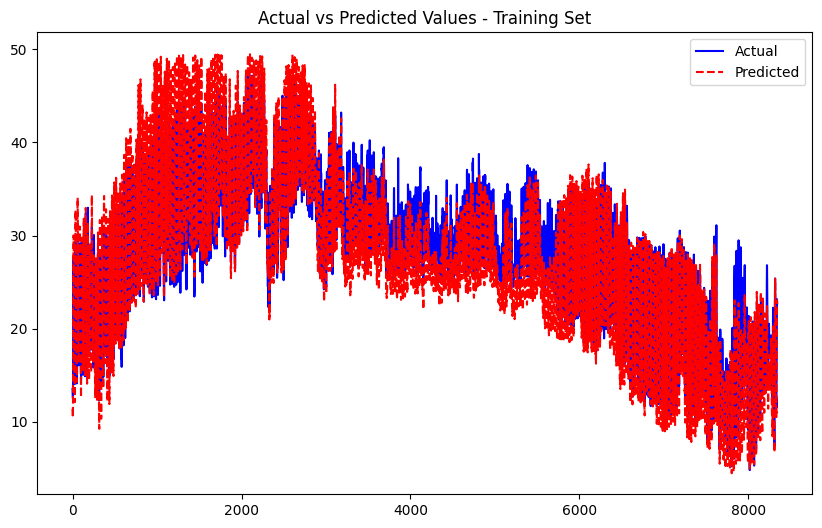

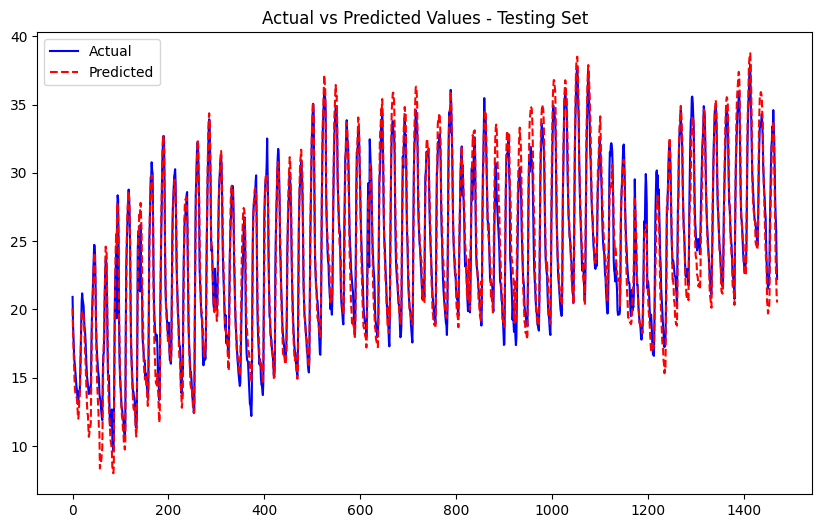

Train GNN and Transformer with Positional Encoding Imputed bs 3 sl 3.csv
CSV file 'Train GNN and Transformer with Positional Encoding Imputed bs 3 sl 3.csv' created successfully.
Test GNN and Transformer with Positional Encoding Imputed bs 3 sl 3.csv
CSV file 'Test GNN and Transformer with Positional Encoding Imputed bs 3 sl 3.csv' created successfully.


In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np
import torch.optim.lr_scheduler as lr_scheduler

# Define Positional Encoding class
class PositionalEncoding(nn.Module):
    def __init__(self, hidden_size, max_len=5000):
        super(PositionalEncoding, self).__init__()
        
        # Create a matrix of positional encodings
        pe = torch.zeros(max_len, hidden_size)
        position = torch.arange(0, max_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, hidden_size, 2).float() * (-np.log(10000.0) / hidden_size))
        
        # Apply sin and cos to even and odd indices respectively
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0).transpose(0, 1)
        
        # Register buffer to avoid training the positional encoding
        self.register_buffer('pe', pe)

    def forward(self, x):
        # Add positional encoding to the input embeddings
        x = x + self.pe[:x.size(0), :]
        return x

# Define the Transformer Model with Positional Encoding
class TransformerModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, num_heads=4, dropout_prob=0.2):
        super(TransformerModel, self).__init__()
        self.hidden_size = hidden_size
        
        # Define the embedding layer for input data
        self.embedding = nn.Linear(input_size, hidden_size)
        
        # Define the positional encoding layer
        self.positional_encoding = PositionalEncoding(hidden_size)
        
        # Define the Transformer Encoder Layer
        encoder_layer = nn.TransformerEncoderLayer(d_model=hidden_size, nhead=num_heads, dim_feedforward=hidden_size*4, dropout=dropout_prob)
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        
        # Fully connected layer (output layer)
        self.fc = nn.Linear(hidden_size, output_size)
        
        # Activation function
        self.elu = nn.ELU()

    def forward(self, x):
        # Input shape: (batch_size, sequence_length, input_size)
        x = self.embedding(x)  # Apply embedding layer
        x = x.permute(1, 0, 2)  # Reshape to (sequence_length, batch_size, hidden_size) for Transformer

        # Apply positional encoding
        x = self.positional_encoding(x)

        # Pass through Transformer encoder
        out = self.transformer_encoder(x)  # out shape: (sequence_length, batch_size, hidden_size)
        
        # Extract the last time step output and apply ELU activation
        out = self.elu(out[-1, :, :])  # Take the last time step (batch_size, hidden_size)
        
        # Pass the output through the fully connected layer
        out = self.fc(out)
        
        return out


def train_model(model, train_loader, criterion, optimizer, num_epochs):
    model.train()  # Set the model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        # Training phase
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            
            # Forward pass
            outputs = model(features)
            loss = criterion(outputs, targets)  # Compute the loss

            # Backward and optimize
            optimizer.zero_grad()  # Clear previous gradients
            loss.backward()  # Backpropagate the loss
            optimizer.step()  # Update weights

            running_loss += loss.item()   

        # Print training loss after each epoch
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {running_loss/len(train_loader):.4f}')
    
    # Switch back to evaluation mode
    model.eval()



def test_model(model, train_loader, test_loader, node_idx):
    model.eval()
    all_actuals = []
    all_predictions = []
    
    # For tracking actuals and predictions for train and test sets separately
    train_actuals = []
    train_predictions = []
    
    test_actuals = []
    test_predictions = []

    
    with torch.no_grad():
        # Predict on training data
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            train_actuals.append(targets.cpu().numpy())
            train_predictions.append(outputs.cpu().numpy())

        # Predict on testing data
        for features, targets in test_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            test_actuals.append(targets.cpu().numpy())
            test_predictions.append(outputs.cpu().numpy())
    
    # Concatenate all sets
    train_actuals = np.concatenate(train_actuals, axis=0)
    test_actuals = np.concatenate(test_actuals, axis=0)
    
    train_predictions = np.concatenate(train_predictions, axis=0)
    test_predictions = np.concatenate(test_predictions, axis=0)

    # Check shapes before proceeding
    print(f"Training actuals shape: {train_actuals.shape}, Predictions shape: {train_predictions.shape}")
    print(f"Testing actuals shape: {test_actuals.shape}, Predictions shape: {test_predictions.shape}")
    
    # Combine them for inverse scaling
    all_actuals = np.concatenate([train_actuals, test_actuals])
    all_predictions = np.concatenate([train_predictions, test_predictions])
    
    # Inverse scaling
    file_name = input_files[node_idx]
    
    if file_name in scalers:
        all_actuals = all_actuals.reshape(-1, 1)
        all_predictions = all_predictions.reshape(-1, 1)
        
        # Apply inverse scaling
        all_actuals_inverse = scalers[file_name].inverse_transform(all_actuals).flatten()
        all_predictions_inverse = scalers[file_name].inverse_transform(all_predictions).flatten()
    else:
        print(f"Scaler not found for {file_name}")
        return
    
    # Split them back into training and test sets
    train_size = len(train_actuals)
    test_size = len(test_actuals)
    
    train_actuals_inverse = all_actuals_inverse[:train_size]
    test_actuals_inverse = all_actuals_inverse[train_size:]
    
    train_predictions_inverse = all_predictions_inverse[:train_size]
    test_predictions_inverse = all_predictions_inverse[train_size:]

    # Verify split sizes
    print(f"Split Training actuals shape: {train_actuals_inverse.shape}, Predictions shape: {train_predictions_inverse.shape}")
    print(f"Split Testing actuals shape: {test_actuals_inverse.shape}, Predictions shape: {test_predictions_inverse.shape}")
    
    # Function to calculate and print metrics
    def calculate_metrics(actuals, predictions, set_name):
        mae = mean_absolute_error(actuals, predictions)
        mse = mean_squared_error(actuals, predictions)
        rmse = np.sqrt(mse)
        r2 = r2_score(actuals, predictions)
        corr_coeff = np.corrcoef(actuals.flatten(), predictions.flatten())[0, 1]
        
        # Print the metrics
        print(f"{set_name} Set Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {corr_coeff:.4f}")
        print(f"R-squared (R²): {r2:.4f}")
        print("\n" + "-"*40 + "\n")

        if set_name == 'Training':
            train_mae_list.append(mae)
            train_mse_list.append(mse)
            train_rmse_list.append(rmse)
            train_r2_list.append(r2)
            train_corr_list.append(corr_coeff)

        elif set_name == 'Testing':
            test_mae_list.append(mae)
            test_mse_list.append(mse)
            test_rmse_list.append(rmse)
            test_r2_list.append(r2)
            test_corr_list.append(corr_coeff)        
    
    # Calculate and print metrics for each set
    print(f"\nCalculating metrics for Node {node_idx+1} - {file_name}")
    calculate_metrics(train_actuals_inverse, train_predictions_inverse, 'Training')
    calculate_metrics(test_actuals_inverse, test_predictions_inverse, 'Testing')

    print(f"\n\nCalculating Average Metrics for Training:")
    print(f"Mean MAE: {np.mean(train_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(train_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(train_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(train_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(train_corr_list):.4f}")

    print(f"\n\nCalculating Average Metrics for Testing:")
    print(f"Mean MAE: {np.mean(test_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(test_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(test_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(test_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(test_corr_list):.4f}")
    
    # Function to plot actual vs predicted values
    def plot_results(actuals, predictions, set_name):
        plt.figure(figsize=(10, 6))
        plt.plot(actuals, label="Actual", color='blue')
        plt.plot(predictions, label="Predicted", color='red', linestyle='dashed')
        plt.title(f'Actual vs Predicted Values - {set_name} Set')
        plt.legend()
        plt.show()
    
    # Plot results for each set
    plot_results(train_actuals_inverse, train_predictions_inverse, 'Training')
    plot_results(test_actuals_inverse, test_predictions_inverse, 'Testing')


def create_dataloaders(features, targets, batch_size, sequence_length):
    # Convert DataFrame to NumPy arrays
    features_np = features.to_numpy()
    targets_np = targets.to_numpy()

    # Prepare sequences of data
    feature_sequences = []
    target_sequences = []

    # Create rolling windows of `sequence_length`
    for i in range(len(features_np) - sequence_length + 1):
        # Get sequence of features and corresponding target
        feature_sequences.append(features_np[i:i+sequence_length])
        target_sequences.append(targets_np[i+sequence_length-1])  # target is the last value of the sequence

    # Convert to NumPy arrays
    feature_sequences = np.array(feature_sequences)
    target_sequences = np.array(target_sequences)

    # Convert to PyTorch tensors
    features_tensor = torch.tensor(feature_sequences, dtype=torch.float32)
    targets_tensor = torch.tensor(target_sequences, dtype=torch.float32)

    # Create a dataset and dataloader
    dataset = torch.utils.data.TensorDataset(features_tensor, targets_tensor)
    return torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Initialize the Transformer model, criterion, and optimizer
input_size = train_features_list[0].shape[1]
hidden_size = 128
num_layers = 2
output_size = 1
num_heads = 2  # Number of attention heads in Transformer
num_epochs = 50
learning_rate = 0.0005
batch_size = 3
sequence_length = 3
print(f'Num Layers: {num_layers}, Num Heads: {num_heads}')

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = TransformerModel(input_size, hidden_size, num_layers, output_size, num_heads=num_heads).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

print(f"For Batch Size= {batch_size} and Sequence Length = {sequence_length}")
train_mae_list = []
train_mse_list = []
train_rmse_list = []
train_r2_list = []
train_corr_list = []

test_mae_list = []
test_mse_list = []
test_rmse_list = []
test_r2_list = []
test_corr_list = []

# Process for each node
for node_idx, (train_features, train_targets, test_features, test_targets) in enumerate(zip(train_features_list, train_target_list, test_features_list, test_target_list)):
    print(f"Processing node {node_idx+1}...")

    # Create dataloaders
    train_loader = create_dataloaders(train_features, train_targets, batch_size, sequence_length)
    test_loader = create_dataloaders(test_features, test_targets, batch_size, sequence_length)

    # Train the model
    train_model(model, train_loader, criterion, optimizer, num_epochs)

    # Test the model and output metrics/plot
    test_model(model, train_loader, test_loader, node_idx)

    # Define function to create DataFrame and save to CSV
def create_metrics_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")

# Create CSV for training set
file_name = "Train GNN and Transformer with Positional Encoding Imputed bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, train_mae_list, train_mse_list, train_rmse_list, train_r2_list, train_corr_list)

# Create CSV for test set
file_name = "Test GNN and Transformer with Positional Encoding Imputed bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, test_mae_list, test_mse_list, test_rmse_list, test_r2_list, test_corr_list)    
